In [1]:
from lmfit import *
from iqtools import *
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
def gaussian(x, amp, cen, wid):
    """1-d gaussian: gaussian(x, amp, cen, wid)"""
    return (amp / (np.sqrt(2*np.pi) * wid)) * np.exp(-(x-cen)**2 / (2*wid**2))

In [3]:
def read_and_cut_in_frecuency(filename, lframes, time, skip, xcen, xspan):
    #get iq object
    iq = get_iq_object(filename)
    #select range to read
    nframes = int(time * iq.fs / lframes)
    sframes = int(skip * iq.fs / lframes)
    #read
    iq.read(nframes = nframes, lframes = lframes, sframes = sframes)
    iq.method = 'mtm' #'fft', 'mtm', 'welch'
    #create spectrogram
    xx, yy, zz = iq.get_spectrogram(nframes, lframes) #f=x[t,p], t=y[p,f], p=z[t,f]
    #cut spectrogram in frecuency
    nxx, nyy, nzz = get_cut_spectrogram(xx, yy, zz, xcen = xcen, xspan = xspan)
    #return array with cutted spectrogram
    return nxx, nyy, nzz

def read_and_get_spectrogram(filename, lframes, time, skip):
    #get iq object
    iq = get_iq_object(filename)
    #select range to read
    nframes = int(time * iq.fs / lframes)
    sframes = int(skip * iq.fs / lframes)
    #read
    iq.read(nframes = nframes, lframes = lframes, sframes = sframes)
    iq.method = 'mtm' #'fft', 'mtm', 'welch'
    #create spectrogram
    xx, yy, zz = iq.get_spectrogram(nframes, lframes) #f=x[t,p], t=y[p,f], p=z[t,f]
    return xx, yy, zz

def get_tiq_time(filename):
    #get iq object
    iq = get_iq_object(filename)
    return iq.date_time

def read_and_get_averaged_spectrogram(filename, lframes, time, skip):
    xx, yy, zz = read_and_get_spectrogram(filename, lframes, time, skip)
    axx, _ , azz = get_averaged_spectrogram(xx, yy, zz, len(xx[:,0]))
    return axx, azz

def get_window_averaged(filename, lframes, time, skip, xcen, xspan, plot = False):
    xx, yy, zz = read_and_cut_in_frecuency(filename, lframes, time, skip, xcen, xspan)
    axx, ayy, azz = get_averaged_spectrogram(xx, yy, zz, len(xx[:,0]))
    if plot:
        plot_spectrum(axx[0,:], azz[0,:], dbm=True)
        plt.show()
    return axx, ayy, azz

In [4]:
def plot_window_spectrum(file = None, lframes = 612, time = 0.03, skip = 5.09, xcen = -2e3, xspan = 1e4):
    #calculates the window spectrogram, and plots its spectrum
    if not file:
        file = '/lustre/ap/litv-exp/2021-05-00_E143_TwoPhotonDeday_ssanjari/analyzers/410MHz/E143-410MHz-2021.05.07.06.55.25.448.tiq'
    x, y, z = get_window_averaged(file, lframes, time, skip, xcen, xspan, plot = True)
    
def fit_gaussian_peak(x, y, seed_amp = 6e-07, seed_cen = 2e3, seed_wid = 2e2, fit_report = False):
    
    gmodel = Model(gaussian)
    gmodel.set_param_hint('amp', value = seed_amp)
    gmodel.set_param_hint('cen', value = seed_cen)
    gmodel.set_param_hint('wid', value = seed_wid, max = 600)
    
    result = gmodel.fit(y, x = x)  
    new_xcen = result.params['cen'].value
    sigma = result.params['wid'].value
    
    if fit_report:
        plt.plot(x, y, 'o', label = 'Data')
        plt.plot(x, result.best_fit, '-', label = 'best fit')
        plt.legend()
        plt.show()
        print(result.fit_report())

    return new_xcen, sigma

def energy_in_window_discrete(x, y):
    delta_x = np.abs(x[1] - x[0])
    return np.sum(y) * delta_x

def energy_in_window_cont(x, y):
    from scipy import integrate
    return integrate.simpson(y, x)

In [5]:
def get_moving_average_window(filename, lframes = 612, time = 1, skip = 5.0, xcen = -2e3, xspan = 1e4, step = 1, every = 2):
    xx, yy, zz = read_and_cut_in_frecuency(filename, lframes, time, skip, xcen, xspan)
    i = 0
    while (i * step + every <= len(yy[:,0])):
        imin = i*step
        imax = i*step + every
        axx, ayy, azz = get_averaged_spectrogram(xx[imin:imax, :], yy[imin:imax, :], zz[imin:imax, :], every)
        xcen, sigma = fit_gaussian_peak(axx, azz)
        plot_spectrogram(xx[imin:imax, :] - xcen, yy[imin:imax, :], zz[imin:imax, :])
        plt.show()
        plot_spectrum(axx[0,:] - xcen, azz[0,:], dbm = True)
        plt.show()
        i = i + 1
     
    

In [6]:
def spanmask(array2d, cen, span):
    spanmask = (array2d[0, :] <= cen + span /
                     2) & (array2d[0, :] >= cen - span / 2)
    return spanmask

In [7]:
def correct_spectrogram_shift_window(filename, lframes = 412, time = 1, skip = 5.0, 
                                     xcen = -2e3, xspan = 1e4, step = 1, every = 2, dbm = False,
                                     seed_amp = 6e-07, seed_cen = 2e3, seed_wid = 2e2, delta_f = 1950):
    
    xx, yy, zz = read_and_get_spectrogram(filename, lframes, time, skip)
    i = 0
    
    area_gs = list()
    area_iso = list()
    
    while (i * step + every <= len(yy[:,0])):
        imin = i * step
        imax = i * step + every
        
        nxx = xx[imin:imax, :]
        nyy = yy[imin:imax, :]
        nzz = zz[imin:imax, :]
        
        axx, ayy, azz = get_averaged_spectrogram(nxx, nyy, nzz, every)
        xcen, sigma = fit_gaussian_peak(axx, azz, seed_amp = seed_amp, seed_cen = seed_cen, seed_wid = seed_wid)
        
        nxcen = xcen - delta_f #gs position - isomer position
        
        gs_spanmask = spanmask(axx, xcen, 1*sigma)
        x_gs = axx[:, gs_spanmask]
        p_gs = azz[:, gs_spanmask]
        
        iso_spanmask = spanmask(axx, nxcen, 1*sigma)
        x_iso = axx[:, iso_spanmask]
        p_iso = azz[:, iso_spanmask]
        
        area_gs.append(energy_in_window_discrete(x_gs[0,:], p_gs[0,:]))
        area_iso.append(energy_in_window_discrete(x_iso[0,:], p_iso[0,:]))
        
        print(i, sigma)
        fxx, fyy, fzz = get_cut_spectrogram(nxx, nyy, nzz, xcen = nxcen, xspan = xspan)
        plot_spectrogram(fxx, fyy, fzz)
        plt.show()
        
        #x, y, z = get_averaged_spectrogram(fxx, fyy, fzz, every)
        #plot_spectrum(x[0,:], z[0,:], dbm = True)
        #plt.show()
        #plot_spectrum_spectrogram(fxx, fyy, fzz, x[0,:], z[0,:], cen = nxcen, span = xspan, dbm = dbm)
        i = i + 1
    #fig1 = px.line(y = area_gs, markers = True)
    #fig1.show()
    #fig = px.line(y = area_iso, markers = True)
    #fig.write_html('/u/litv-exp/personal_directories/dfreiref/72Ge/spectrum_10.46ms_1_10_sigma0.75.html')
    #fig.show()
    return area_gs, area_iso

In [8]:
def plot_spectrum_spectrogram(xx, yy, zz, x, z, cen = 0.0, cmap = cm.jet, dpi = 300, dbm = False, filename=None, title='Spectrogram', zzmin=0, zzmax=1e6, mask=False, span=None):
    fig, axes = plt.subplots(nrows = 2, sharex = True)
    if dbm:
        axes[0].plot(x, IQBase.get_dbm(z))
    else:
        axes[0].plot(x, z)

    if not span:
        spanmask = (xx[0, :] != 0) | (xx[0, :] == 0)
    else:
        spanmask = (xx[0, :] <= span / 2) & (xx[0, :] >= -span / 2)
    sp = axes[1].pcolormesh(xx[:, spanmask], yy[:, spanmask],
                        zz[:, spanmask], cmap=cmap, shading='auto')
    fig.colorbar(sp, orientation = 'horizontal')
    plt.show()


0 430.06027894474596


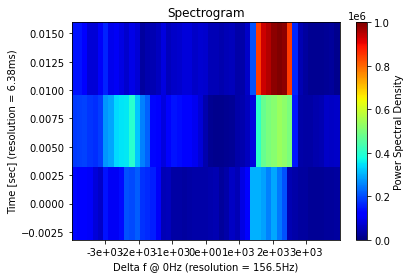

1 414.0520179957041


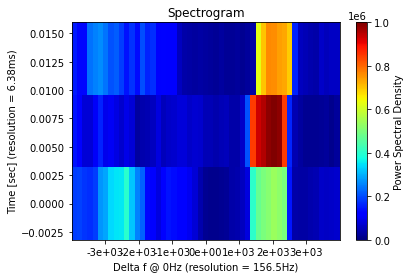

2 410.1905351500935


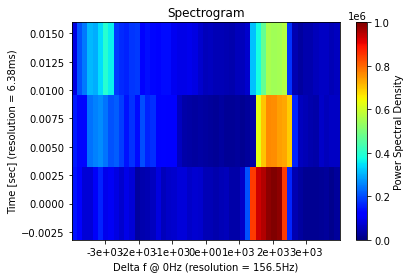

3 406.987994379828


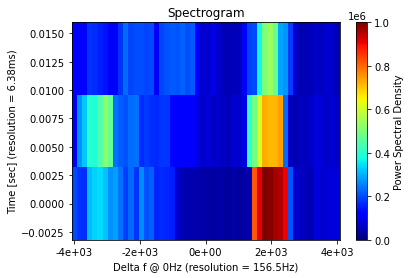

4 430.85675422736256


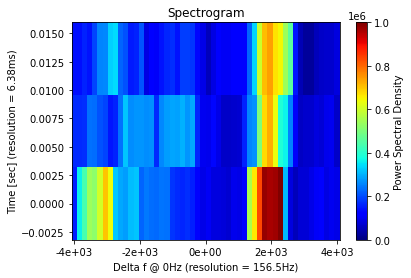

5 413.21826158197575


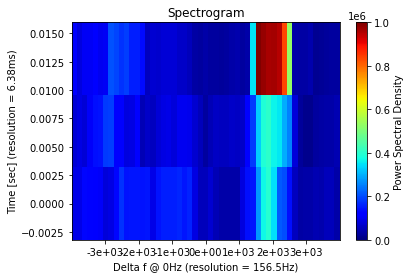

6 413.0015029003124


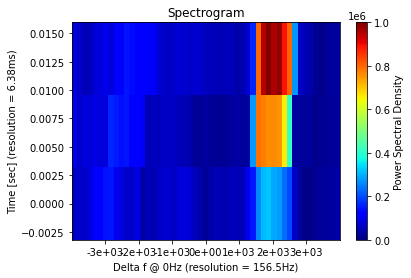

7 410.93294794851215


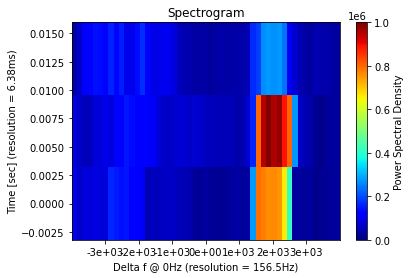

8 430.2205671446096


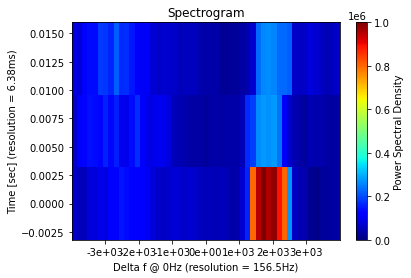

9 437.98098169951606


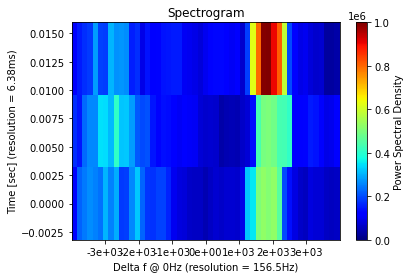

10 401.90779362553917


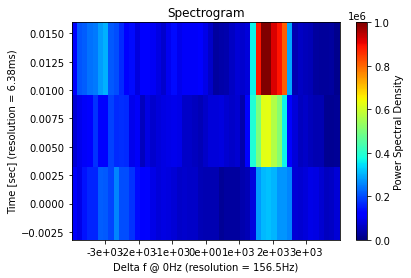

11 394.7401301502606


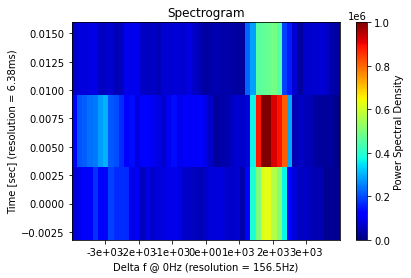

12 404.80412793198445


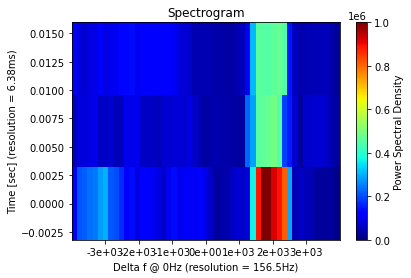

13 407.59306368193575


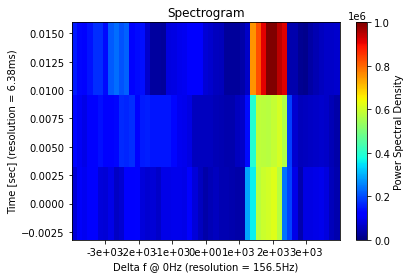

14 413.9691179111853


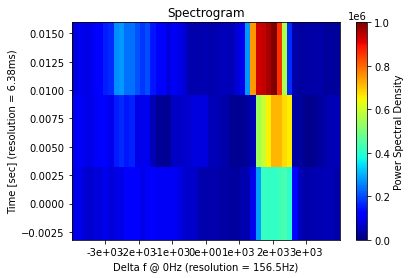

15 419.1751116877533


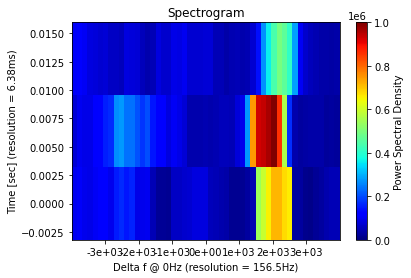

16 437.0932278029228


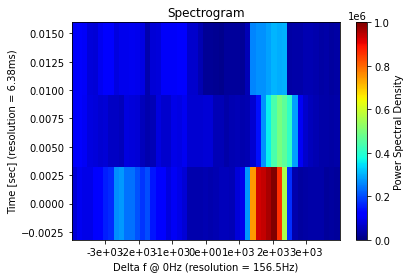

17 450.96246833339706


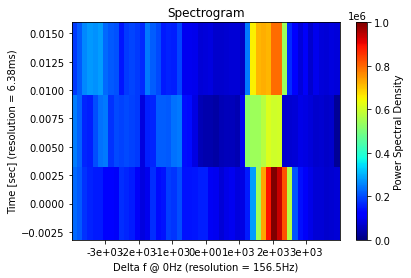

18 440.25568859448686


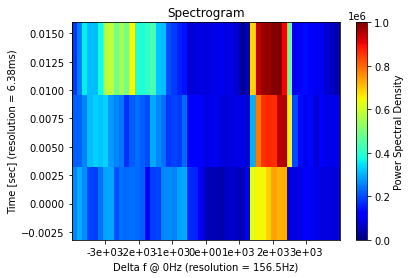

19 447.11622546882666


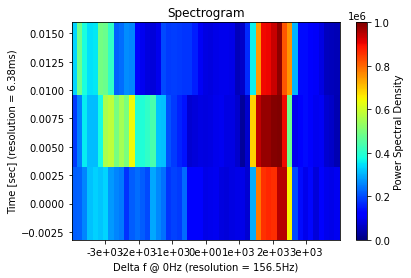

20 444.5855728839889


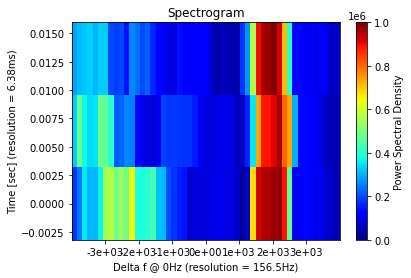

21 443.26176284226267


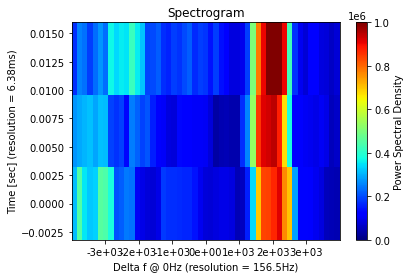

22 451.8717436138488


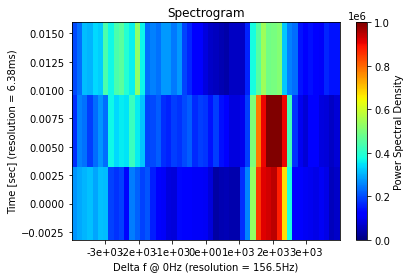

23 424.2701350251443


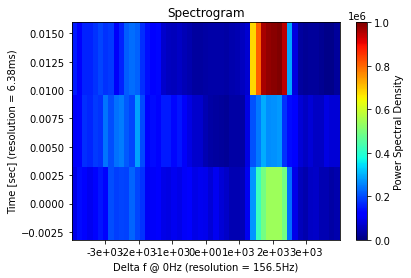

24 438.6354257754939


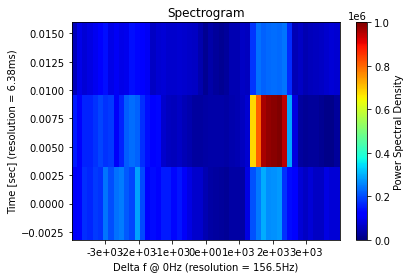

25 426.9164049756845


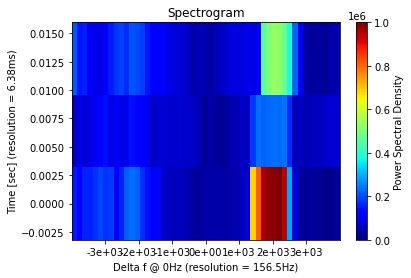

26 468.33786413098005


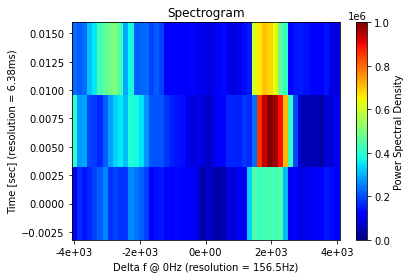

27 409.81422270377345


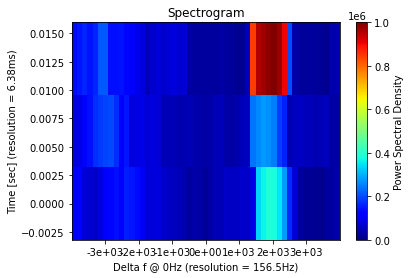

28 408.9311491243991


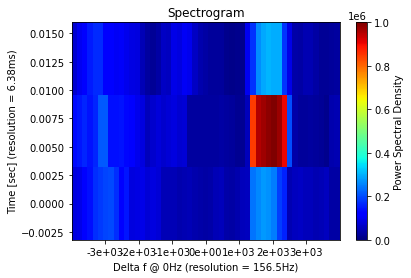

29 415.3625926353461


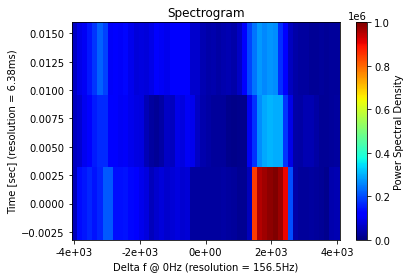

30 475.73707221461507


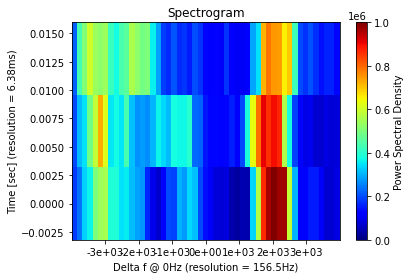

31 448.3826995762513


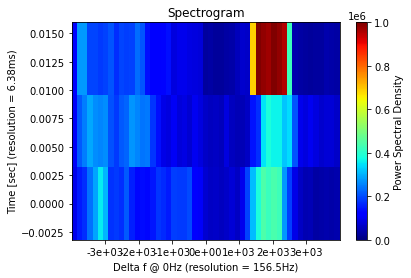

32 424.30227257666286


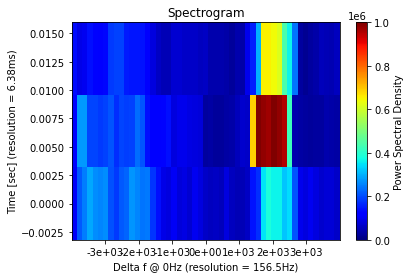

33 402.8988250583177


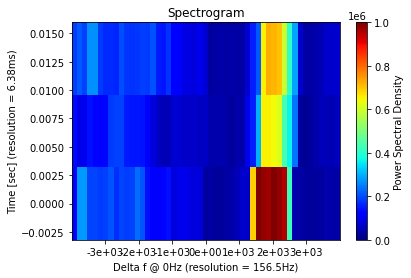

34 412.143586424159


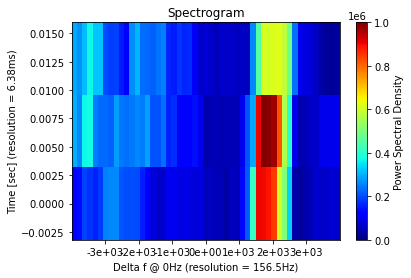

35 413.3233374375277


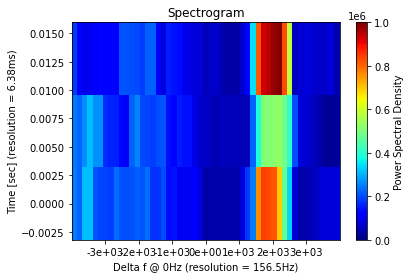

36 404.9498280699913


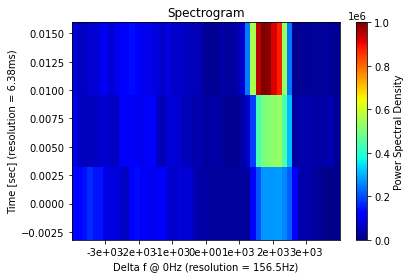

37 394.2475391381083


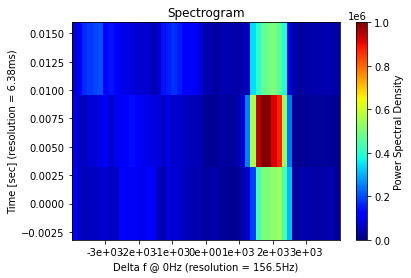

38 389.5499363897512


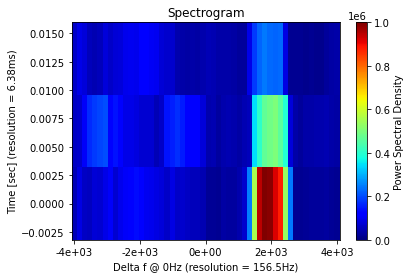

39 407.9312163988469


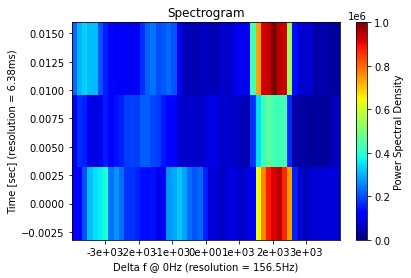

40 427.4764496027849


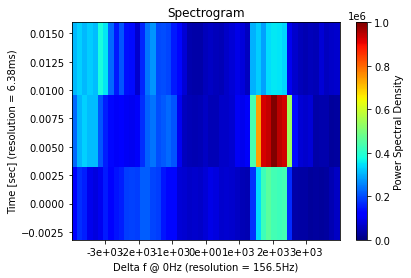

41 457.670799844985


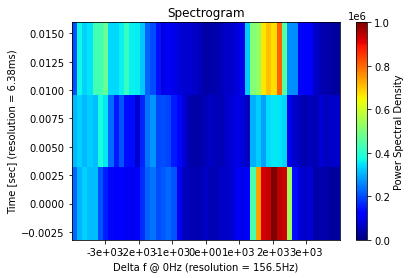

42 535.9772324936125


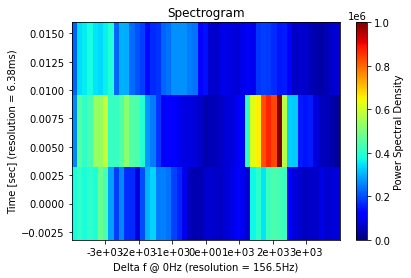

43 565.9644124848417


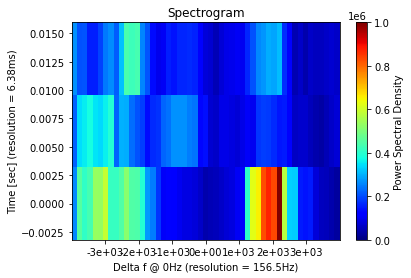

44 999.9668795727088


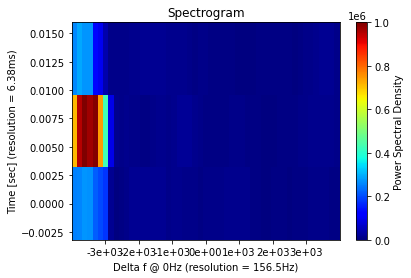

45 529.5965352908042


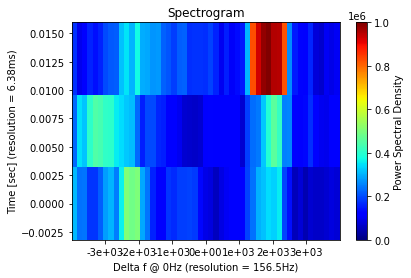

46 465.6869949235506


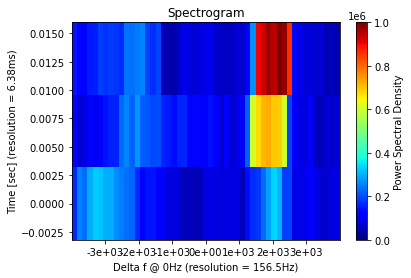

47 433.5389958918379


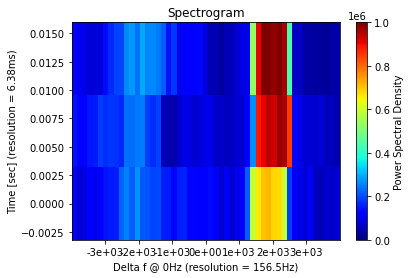

48 412.75964588470436


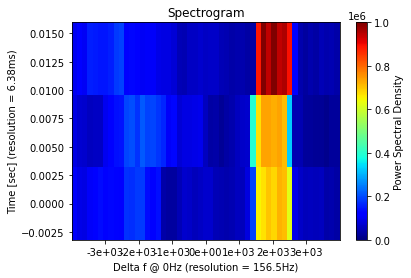

49 409.87638249223414


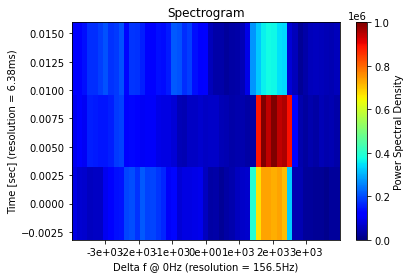

50 417.48150675267686


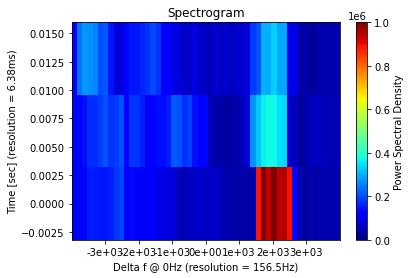

51 458.1732160066143


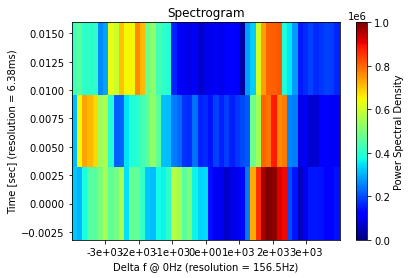

52 437.57518364715895


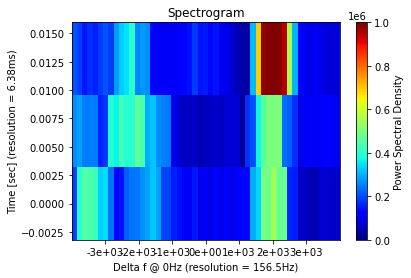

53 423.0922895804159


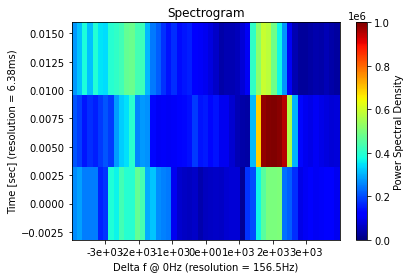

54 421.97387847873847


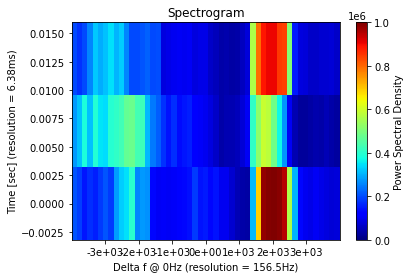

55 431.05293553235174


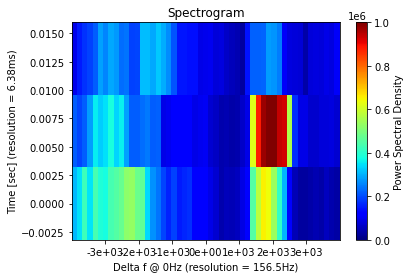

56 430.24863588991036


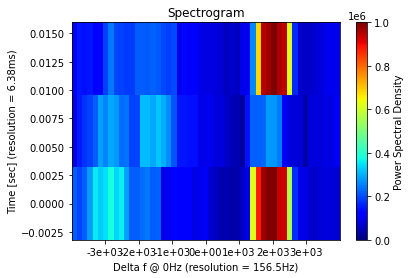

57 418.5573161656997


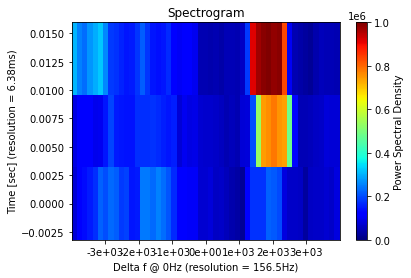

58 420.5899077336427


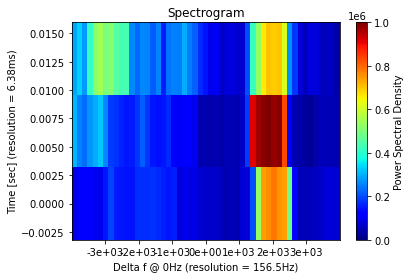

59 417.28927507174694


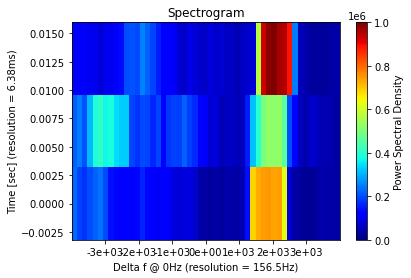

60 407.13470902803954


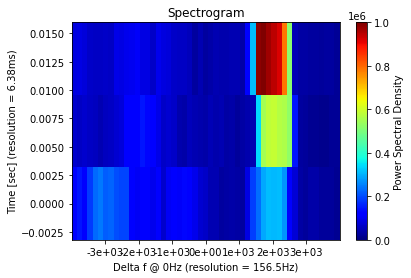

61 405.47402011625695


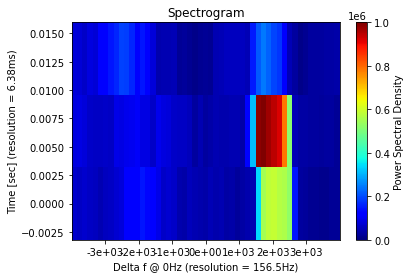

62 409.67534379448864


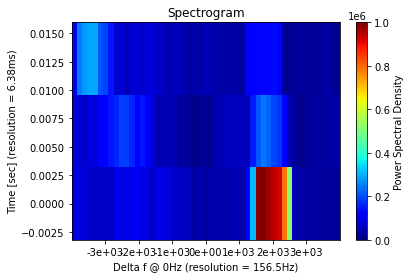

63 478.2870548874414


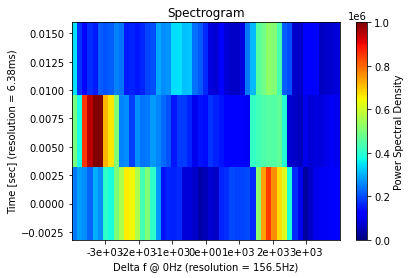

64 999.9999999448426


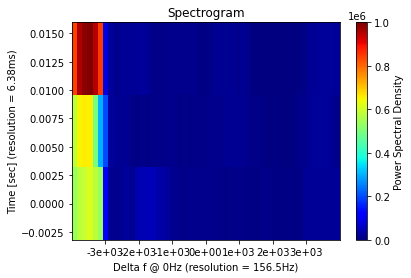

65 999.9999971696399


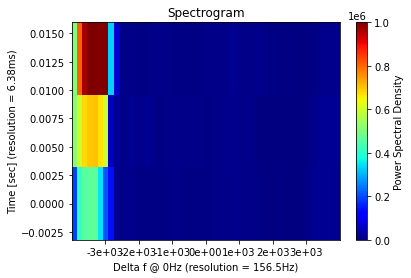

66 430.4112441955933


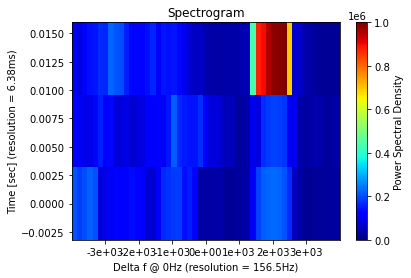

67 421.88483301849783


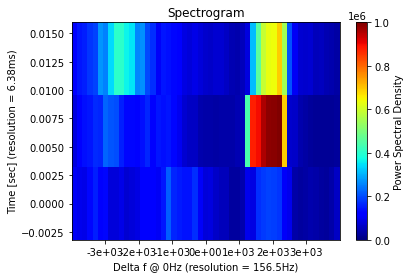

68 415.51701772495846


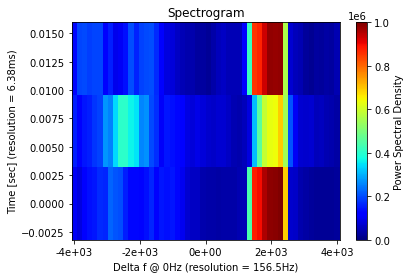

69 421.14349671016157


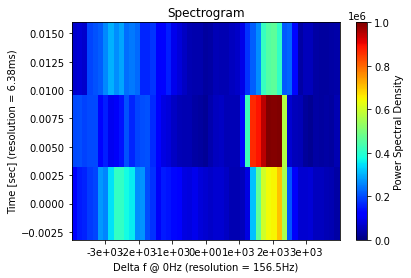

70 431.92402696907095


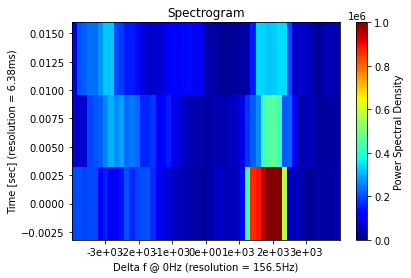

71 451.06826656335386


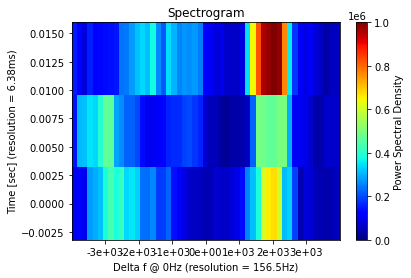

72 999.9999982707604


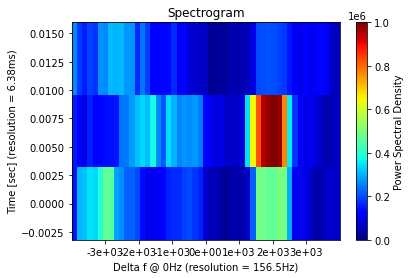

73 428.7174422036537


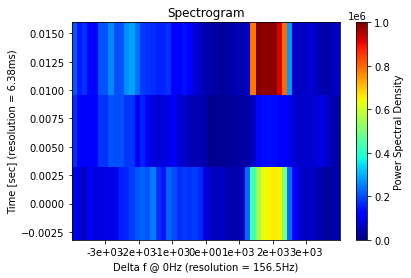

74 425.99289316207273


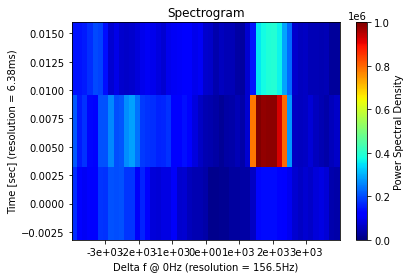

75 417.6621883458773


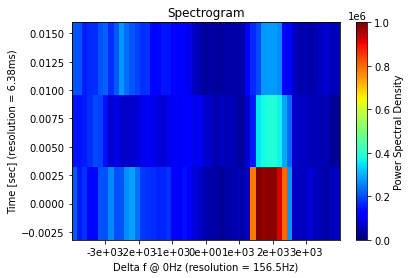

76 446.29225546266593


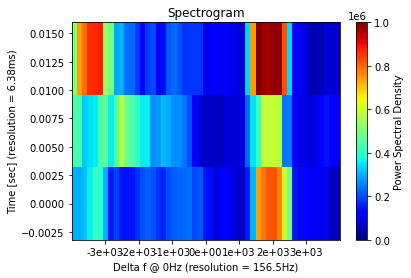

77 429.0725989868554


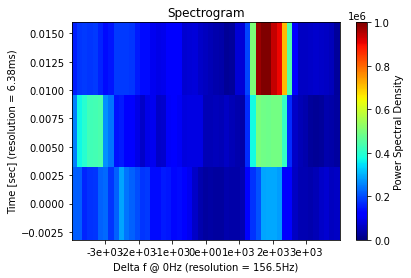

78 445.05741955212


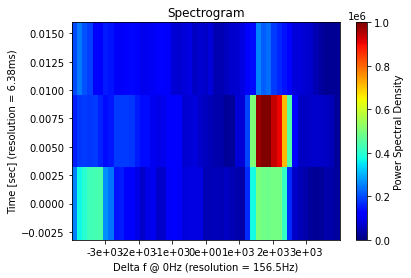

79 434.0303034596677


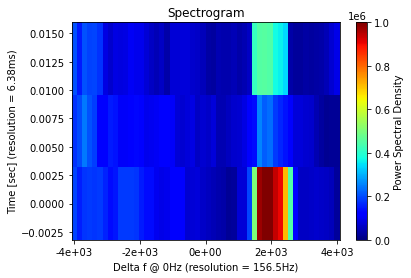

80 440.23442828874977


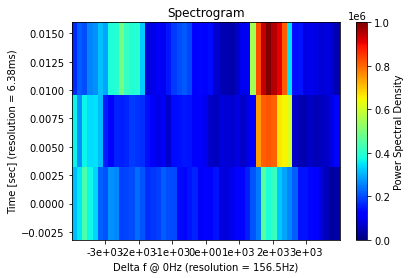

81 431.1270438272767


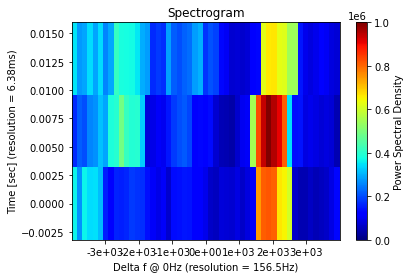

82 409.5589805871226


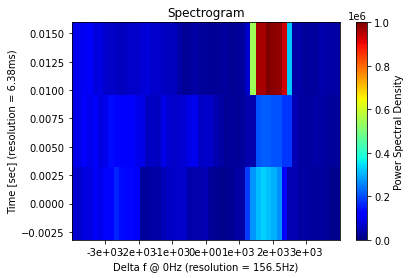

83 414.68643671729797


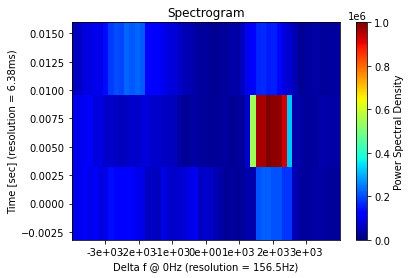

84 417.07439615692044


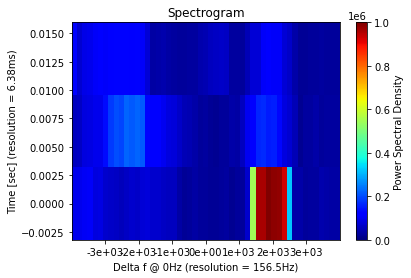

85 478.1861220604858


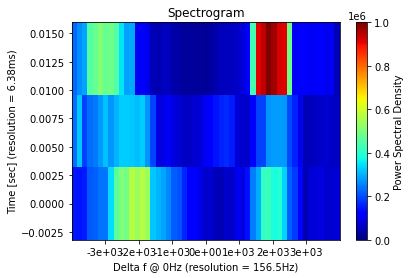

86 425.91621764127626


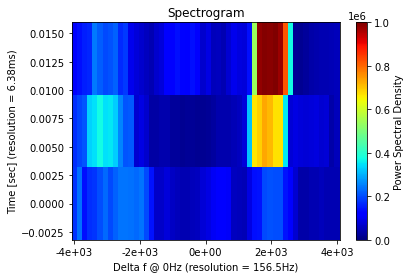

87 420.516299658492


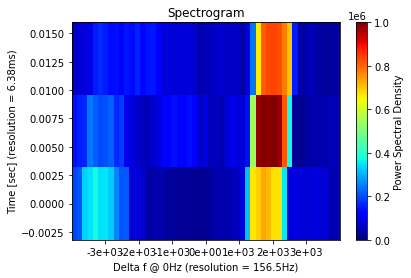

88 427.89937510827997


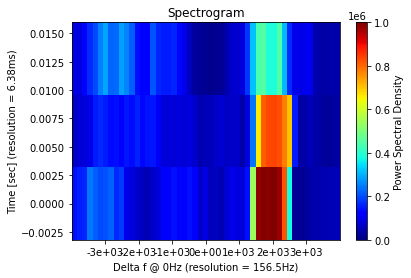

89 434.6117881314144


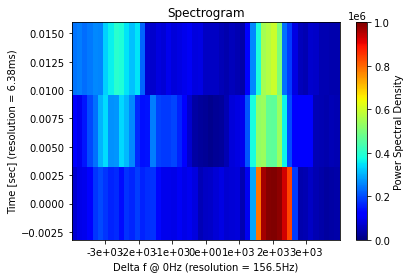

90 399.0230477235514


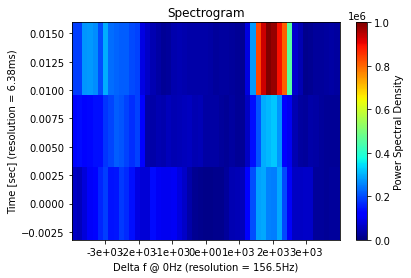

91 388.0682636595585


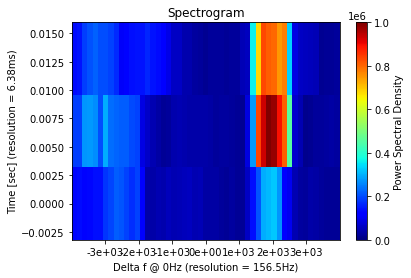

92 391.5711668348649


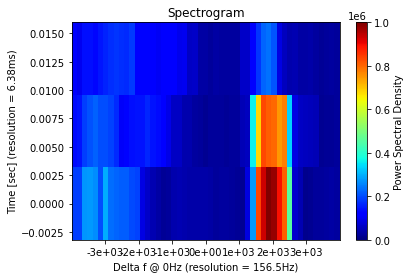

93 414.4028453695589


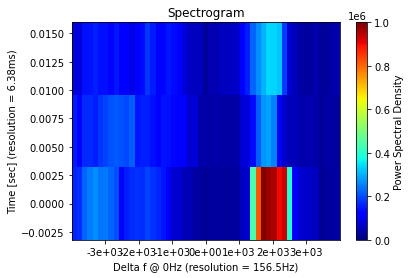

94 477.24941827279974


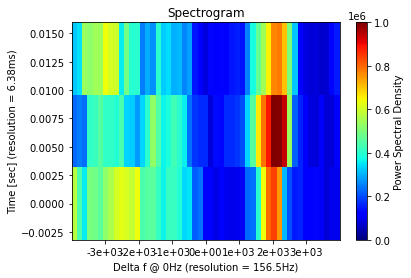

95 448.75046925211757


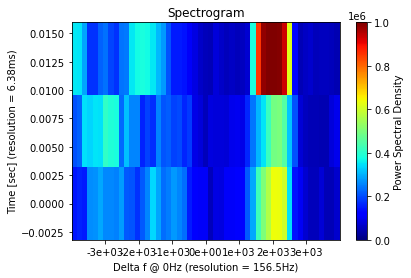

96 451.0519533426519


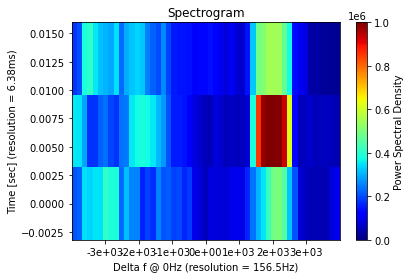

97 416.54758278154657


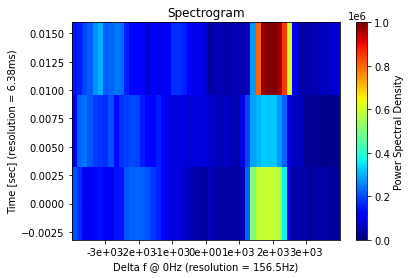

98 431.25764546262485


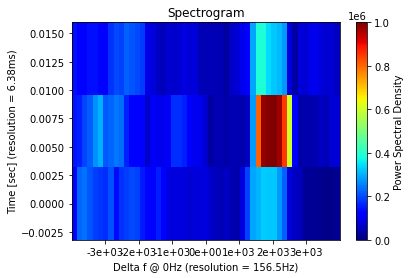

99 419.7233891456966


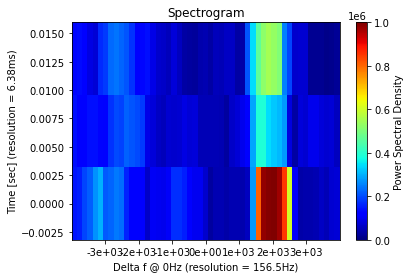

100 473.0404655212559


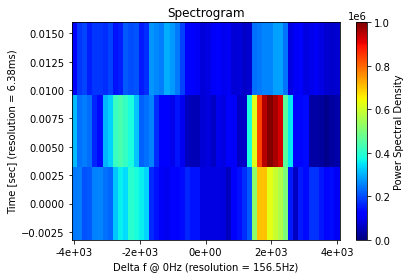

101 471.28826081629586


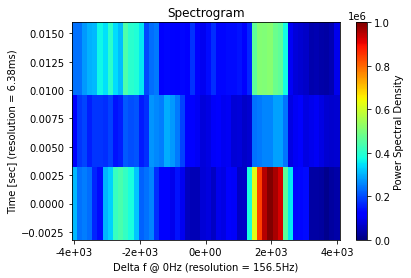

102 448.72806290219035


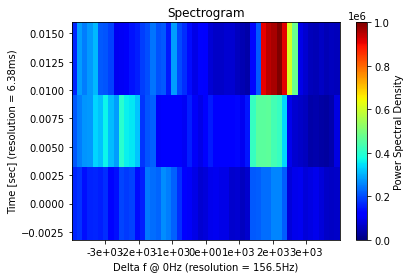

103 396.2560674294199


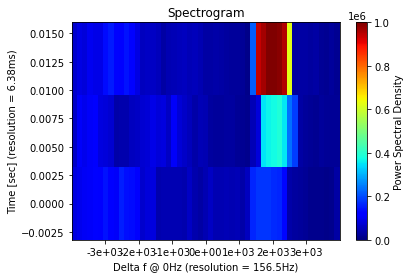

104 397.8299469027878


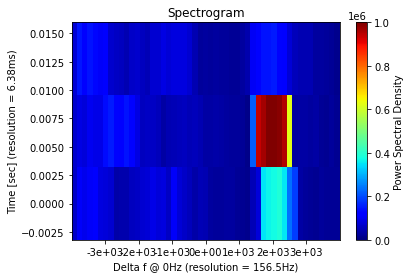

105 405.3498316740854


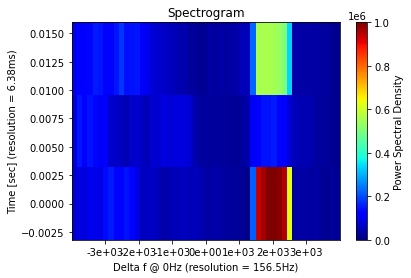

106 432.0127239991489


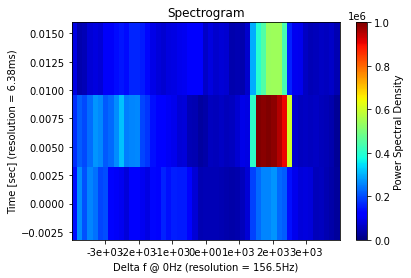

107 407.48066304433917


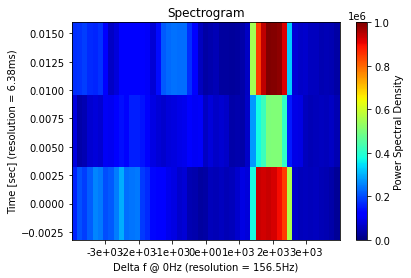

108 408.9237672891486


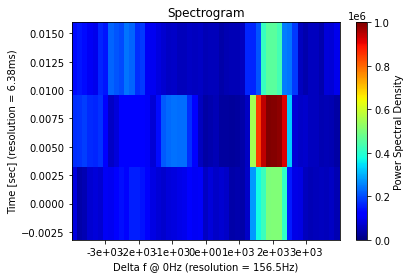

109 404.0612603109099


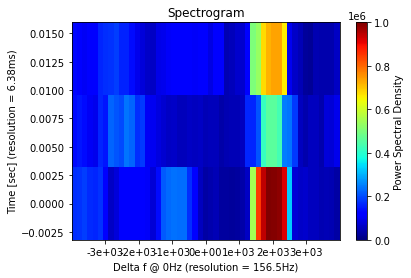

110 433.5326166623024


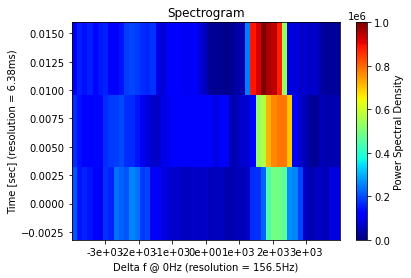

111 413.4401144781491


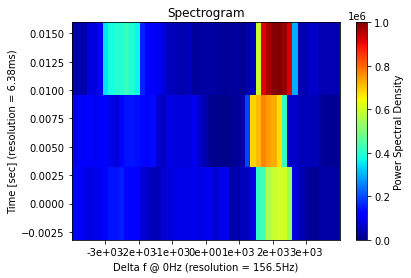

112 420.6520171404951


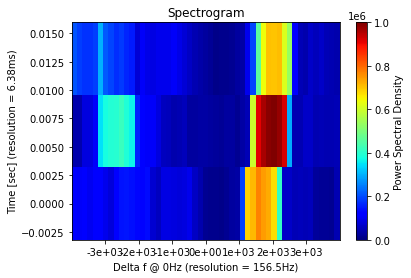

113 410.98712034370624


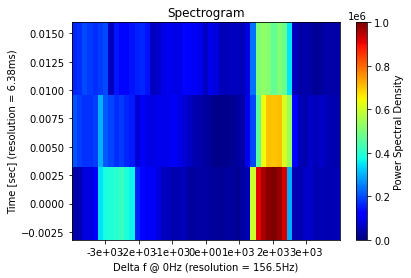

114 424.93481760972804


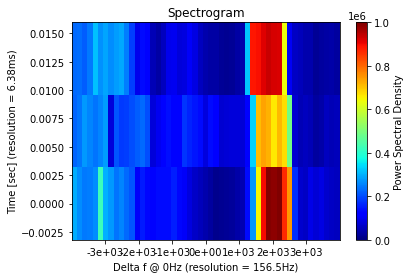

115 421.83308453457823


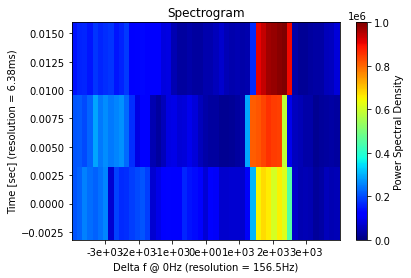

116 423.2034862359046


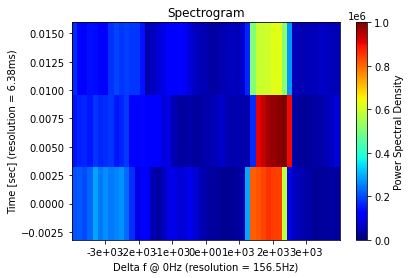

117 430.2015797635132


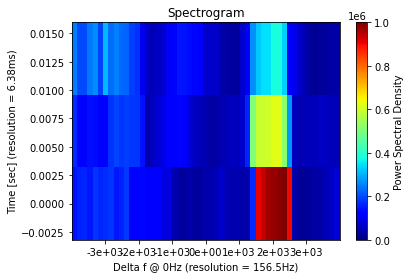

118 444.9546350849772


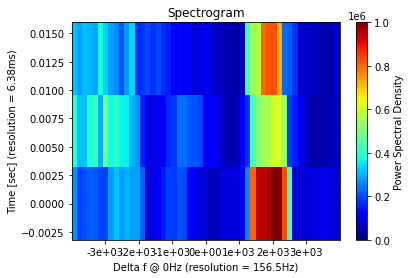

119 461.2220316724555


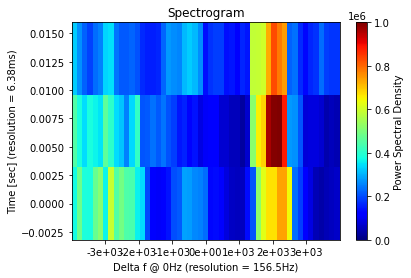

120 459.50388287099804


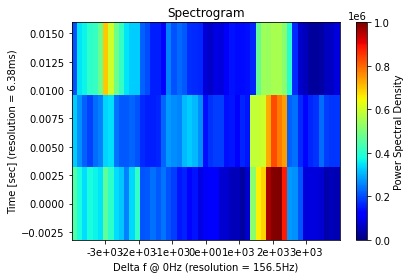

121 505.29114808737165


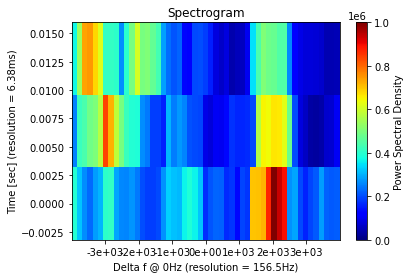

122 498.26507425317635


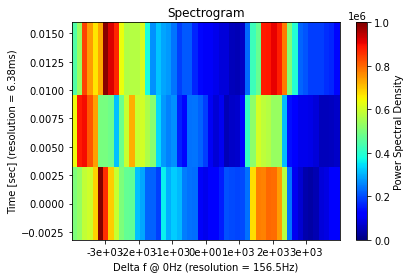

123 426.10274054002116


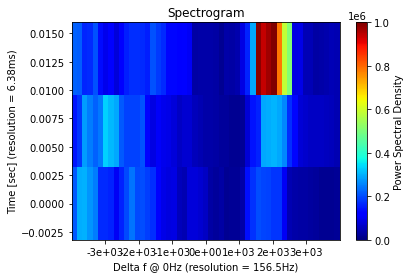

124 420.1003385800565


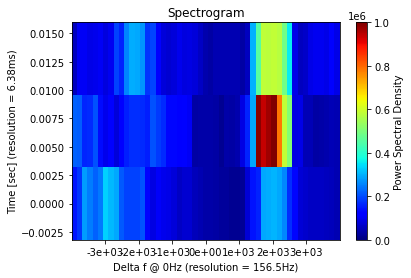

125 426.18153567764443


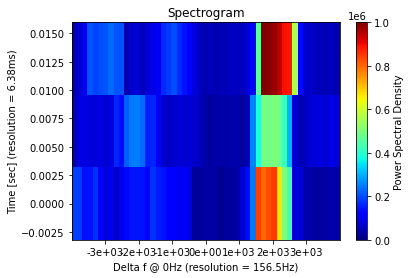

126 427.1281219150393


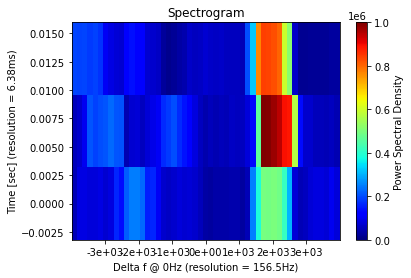

127 413.95473702096547


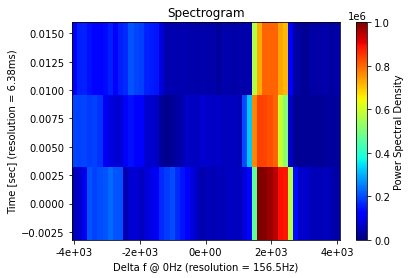

128 397.8247827172571


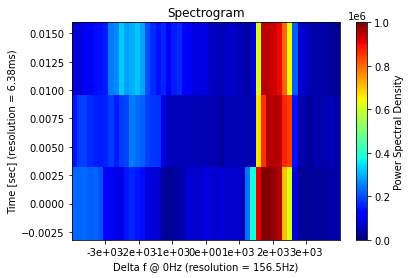

129 395.4930407648037


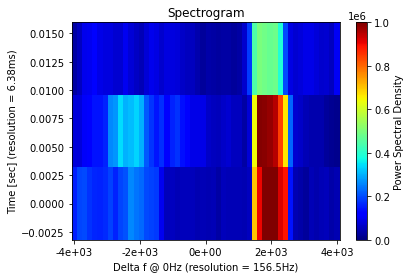

130 412.2894893687363


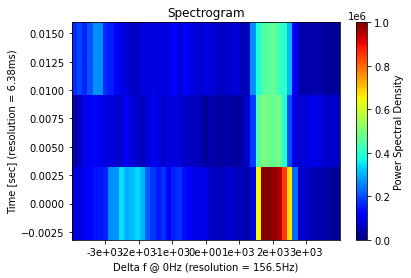

131 423.51000633464605


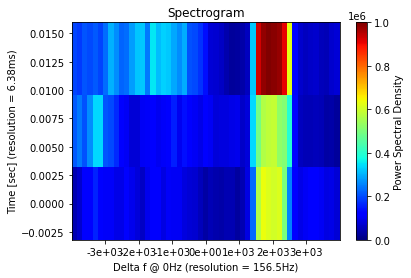

132 449.1434501108


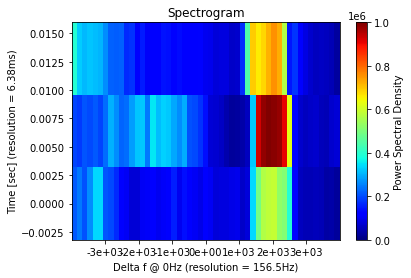

133 426.33502129121393


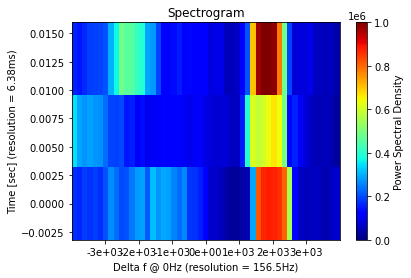

134 439.81430838291715


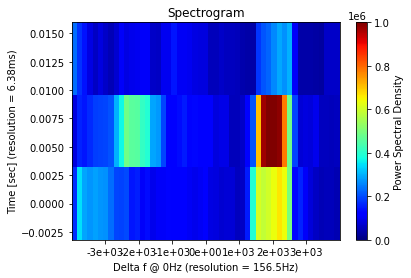

135 405.4128705507941


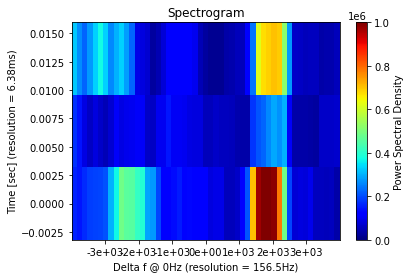

136 410.26211867294023


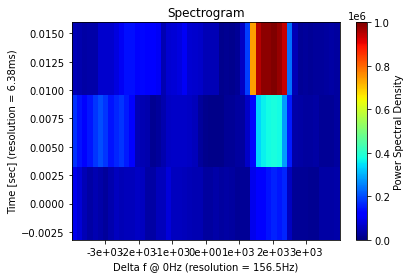

137 414.48775553841995


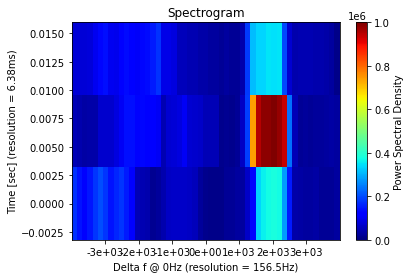

138 418.40184006430036


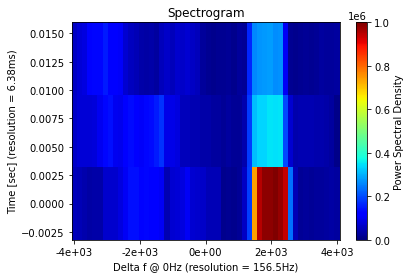

139 434.4137414417804


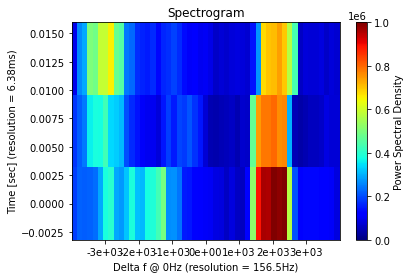

140 410.77602166538134


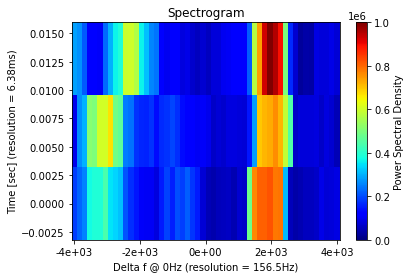

141 405.55166613404367


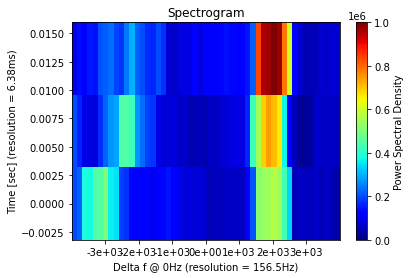

142 403.3251412622677


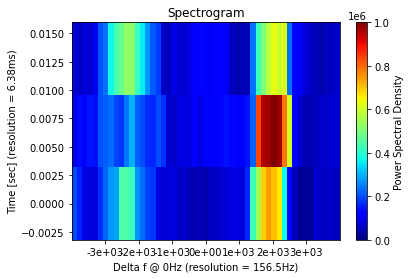

143 434.35848081786594


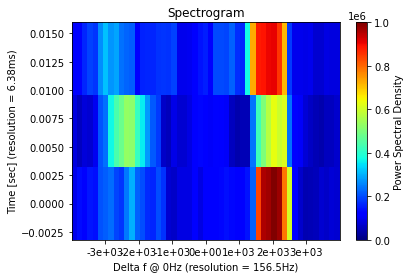

144 472.6641891445421


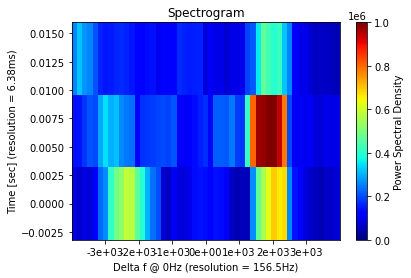

145 430.88827541829414


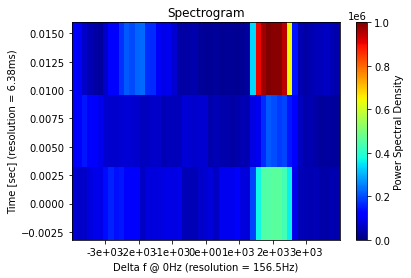

146 428.4364709602894


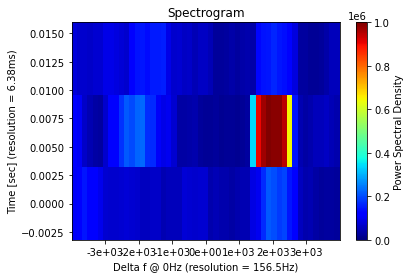

147 434.49450843546003


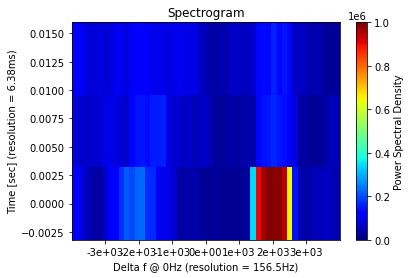

148 459.15098808997243


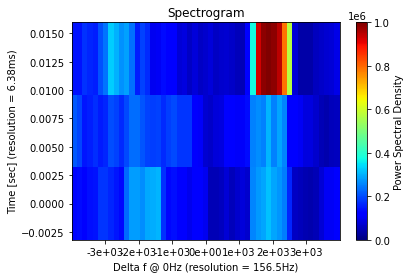

149 429.0541886943296


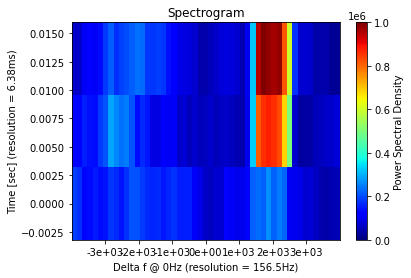

150 422.9134869575363


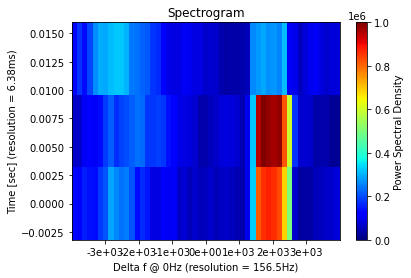

151 451.786549222599


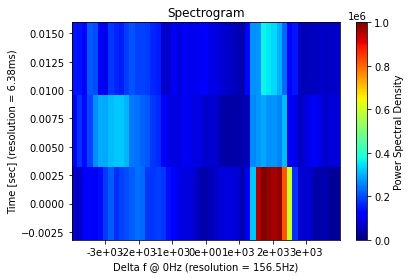

152 474.86507736396004


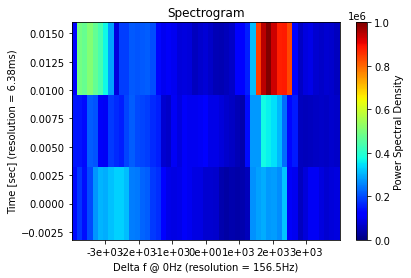

153 444.1716871107411


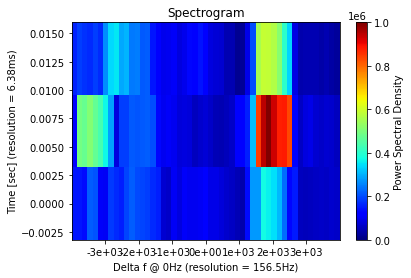

0 580.4527104026331


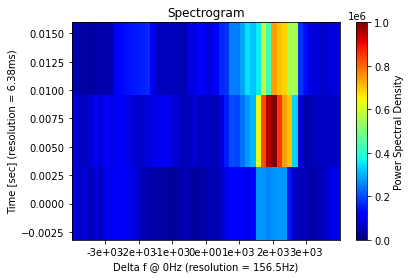

1 673.2987256883705


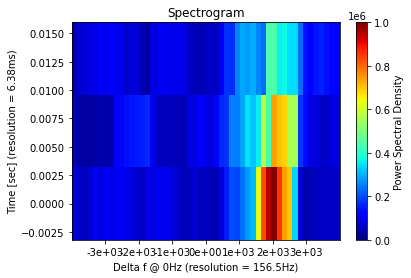

2 889.0618684520418


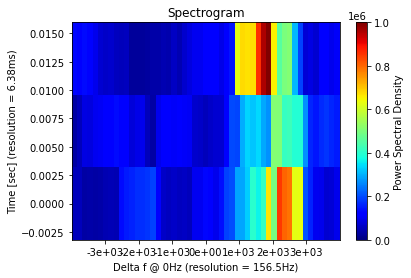

3 826.1952471216465


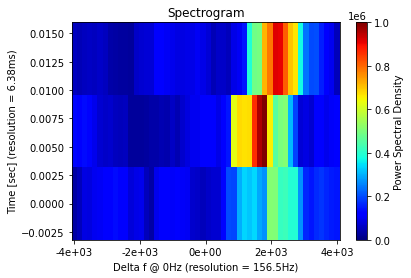

4 764.4724391201672


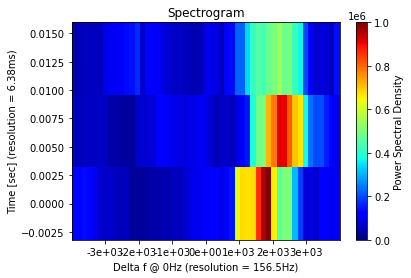

5 823.5217510461196


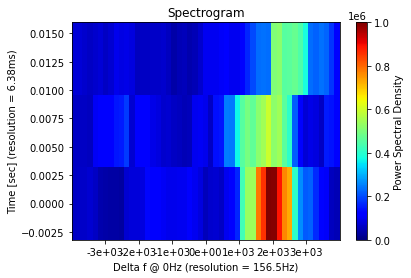

6 999.9999986350549


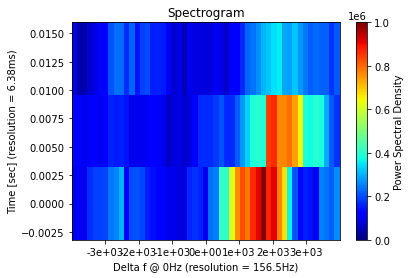

7 809.4261063835286


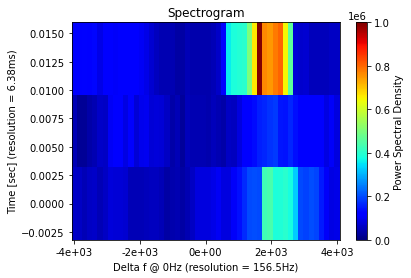

8 769.6832015412829


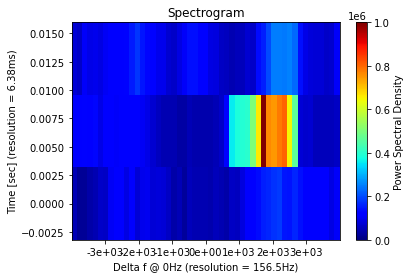

9 696.6167834960129


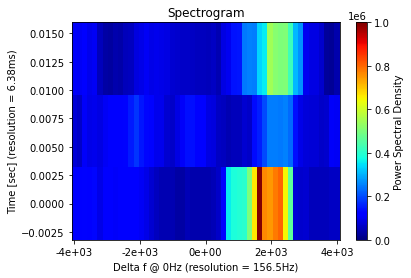

10 635.6116201152129


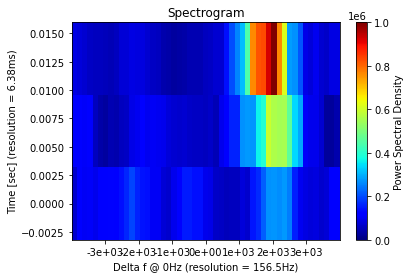

11 599.0346061819021


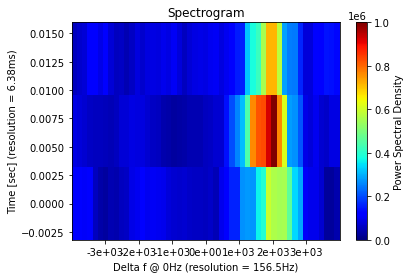

12 540.0991311236305


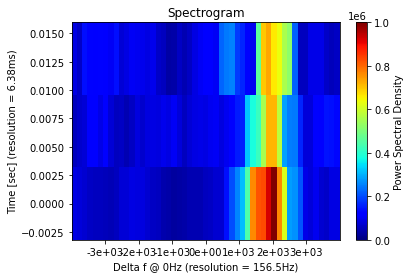

13 615.421316665625


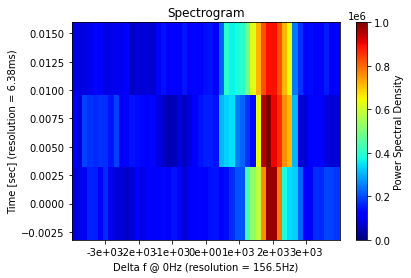

14 849.0510790424329


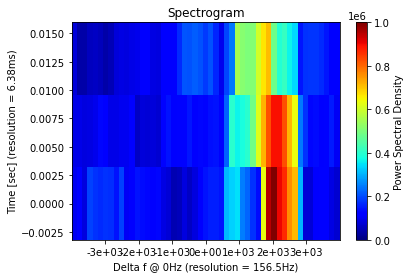

15 810.5760895916326


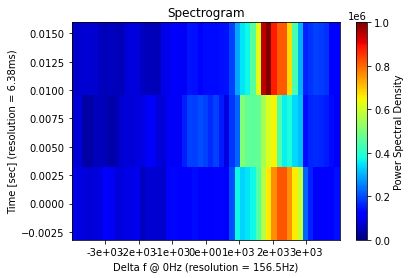

16 784.4762171644888


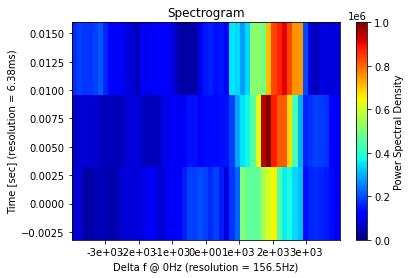

17 821.0629504861594


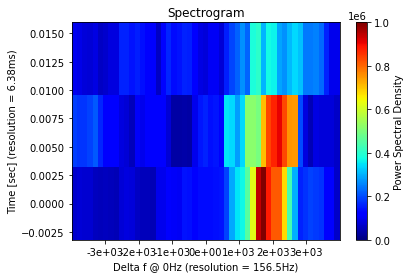

18 911.2693653799302


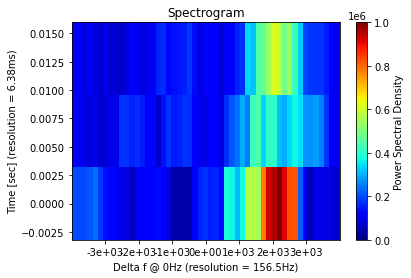

19 999.9999540296466


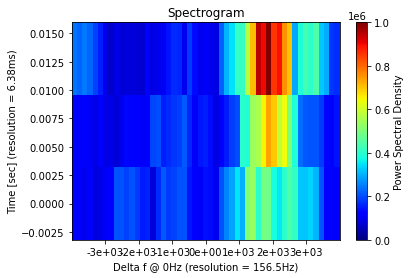

20 913.7592551444511


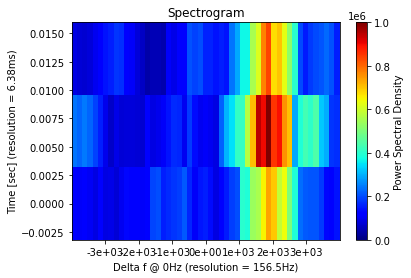

21 844.9991678751987


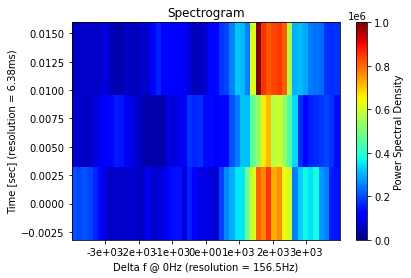

22 638.5611939754363


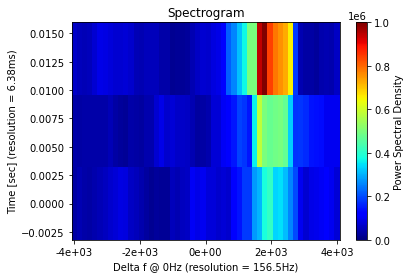

23 579.566431405598


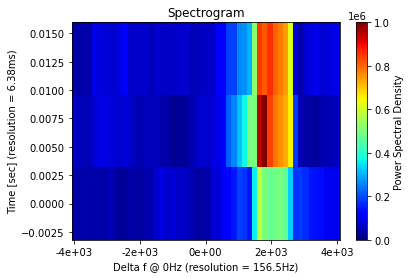

24 628.2571424414898


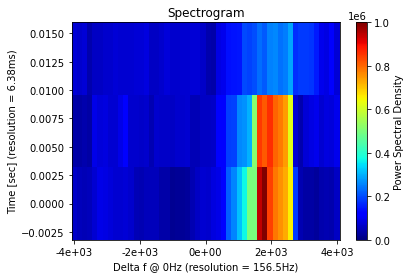

25 788.2546135376137


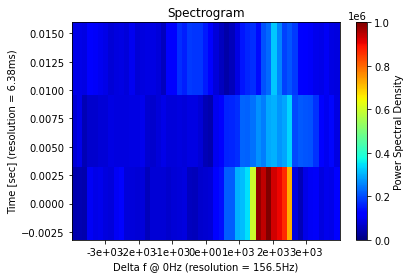

26 999.9999999278606


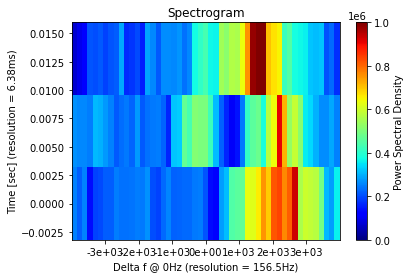

27 975.0181588326404


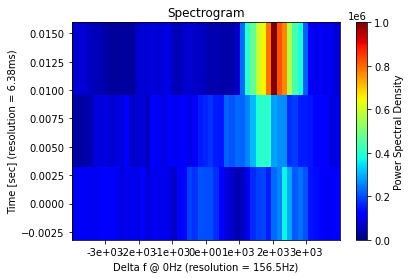

28 803.3561189700455


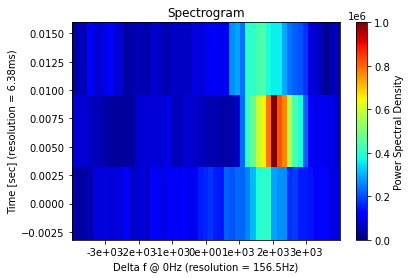

29 671.8167980361184


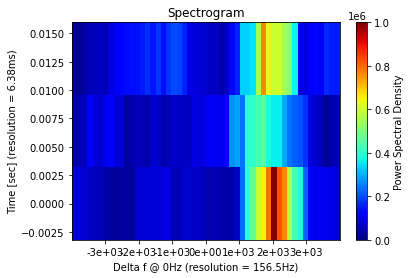

30 698.3221594398103


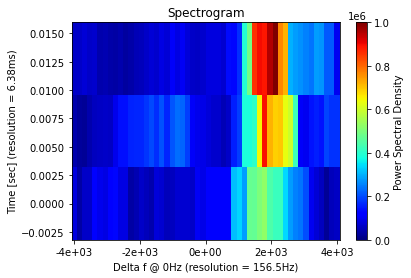

31 630.4558642670524


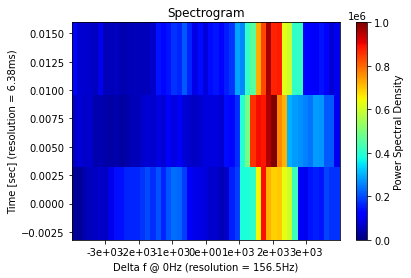

32 624.1334364266186


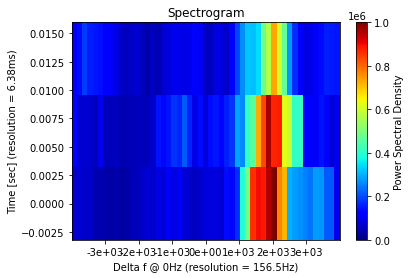

33 616.7123359730736


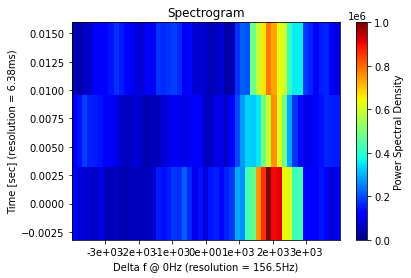

34 821.6516642020758


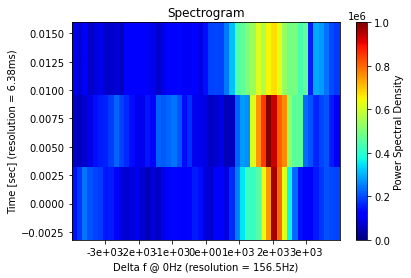

35 862.873447768612


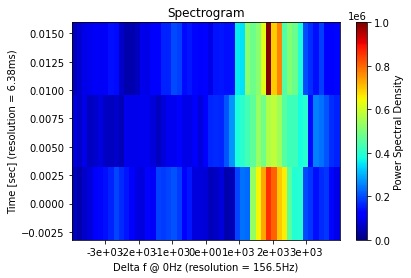

36 999.9999983828319


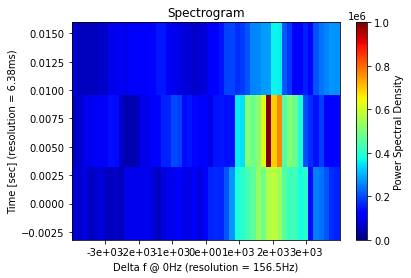

37 999.9999893661236


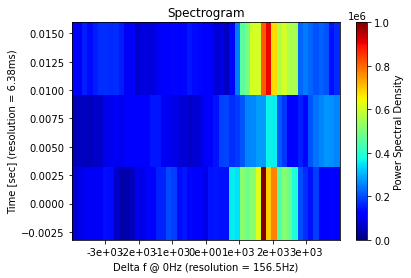

38 999.9999996646903


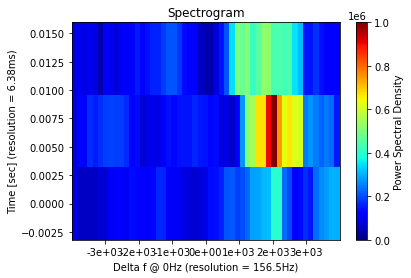

39 985.141904923564


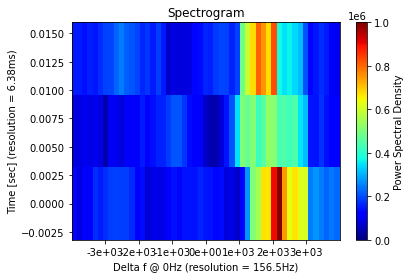

40 996.5343607600092


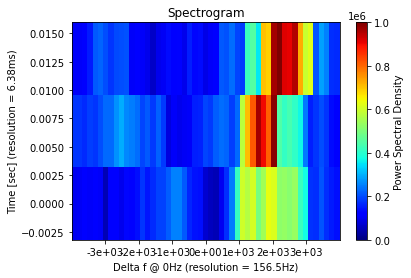

41 828.3120651196518


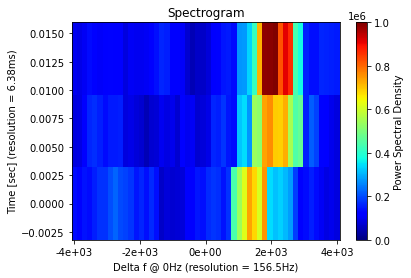

42 657.7996282329042


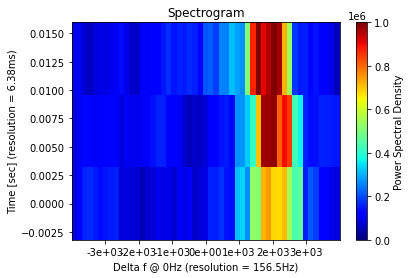

43 540.6944500925232


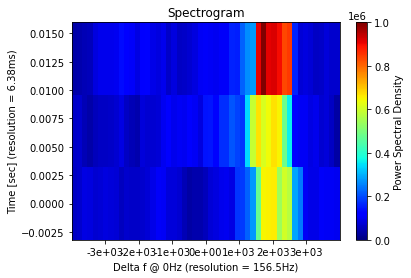

44 557.2887096940211


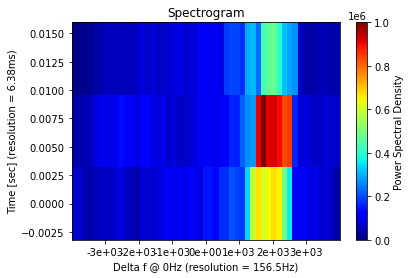

45 564.560776782811


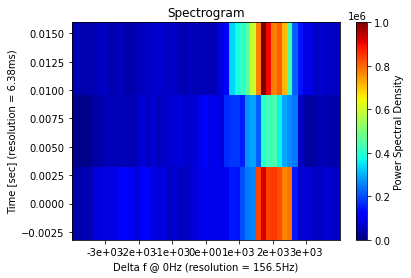

46 610.4274876415809


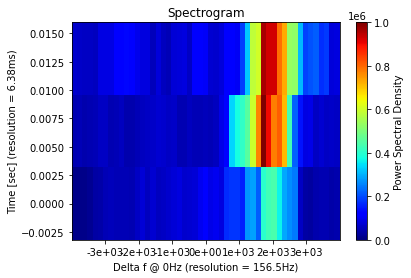

47 568.6368084504816


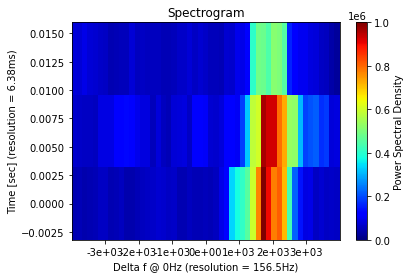

48 633.3153827441275


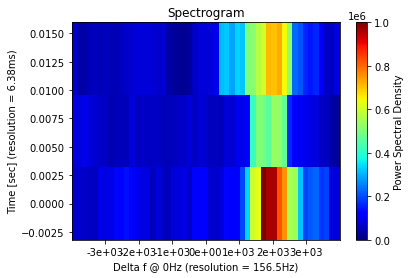

49 758.7796623202553


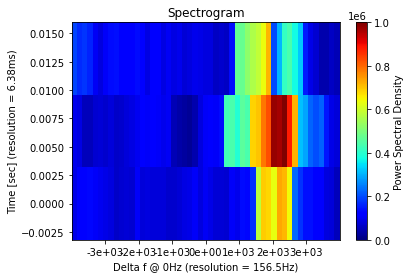

50 934.881772956906


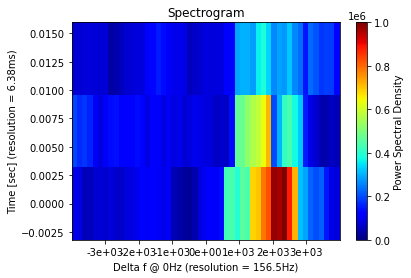

51 882.5160096013317


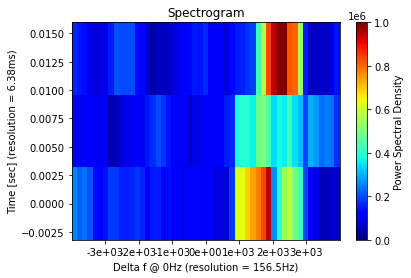

52 937.3824587244058


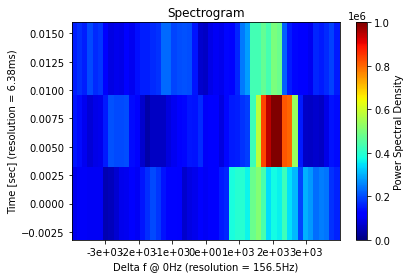

53 561.0352494179872


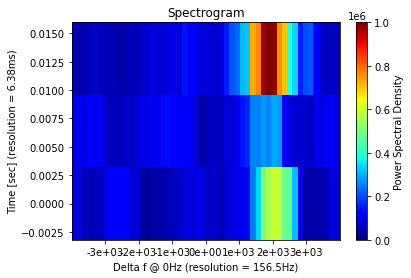

54 710.5092336989751


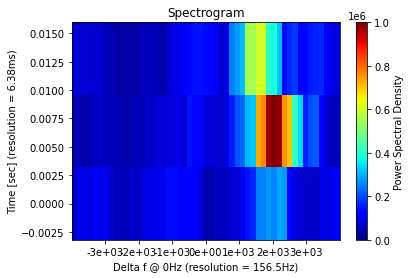

55 799.4413388991536


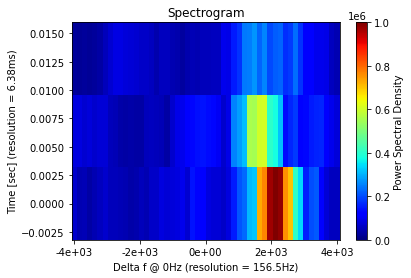

56 732.6266995274962


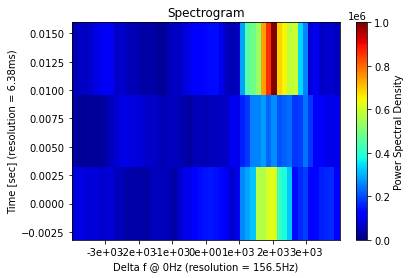

57 770.2279720881654


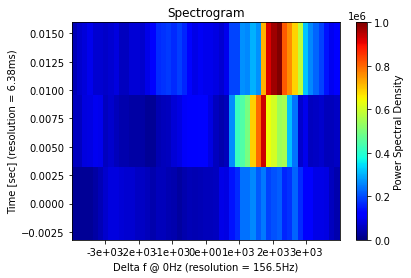

58 760.8008716741913


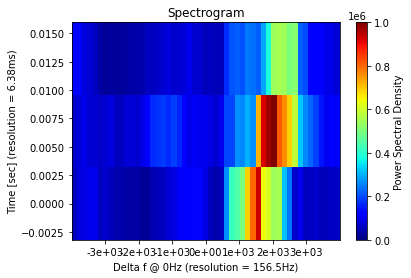

59 691.0833129785414


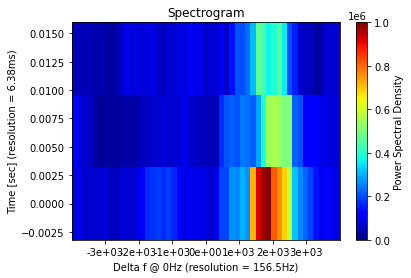

60 769.0234681974011


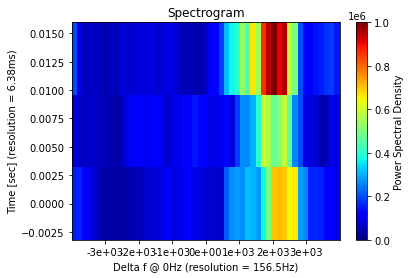

61 793.0858585723904


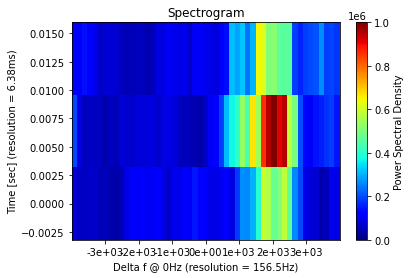

62 697.5200109596885


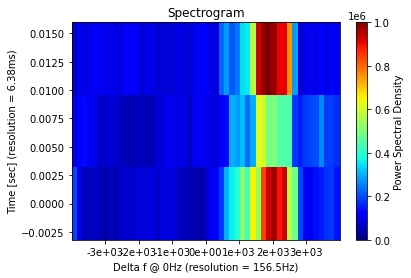

63 707.7424071893604


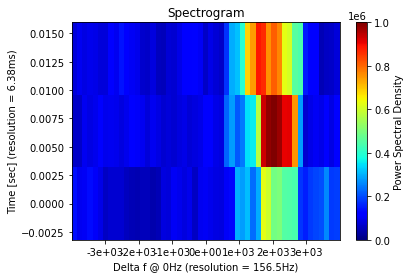

64 677.4424367862694


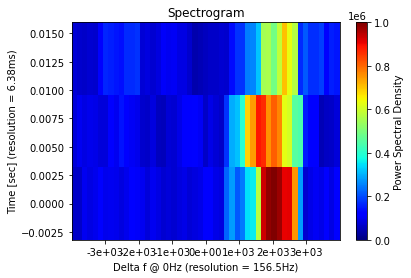

65 744.6859004743543


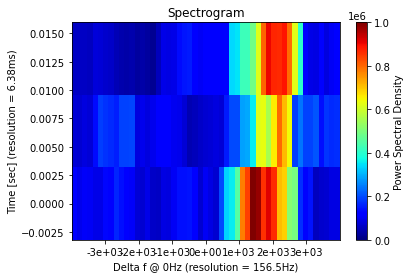

66 585.817553770151


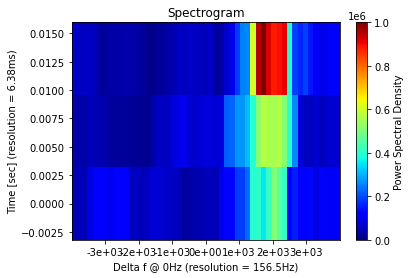

67 581.7803288360981


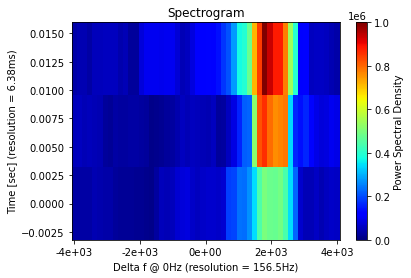

68 581.6958855513103


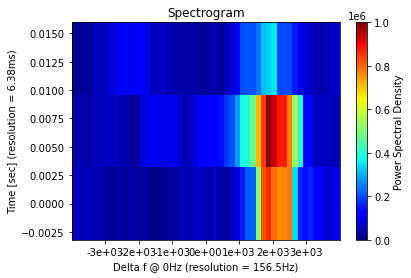

69 740.2876747650108


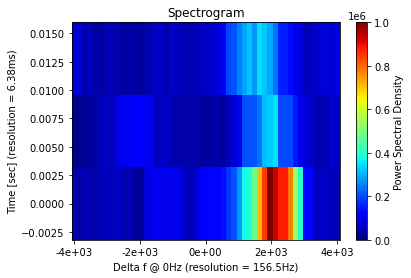

70 999.9999787791849


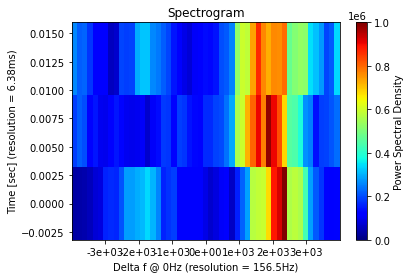

71 999.9998550790282


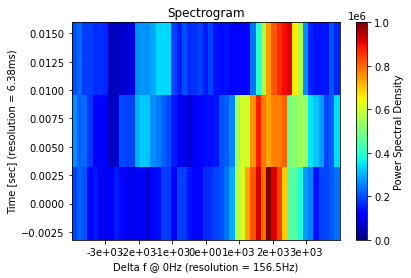

72 712.3403811734071


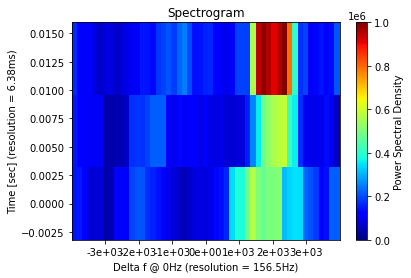

73 563.4117774254776


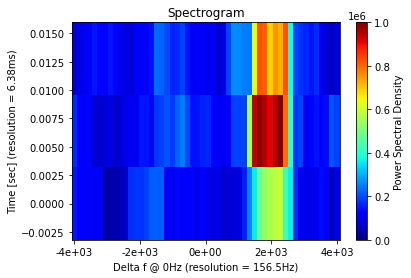

74 567.3274499095844


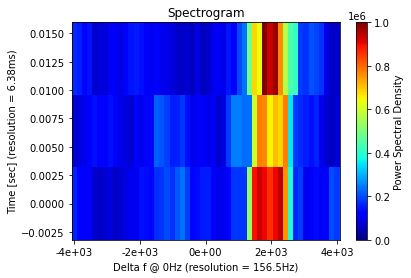

75 612.7459398024436


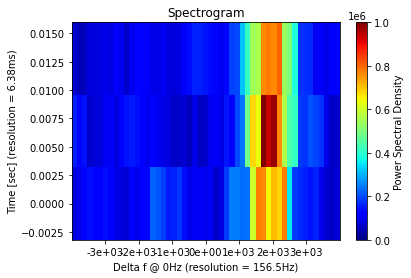

76 595.7841053016834


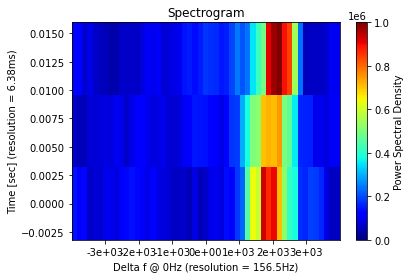

77 696.7942144216797


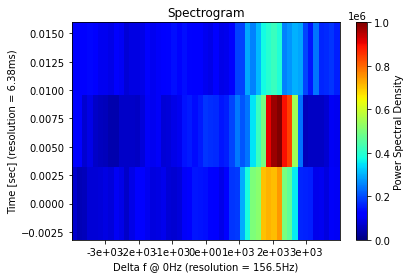

78 997.8668245091648


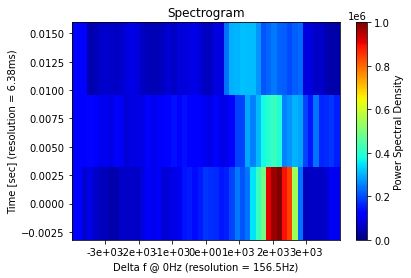

79 999.9999999820819


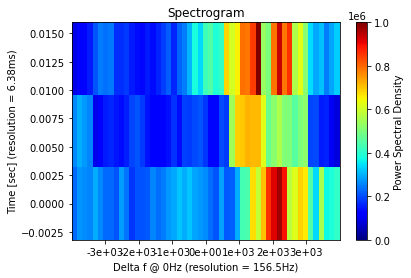

80 999.9999996139363


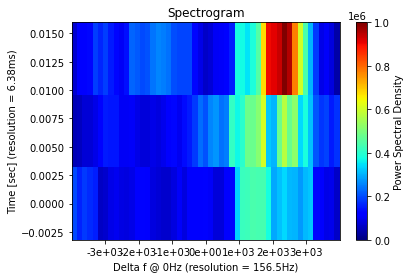

81 918.8743649049658


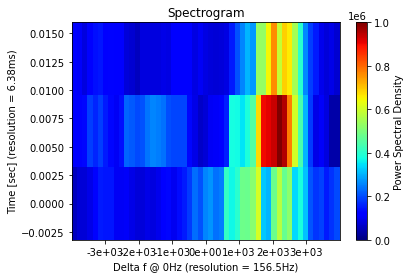

82 832.2939025782506


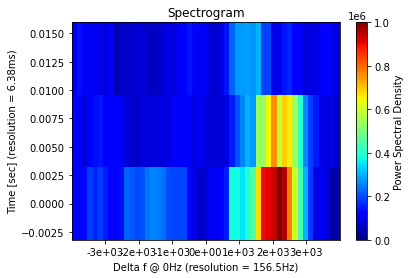

83 897.9014080255388


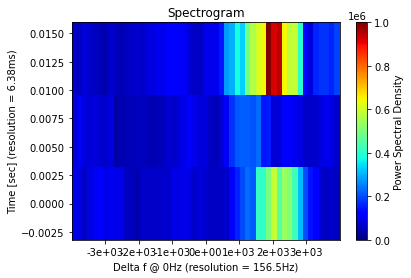

84 618.7406704780292


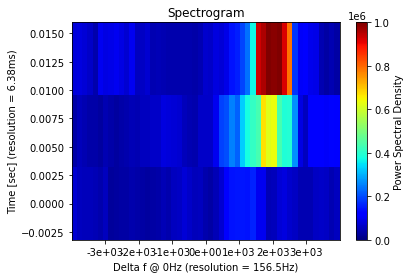

85 583.6766922914553


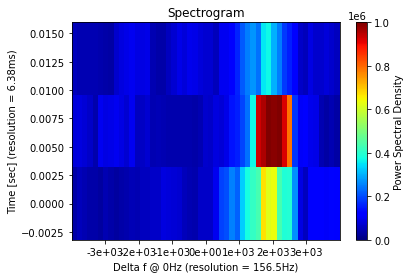

86 628.1589209801059


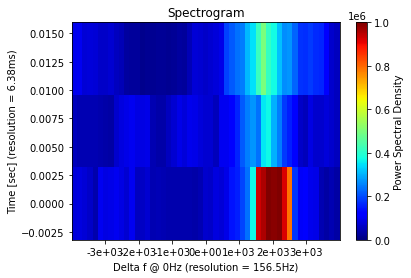

87 849.412790334276


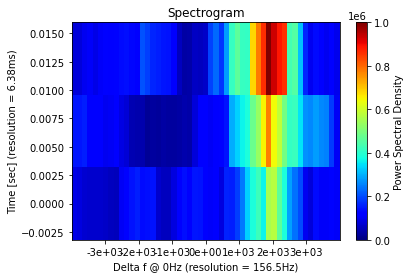

88 866.1988716398381


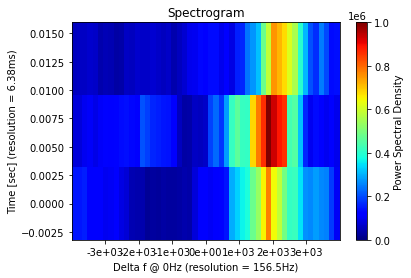

89 824.2340040924255


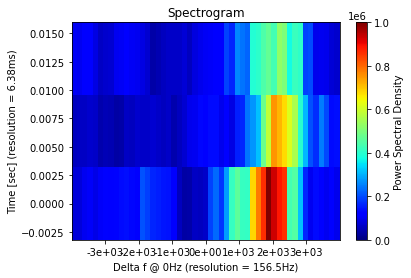

90 572.3990804380658


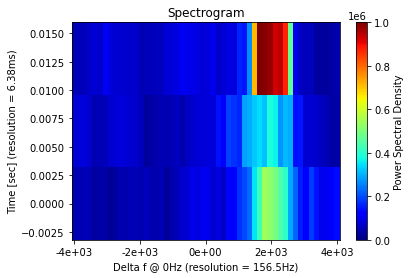

91 668.0541880383827


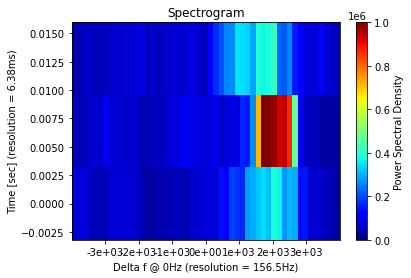

92 616.2355939521835


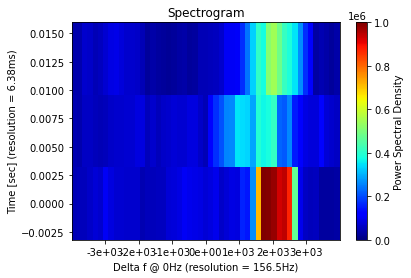

93 999.9999347227247


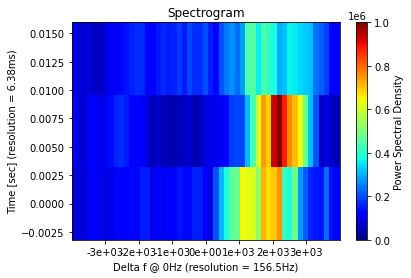

94 625.5368381647581


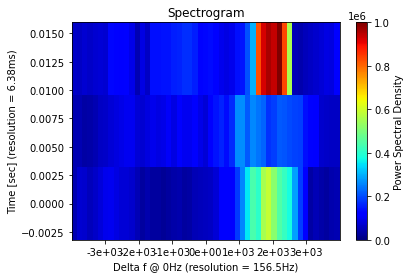

95 591.1591590595518


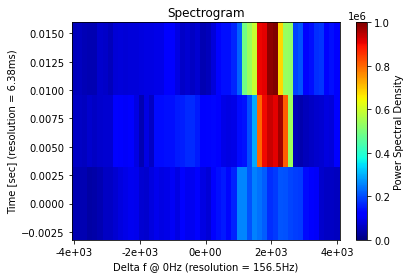

96 567.6395835425296


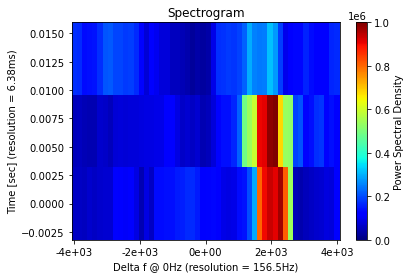

97 823.4561437661944


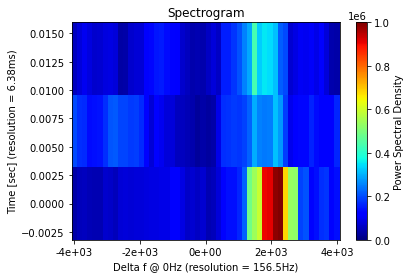

98 999.9999999873719


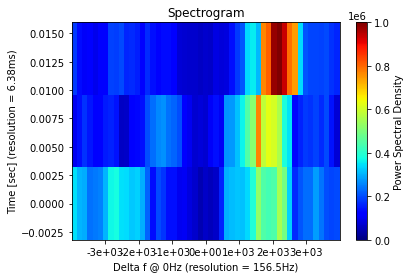

99 846.0647085009126


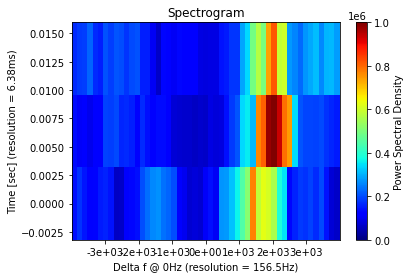

100 999.9999999226558


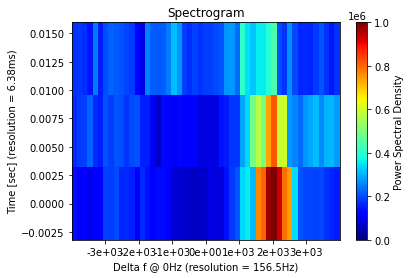

101 999.9999169271587


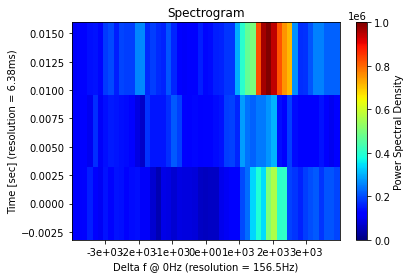

102 764.3548453783318


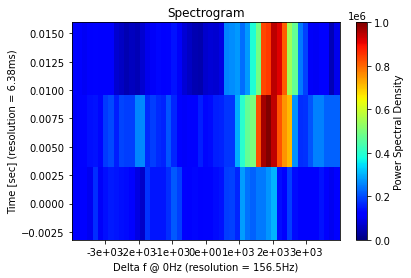

103 595.4919406520326


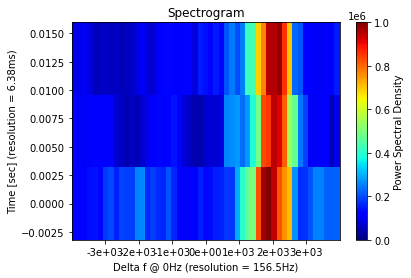

104 631.0542034781736


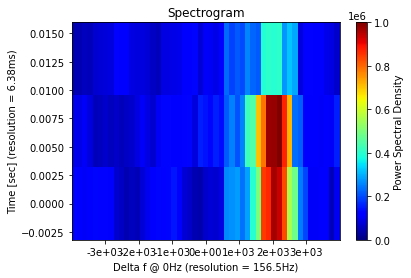

105 758.1959695715966


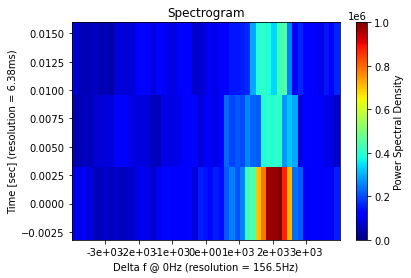

106 737.8232482902811


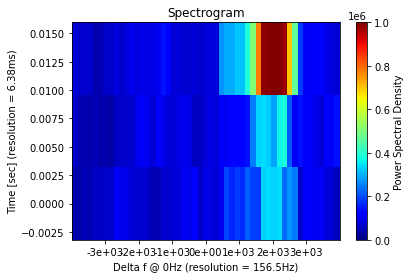

107 776.365375435771


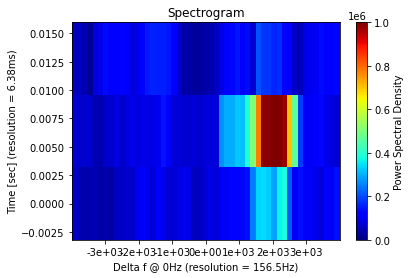

108 805.5550612728646


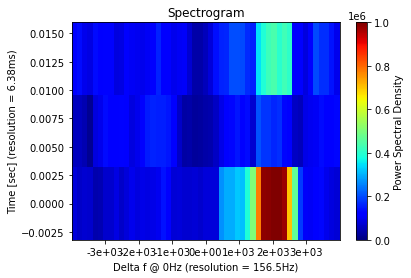

109 999.9999984791177


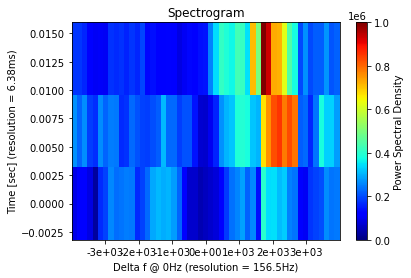

110 999.9999996997369


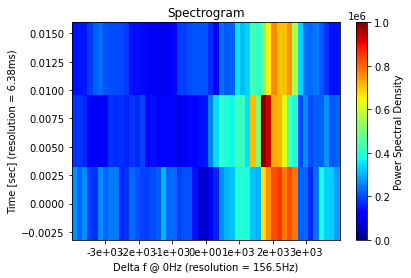

111 840.7077171944337


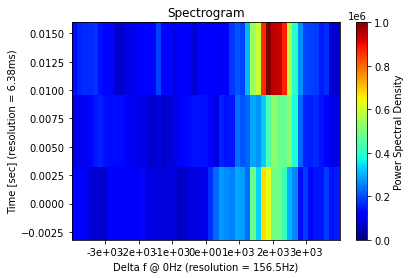

112 796.2271650102771


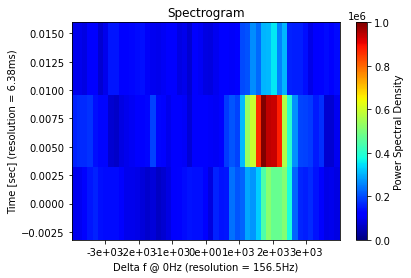

113 853.4848064000787


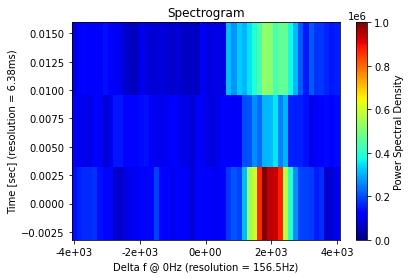

114 893.3805550628704


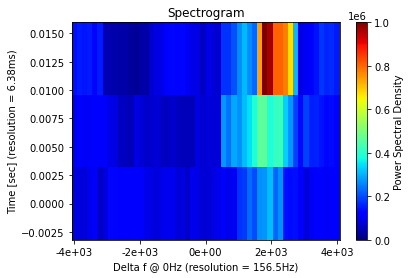

115 941.898237137571


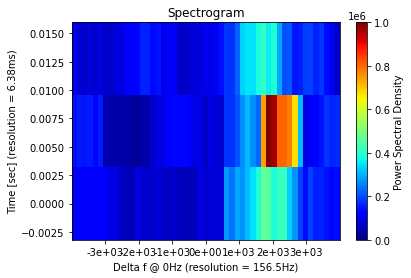

116 689.8861688406087


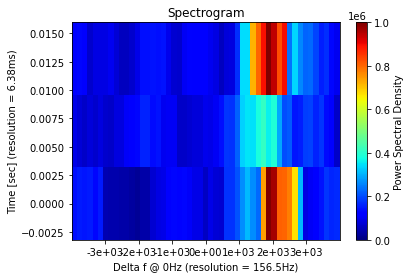

117 847.0408953172825


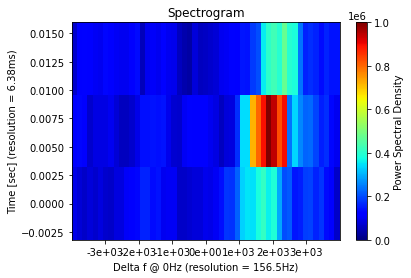

118 837.4541699125316


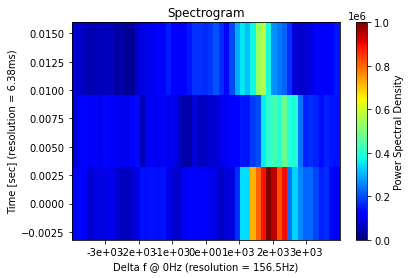

119 999.9999947220633


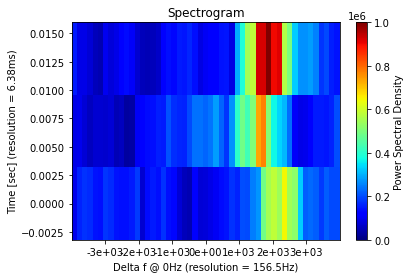

120 713.1735822320492


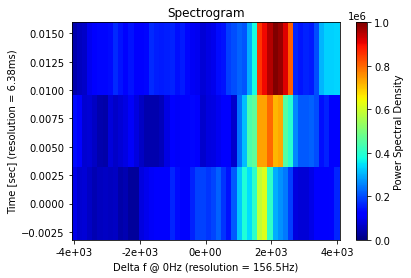

121 663.9347935444107


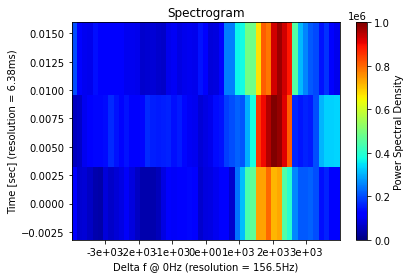

122 688.254252017015


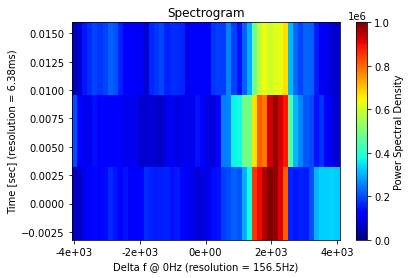

123 758.7731542005178


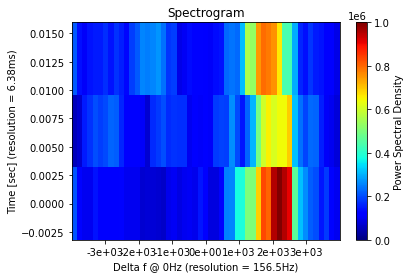

124 836.6861317519417


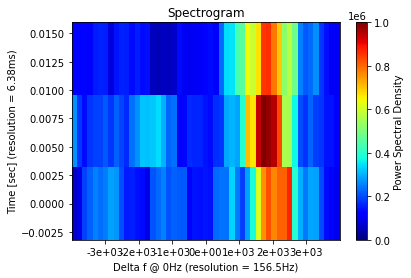

125 902.2503947529717


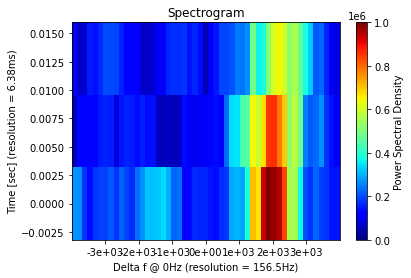

126 999.9999999812345


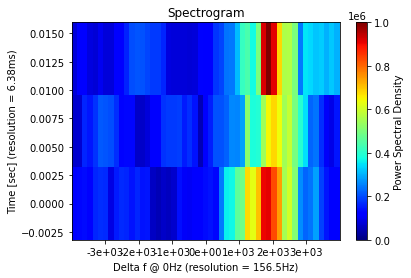

127 693.3382456443888


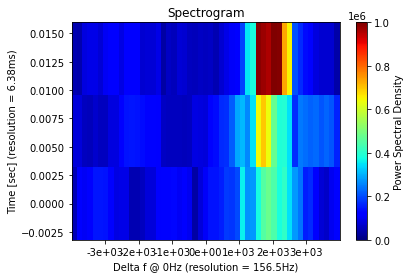

128 560.2208639721734


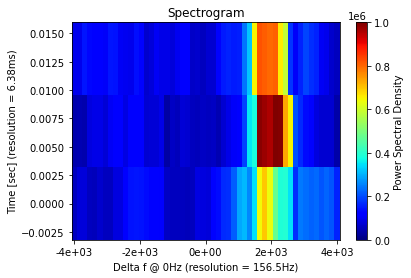

129 595.7142572429284


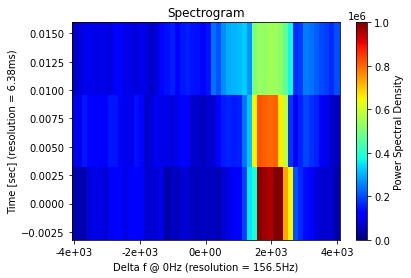

130 725.8533526127842


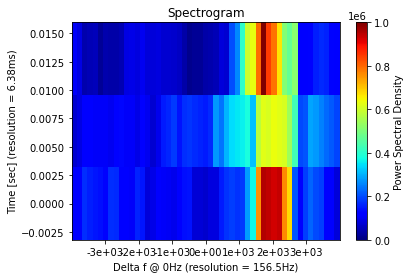

131 999.9999994387749


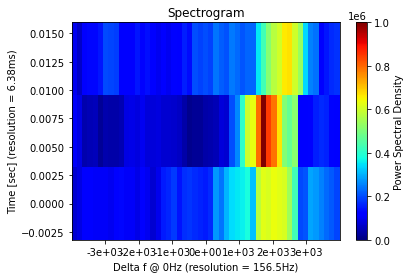

132 760.3954337527618


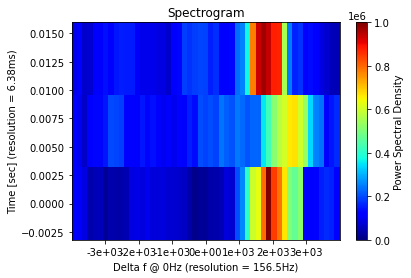

133 653.224133712201


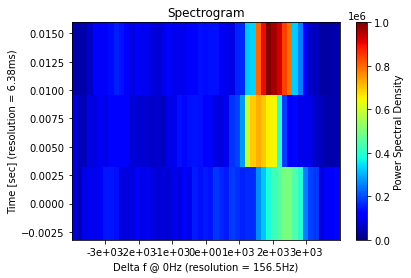

134 593.6583291873105


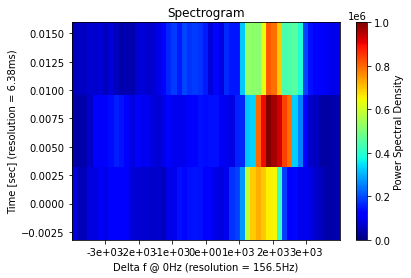

135 587.0153399783019


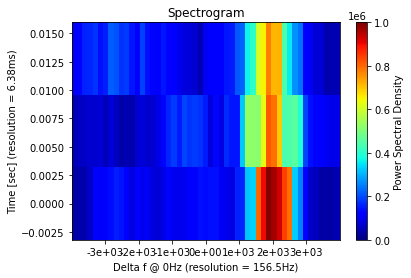

136 661.7922135413198


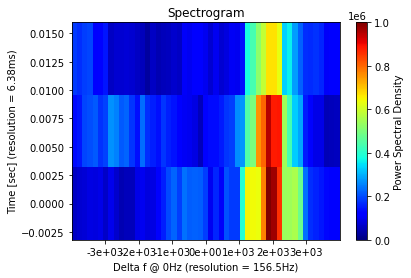

137 572.6259678361143


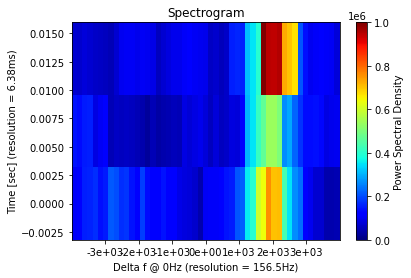

138 570.6230356298045


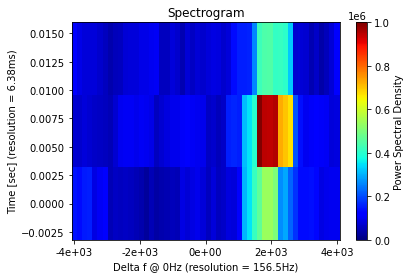

139 626.764552974635


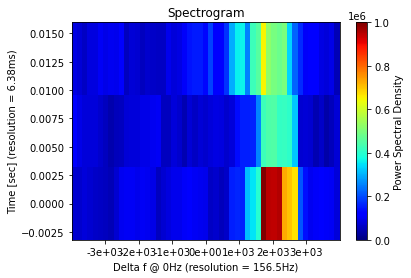

140 847.2746902447109


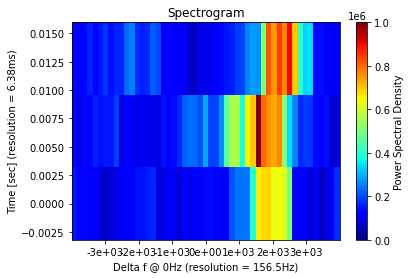

141 868.1943632213206


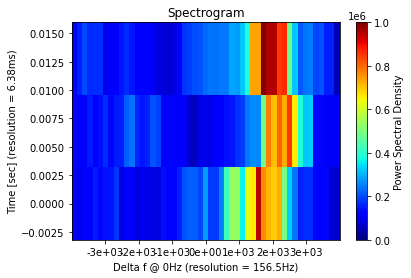

142 730.5109535988056


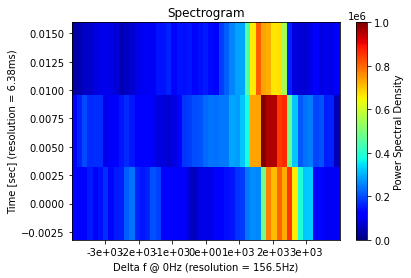

143 715.7747430828331


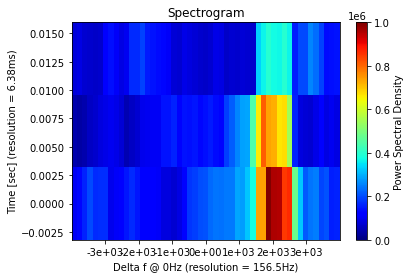

144 972.7305990184931


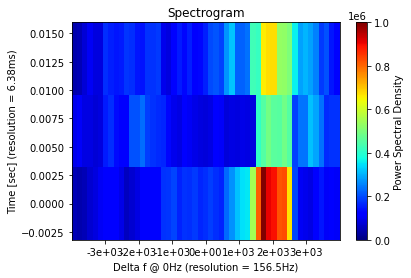

145 688.2877488410654


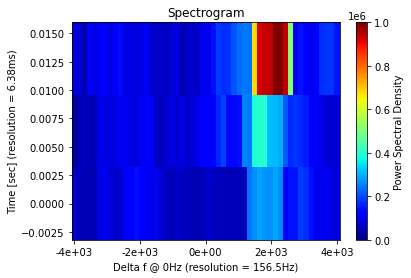

146 999.9999963697151


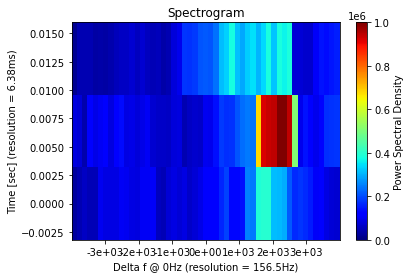

147 830.6504552707172


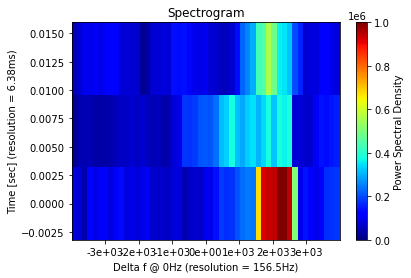

148 999.9986543565255


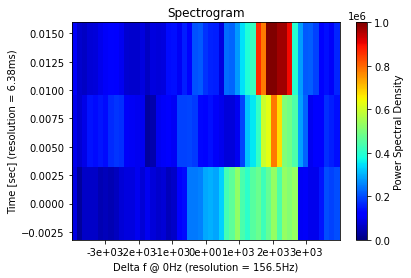

149 634.118214687421


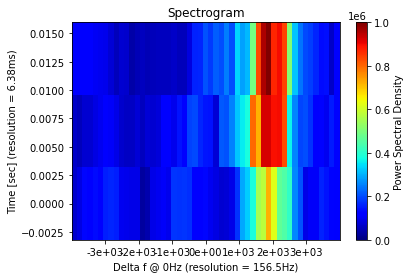

150 739.1953380743075


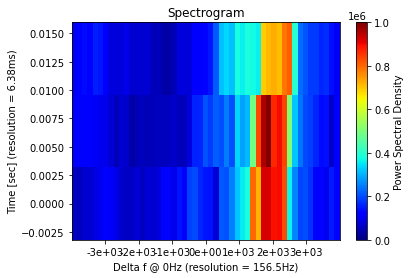

151 502.9402830445061


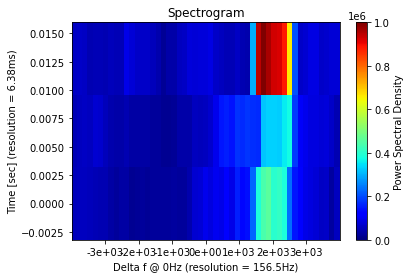

152 495.92812081734394


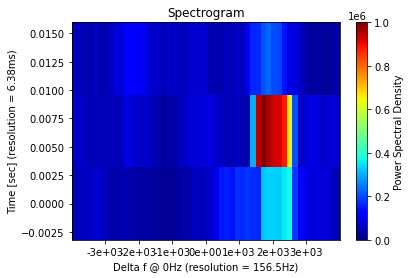

153 474.5526720312529


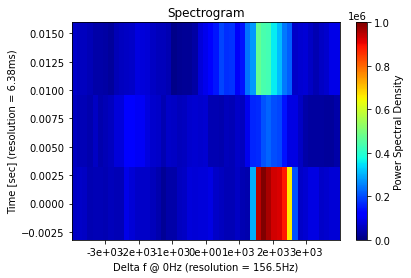

0 546.0476744592613


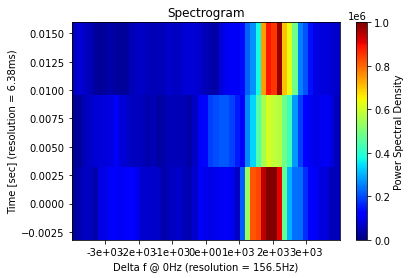

1 616.0500354419944


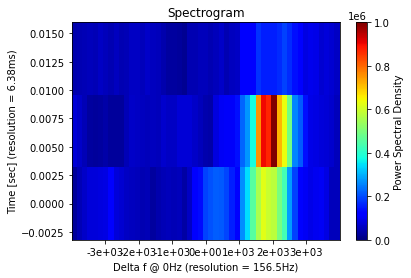

2 603.1455485109648


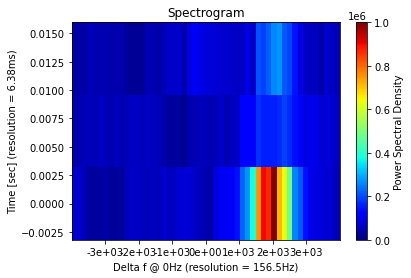

3 730.8747387838151


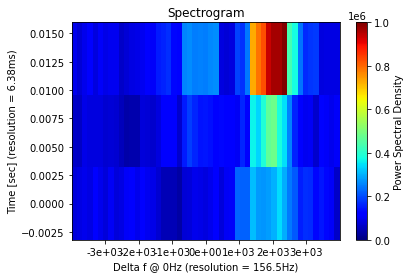

4 511.5373875151762


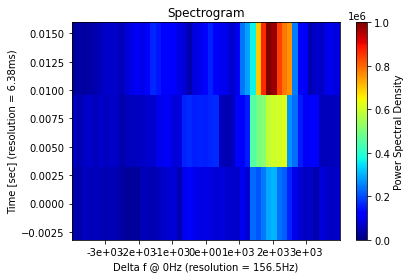

5 521.2775759844881


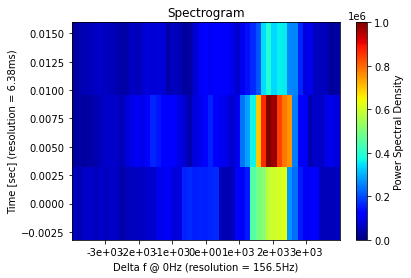

6 490.6390597400926


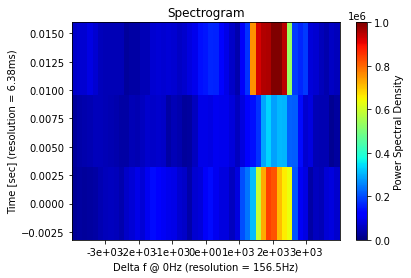

7 498.6935036424212


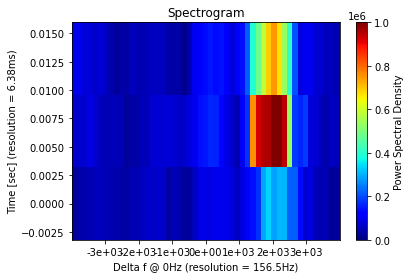

8 496.1263978675138


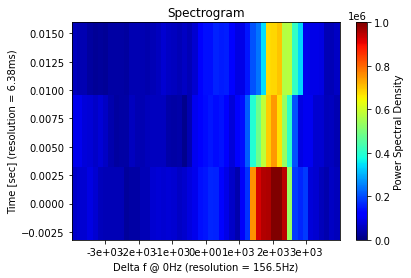

9 516.6163186345964


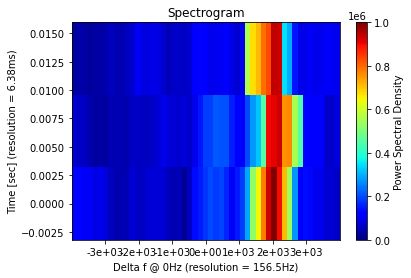

10 524.3546837623658


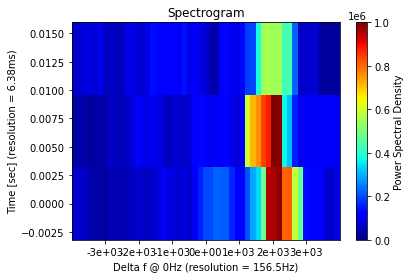

11 529.4376734878643


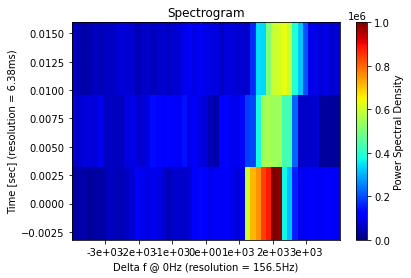

12 495.6947214034668


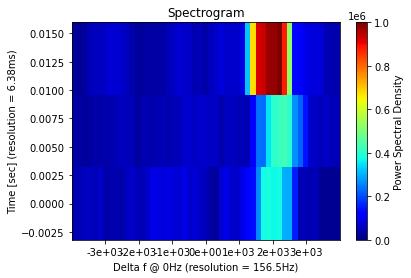

13 500.99021560846455


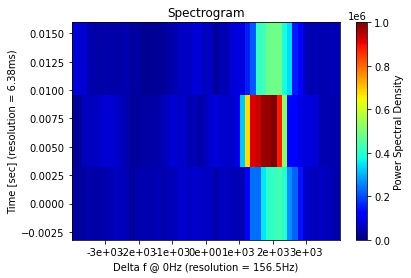

14 500.45908123357333


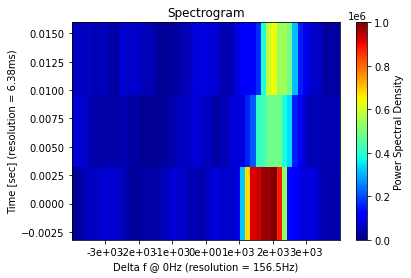

15 533.2068990604212


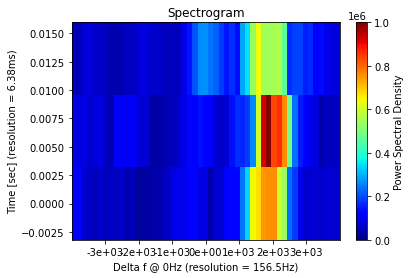

16 610.5390611946077


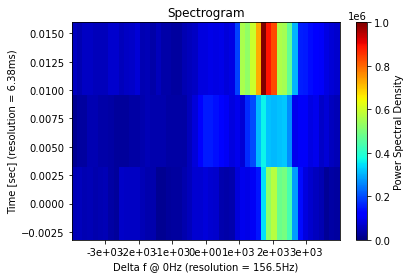

17 602.3715488804642


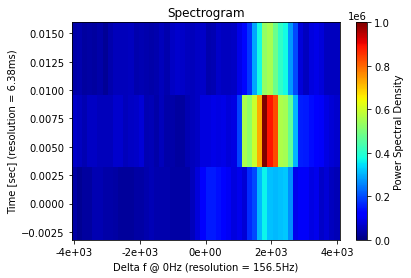

18 593.2500534439234


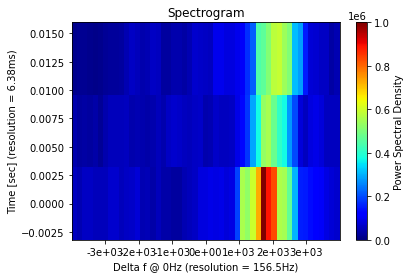

19 523.2044987871207


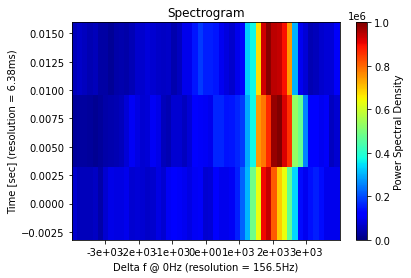

20 504.2750717187464


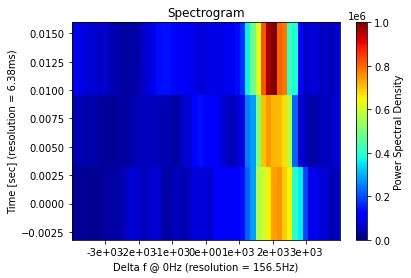

21 478.8953118328632


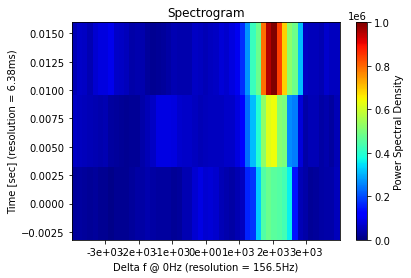

22 505.5982288506863


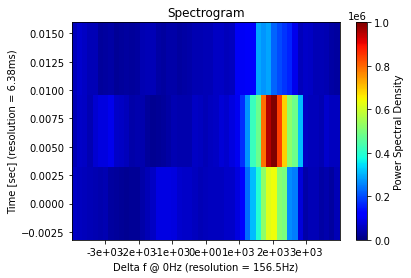

23 485.9293068403638


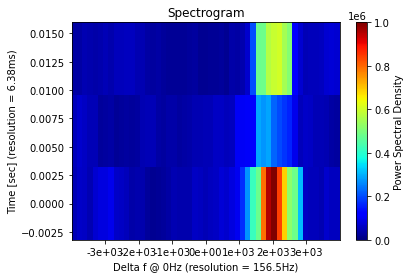

24 487.025182877224


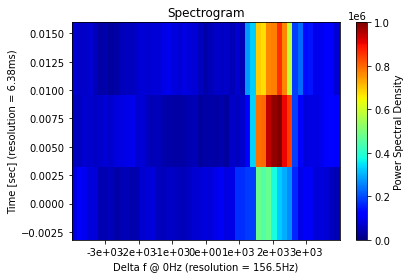

25 486.2576613371855


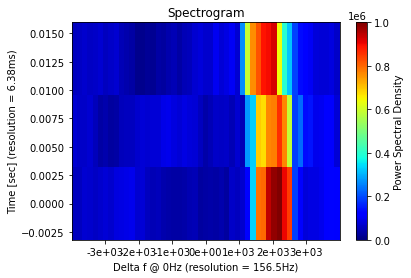

26 498.41102883476657


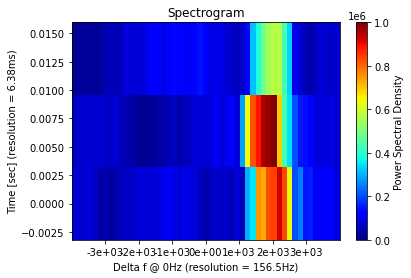

27 504.0153973316148


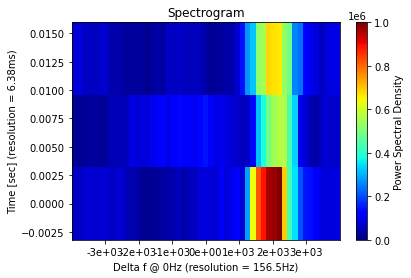

28 538.5380567695596


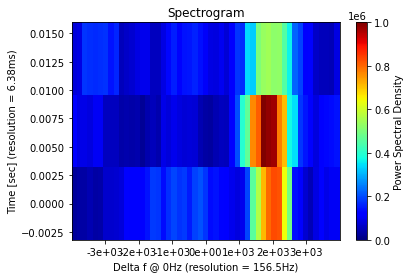

29 513.9388179948623


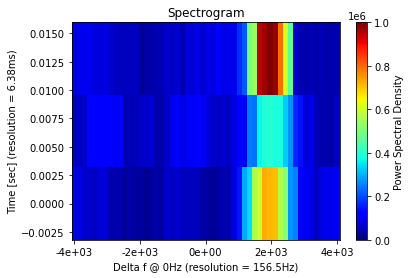

30 508.4563219979405


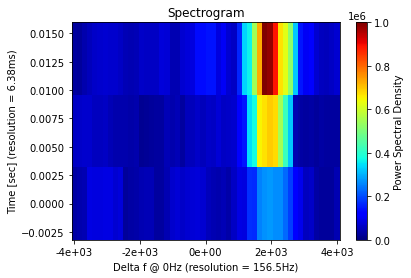

31 526.6813148725353


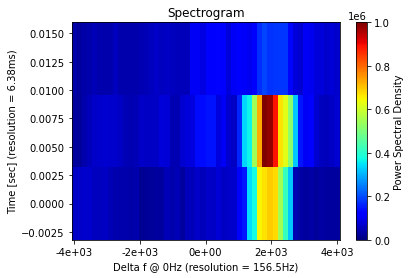

32 532.8824632534447


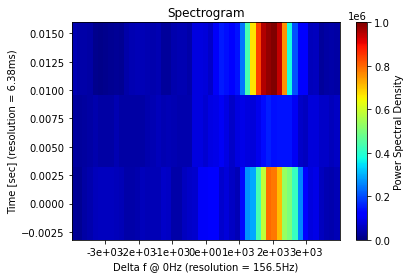

33 531.5417009642233


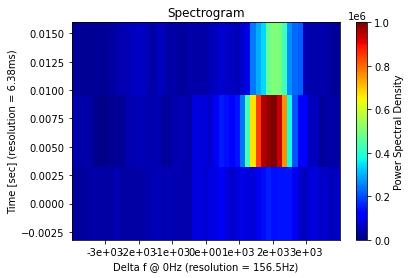

34 504.57319697630163


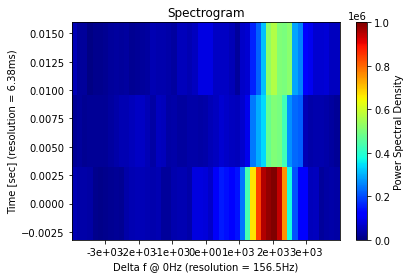

35 466.02636270126504


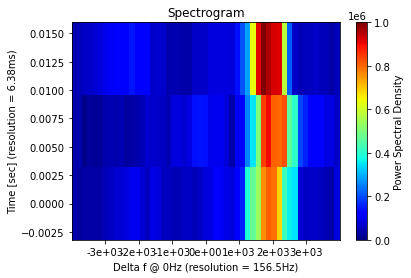

36 499.2154982207141


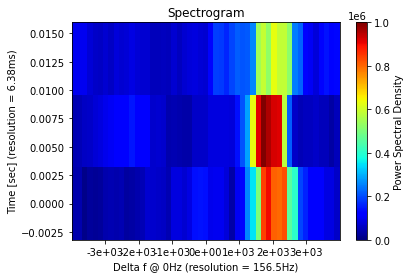

37 512.14077514785


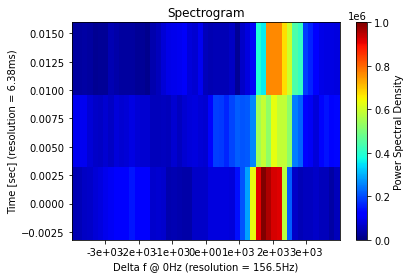

38 657.2291809863866


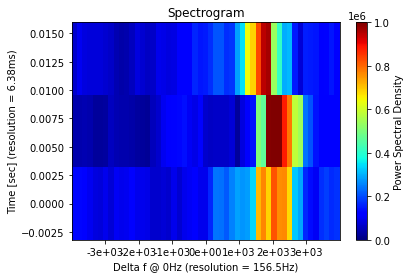

39 468.89885998812895


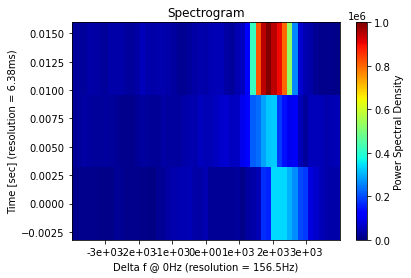

40 450.37978342418876


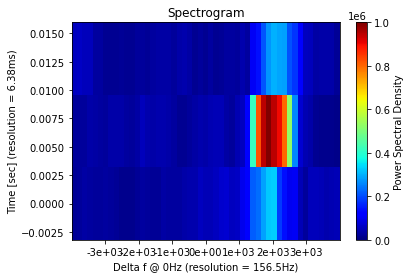

41 439.11315479949235


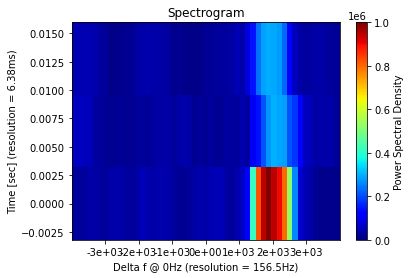

42 528.4267263998671


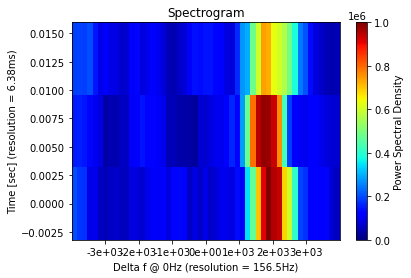

43 566.5962894132605


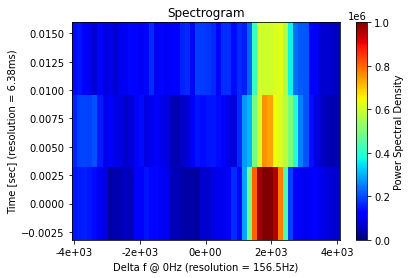

44 592.5345717205639


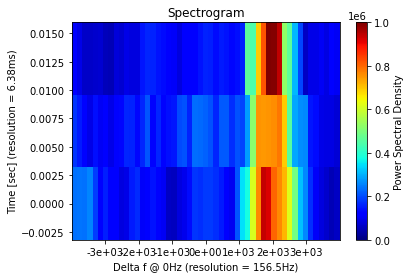

45 465.7945808736839


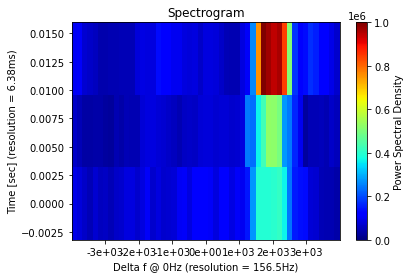

46 448.63896770614633


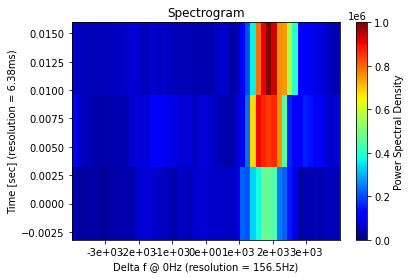

47 461.6316114757162


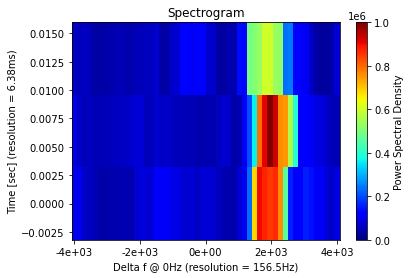

48 501.8427918354931


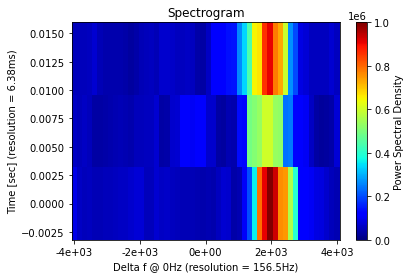

49 536.5515088771841


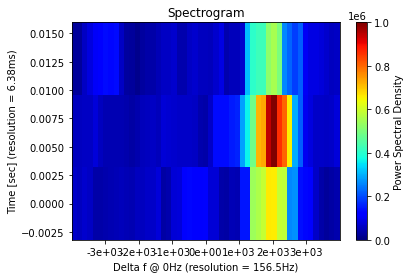

50 581.2805353763911


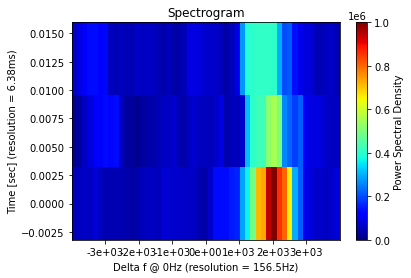

51 450.7553605163183


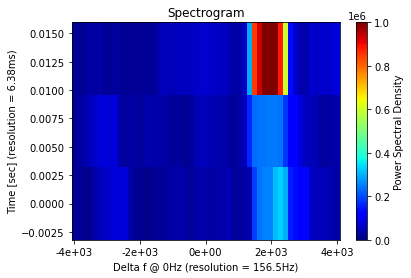

52 461.6528969658764


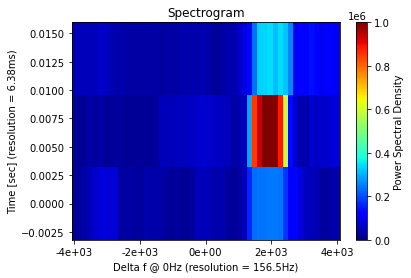

53 452.6038149685197


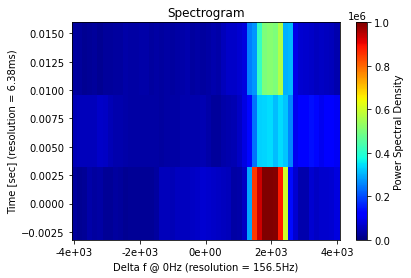

54 488.71371742443046


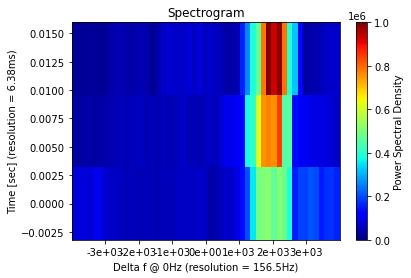

55 449.3970556658461


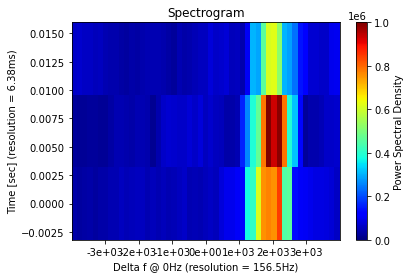

56 443.5427382629457


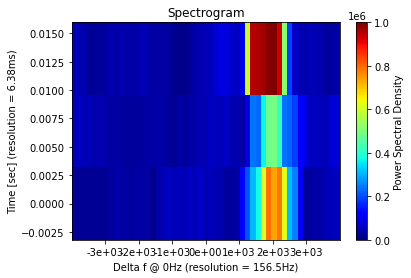

57 463.2120041077793


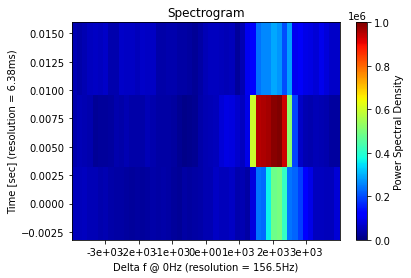

58 508.95580110802644


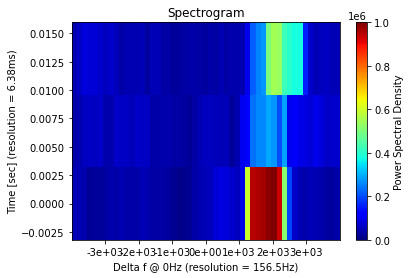

59 541.1844404076589


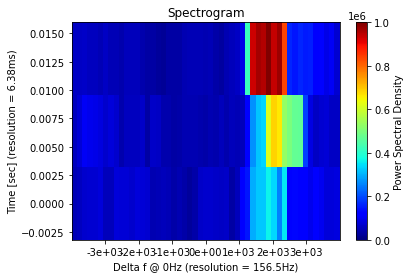

60 566.6687098132045


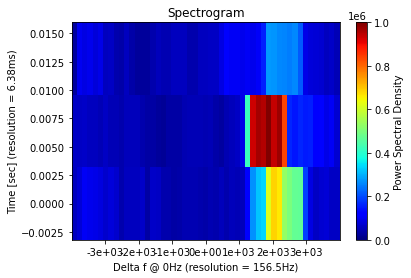

61 518.5387654850249


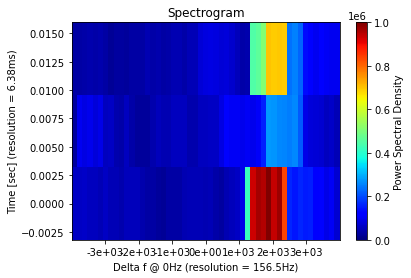

62 555.6262638699106


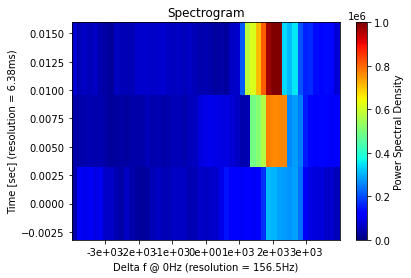

63 522.6519147699946


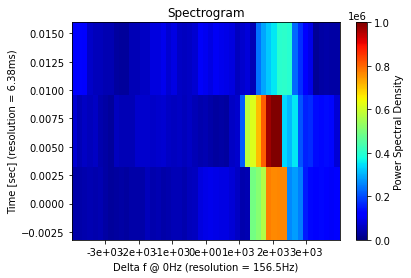

64 519.8728924844058


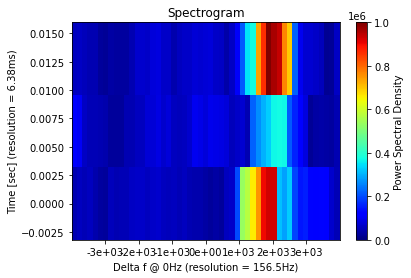

65 514.2152208348396


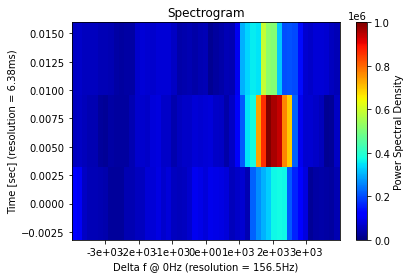

66 490.794299446885


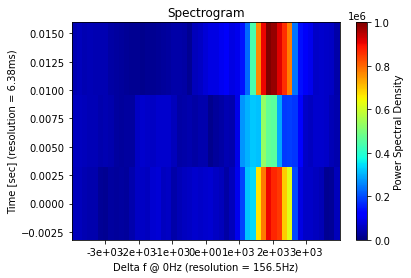

67 522.3832780826226


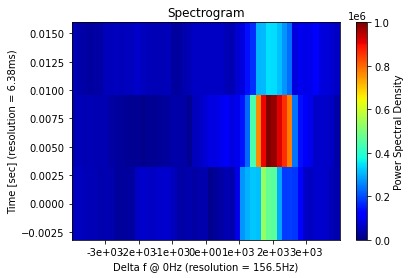

68 493.4812715772431


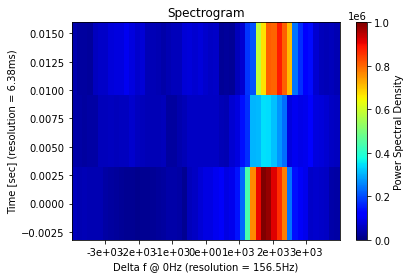

69 544.1975142452259


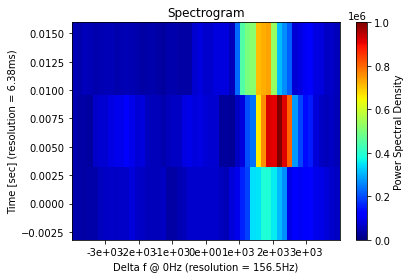

70 528.7604533881128


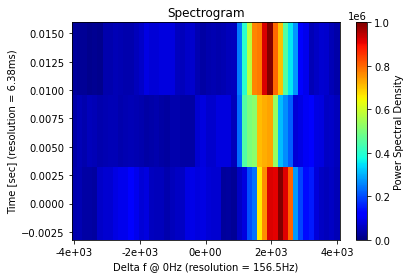

71 491.8388807322745


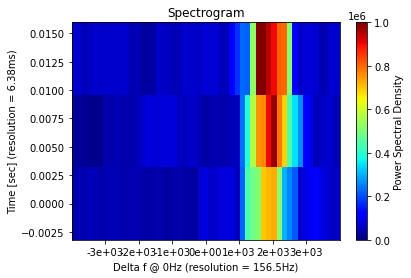

72 514.2401457483718


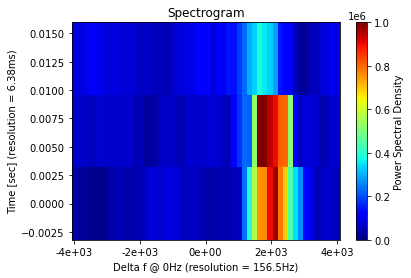

73 537.5197492541374


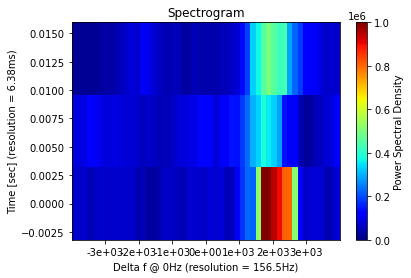

74 642.6762391812439


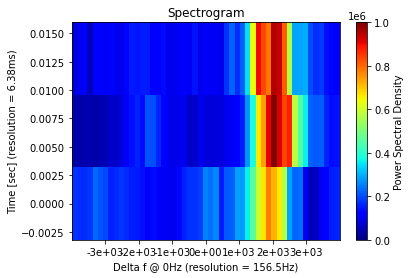

75 601.3187372938401


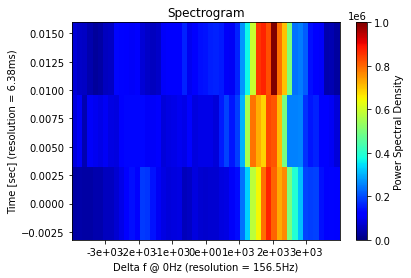

76 552.1958756382186


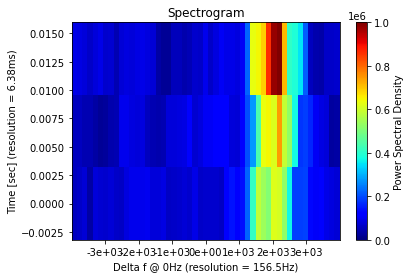

77 539.8113477267491


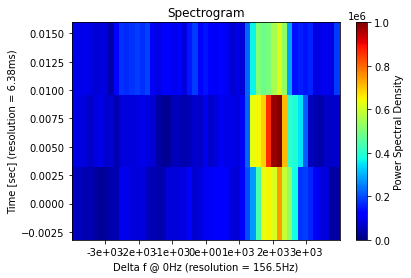

78 540.9855482257365


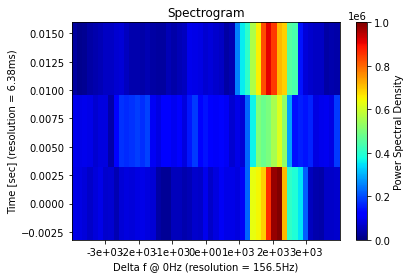

79 580.9896796399987


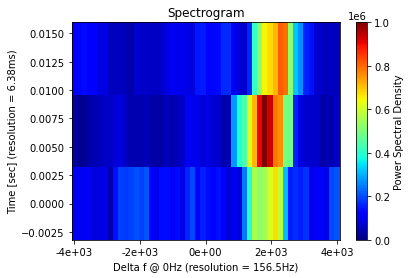

80 625.5932021991896


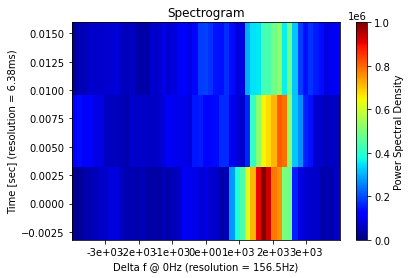

81 615.7026534219709


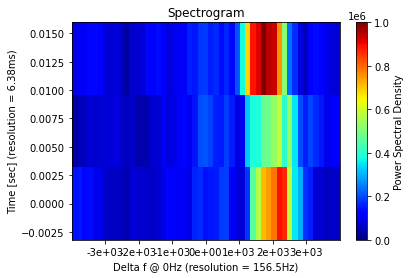

82 563.4394688378263


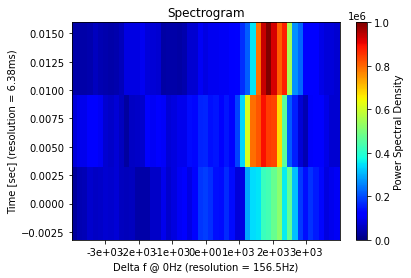

83 489.982068415107


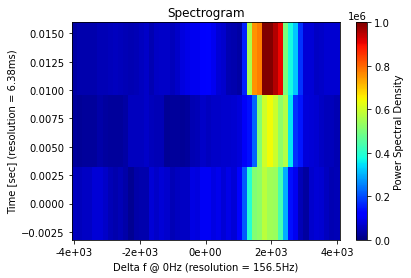

84 484.1140735055019


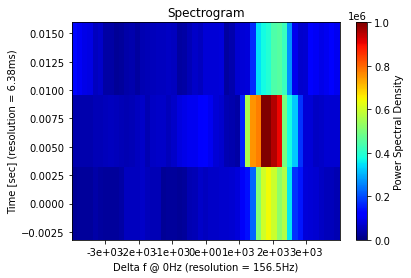

85 502.3600759469517


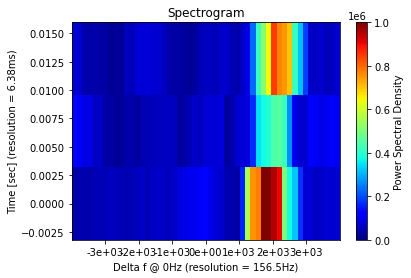

86 496.85987714222455


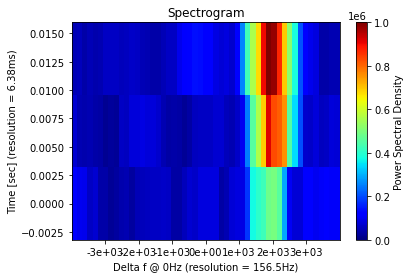

87 483.8256453727789


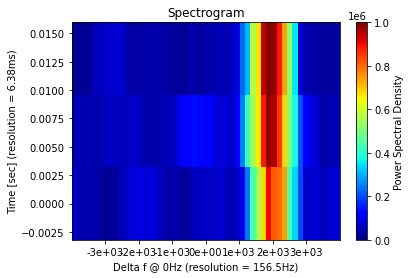

88 495.66968597152476


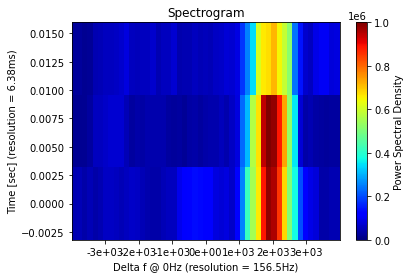

89 477.0124695157599


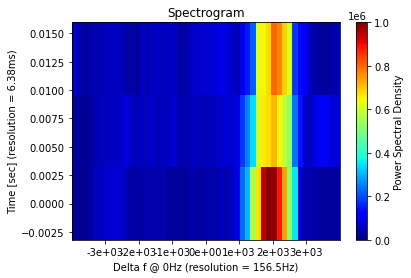

90 524.0051843100475


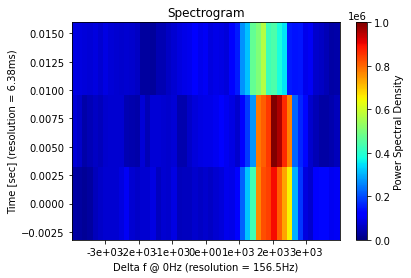

91 581.1250998913706


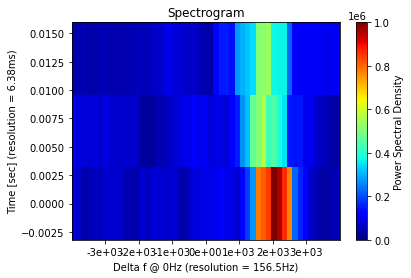

92 673.1016651705493


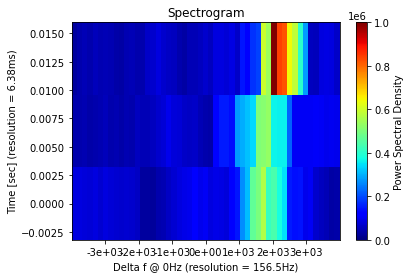

93 695.0835193552698


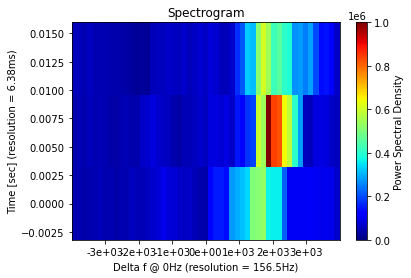

94 597.2612610377874


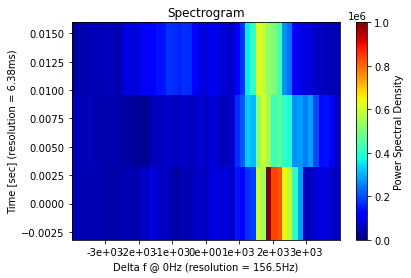

95 636.477099879375


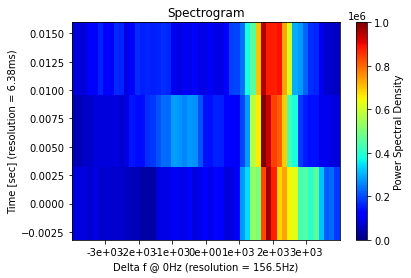

96 493.1076750160817


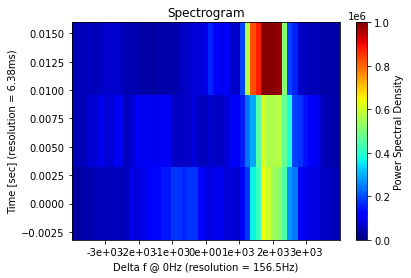

97 496.4551172877772


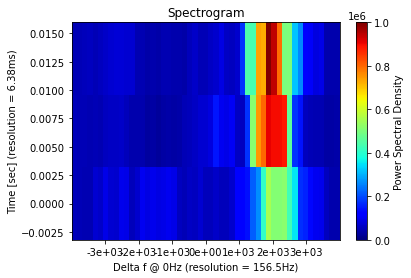

98 490.62688209644017


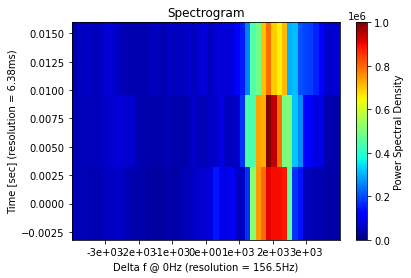

99 564.7749234133735


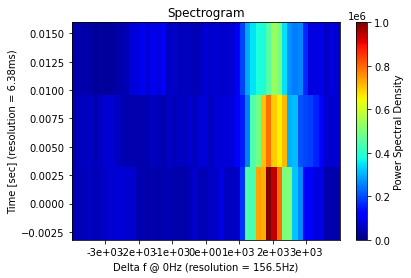

100 583.0703916532818


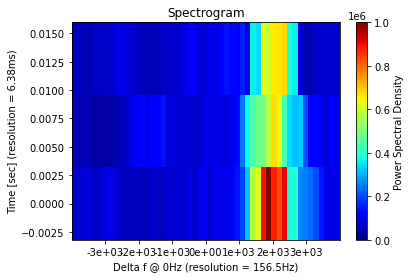

101 541.9182517928888


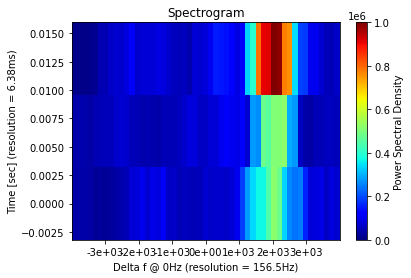

102 525.844514947318


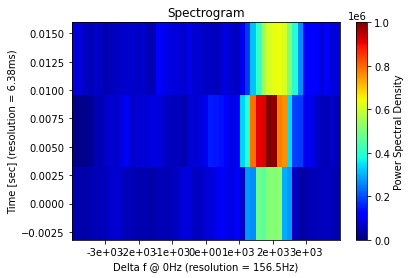

103 566.5011424042375


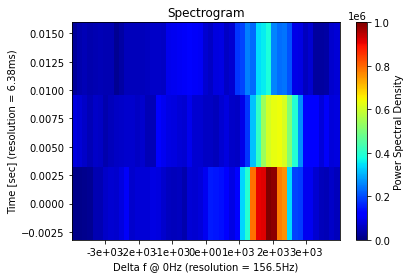

104 695.2201770388297


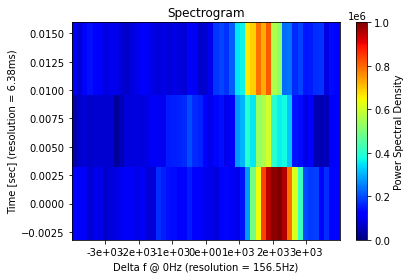

105 769.9150654415005


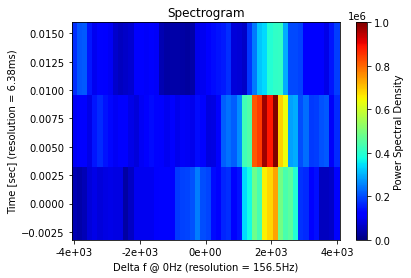

106 681.463750508881


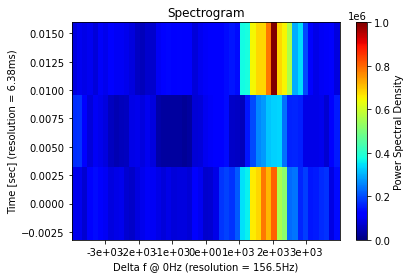

107 581.842255057654


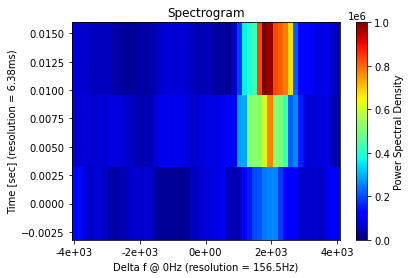

108 609.8035103035359


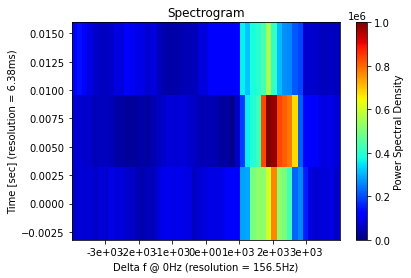

109 575.4776834563431


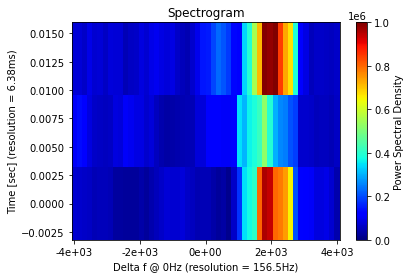

110 603.2151605143648


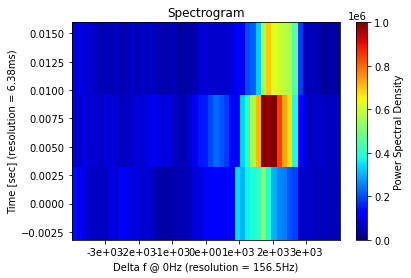

111 540.4052429751466


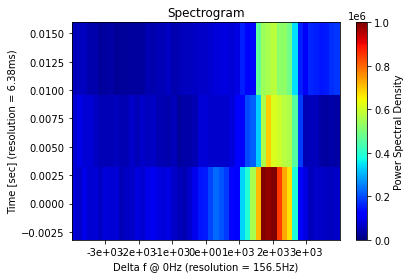

112 538.0126799692424


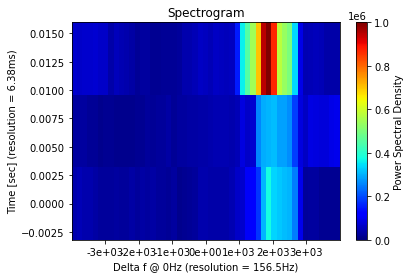

113 533.913482923889


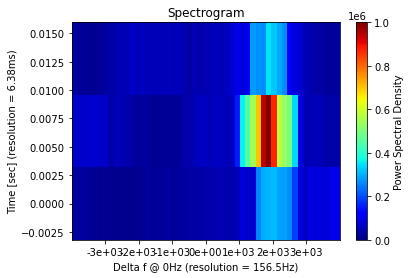

114 534.4913941534203


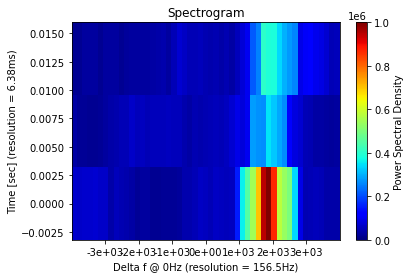

115 565.329620153943


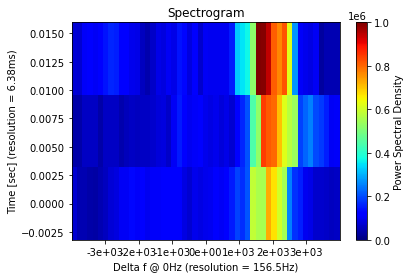

116 572.9151884174953


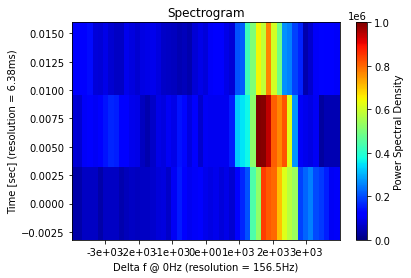

117 588.3768968457587


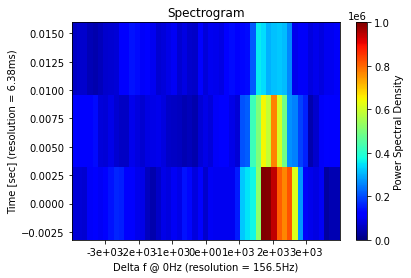

118 588.1247297638936


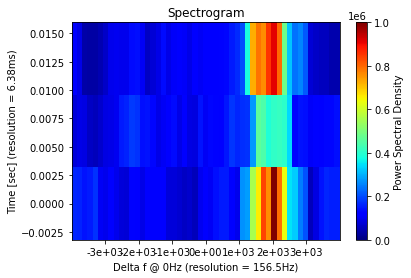

119 562.6976829729867


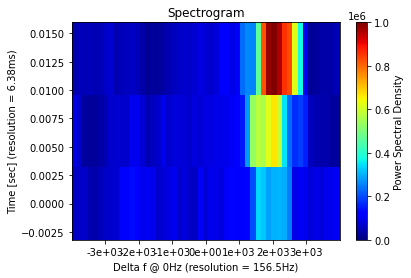

120 517.1229333623755


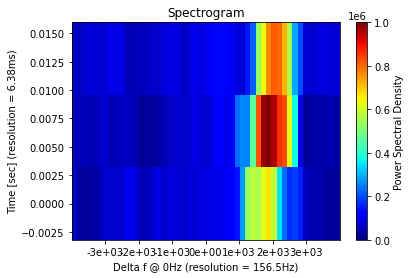

121 488.4038867324657


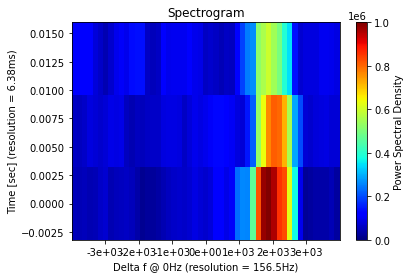

122 484.4118142527516


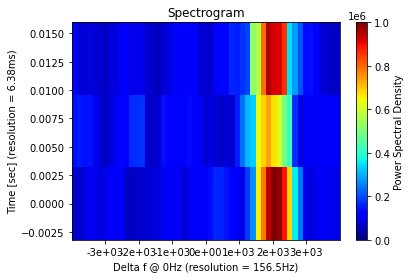

123 473.05018373750806


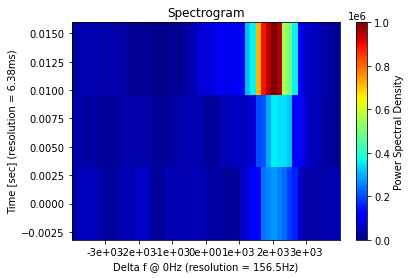

124 459.8602270685843


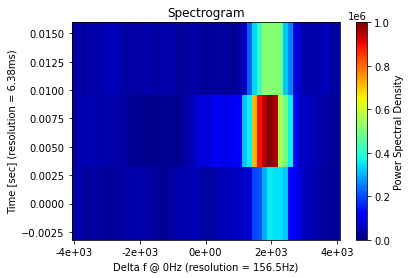

125 453.8421413835947


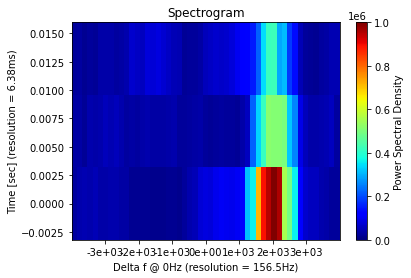

126 477.1566890787293


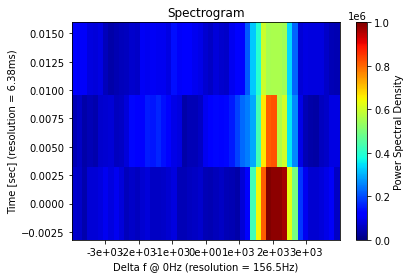

127 547.1931522993881


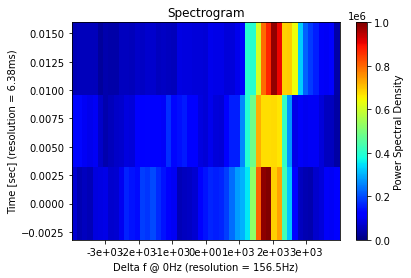

128 586.9021934934781


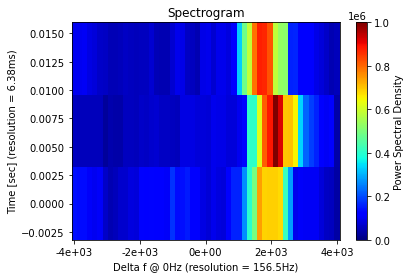

129 638.0231160684386


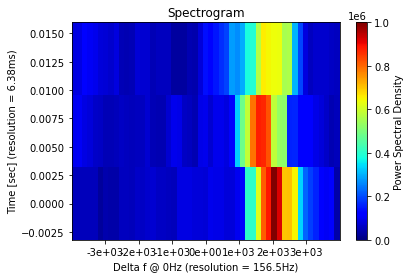

130 656.0007818381455


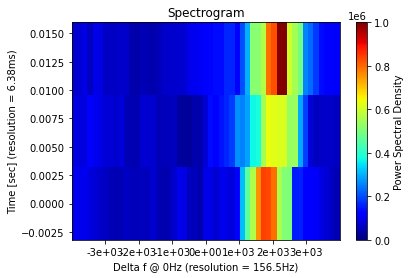

131 574.9707247317158


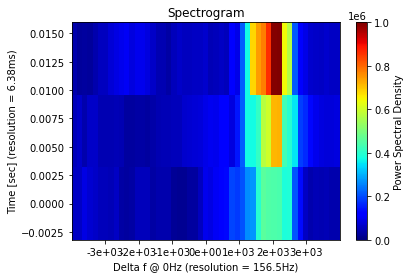

132 520.7140147051509


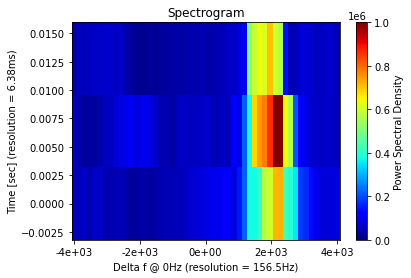

133 481.6009245873023


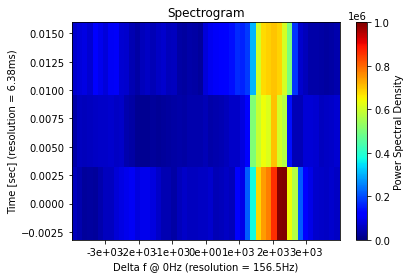

134 492.3573376850159


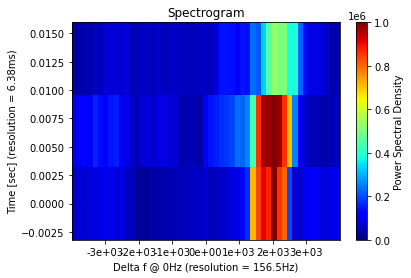

135 563.2445410359642


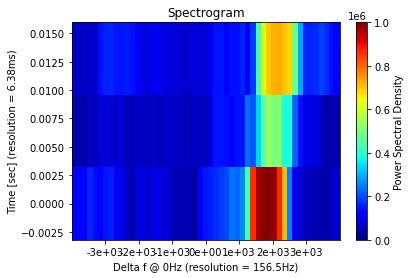

136 547.0029442171383


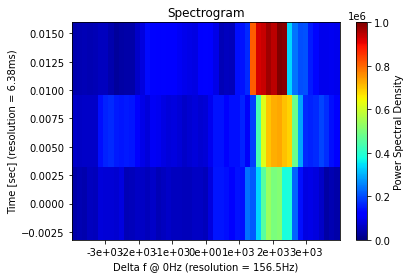

137 558.7931407555113


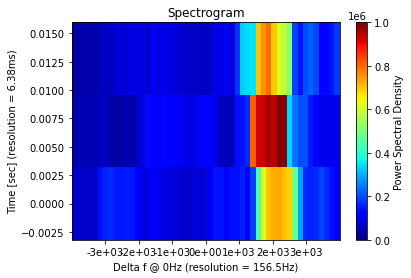

138 504.2006802140014


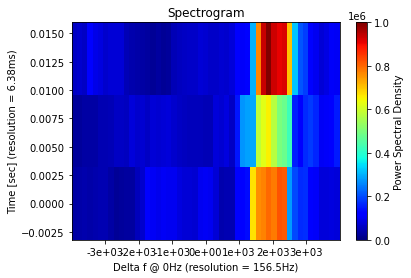

139 531.2996079229637


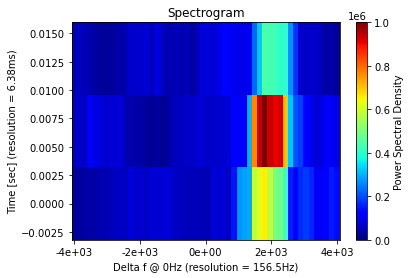

140 469.6366557429284


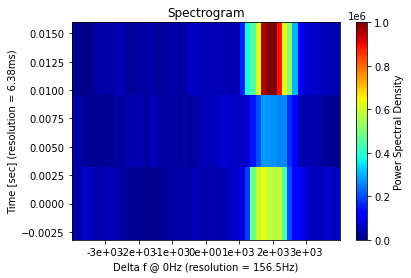

141 478.87031226964234


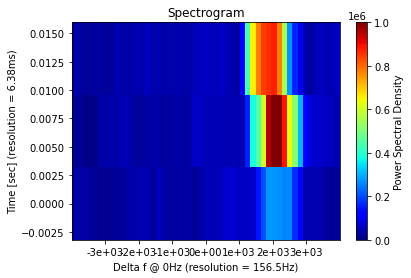

142 489.1516165180302


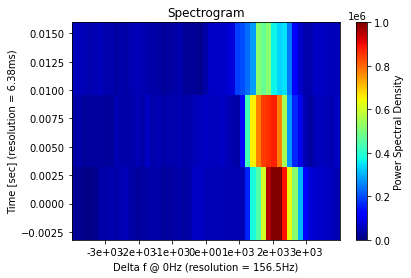

143 488.15024725149715


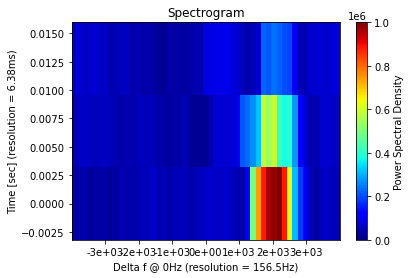

144 588.2013763033444


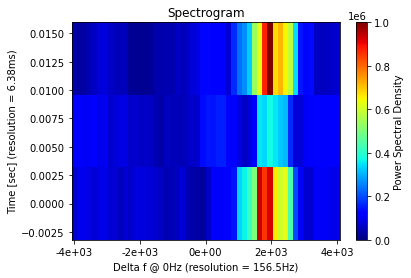

145 686.9526150930176


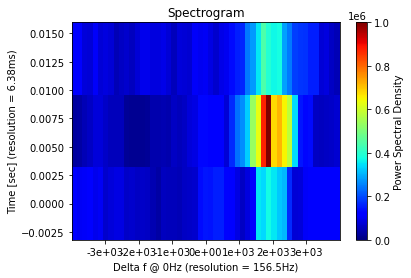

146 629.6596458171921


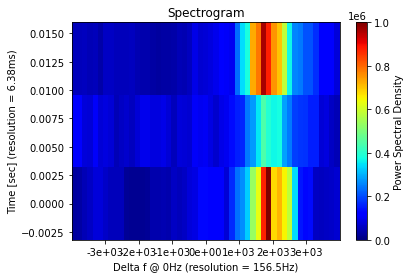

147 560.0836831520867


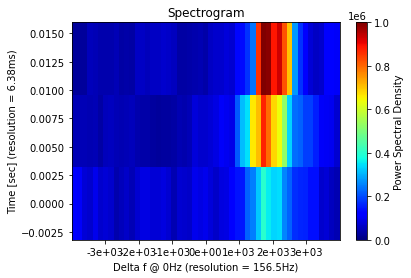

148 493.0360314729365


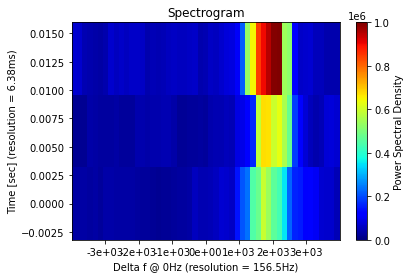

149 492.34010818940783


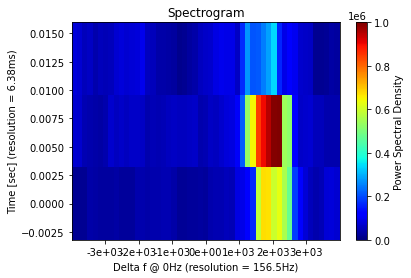

150 521.3808725786603


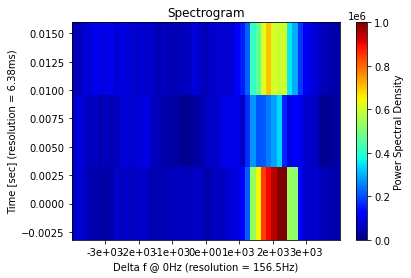

151 614.2196455499897


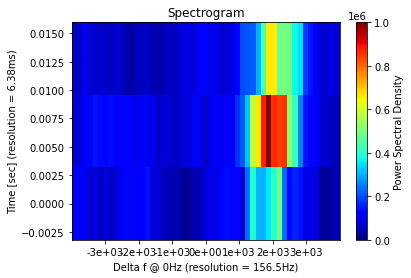

152 527.1678039738038


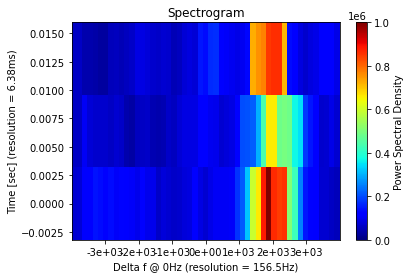

153 497.62295171148844


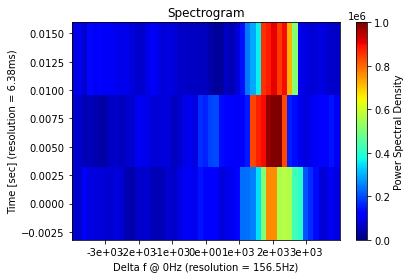

0 710.3225178906405


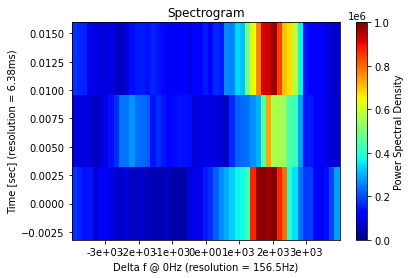

1 667.4910477487292


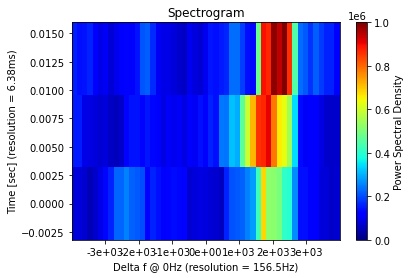

2 701.751925831127


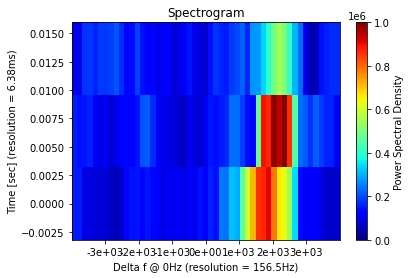

3 541.7924457703194


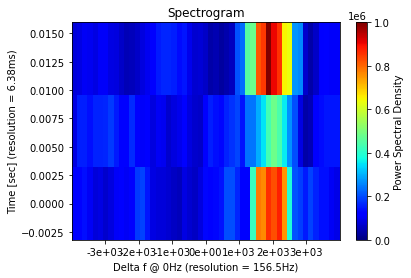

4 568.4195780361018


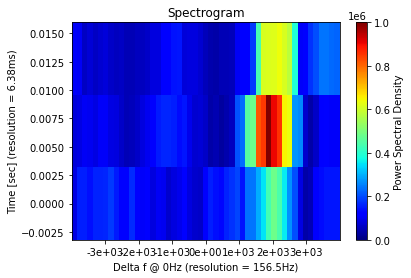

5 540.6987055343579


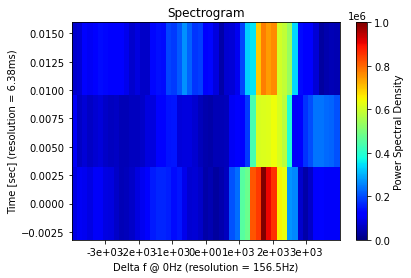

6 651.844709735075


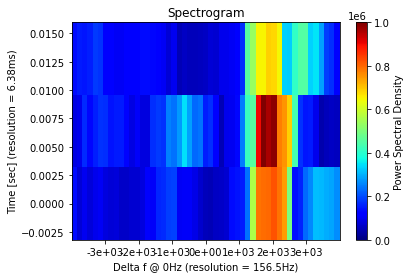

7 555.279210495057


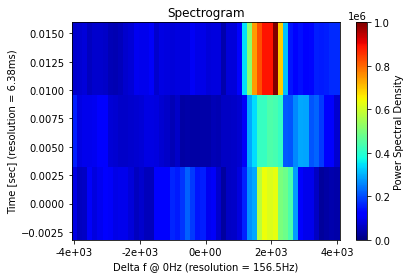

8 566.3047915416148


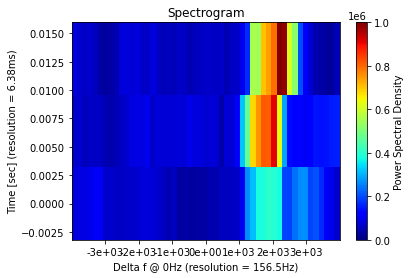

9 596.1154103917718


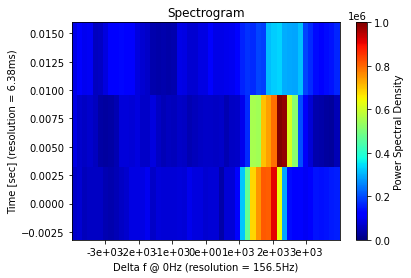

10 528.0610126540887


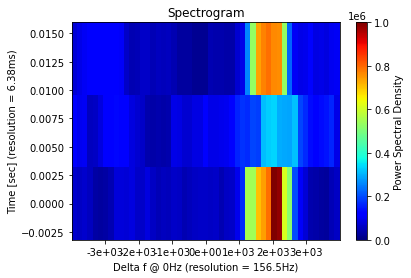

11 543.4266085679196


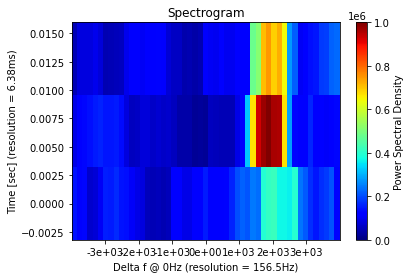

12 510.4046948829268


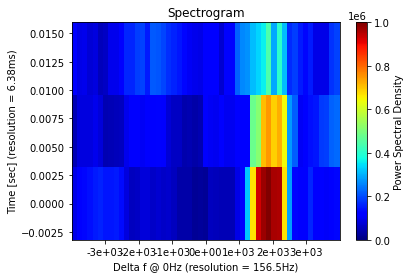

13 504.044825833911


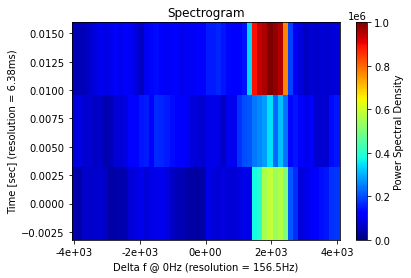

14 551.4380343438934


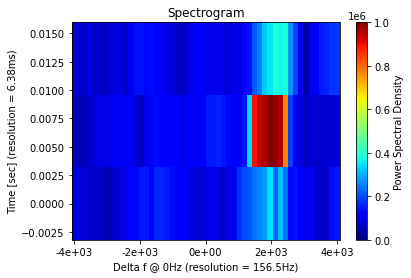

15 470.3266364792071


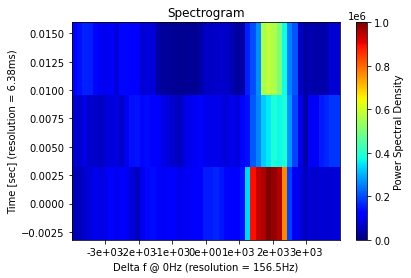

16 604.5552835646487


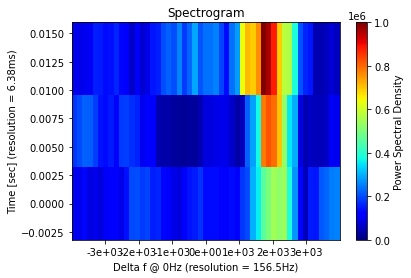

17 563.8285625711051


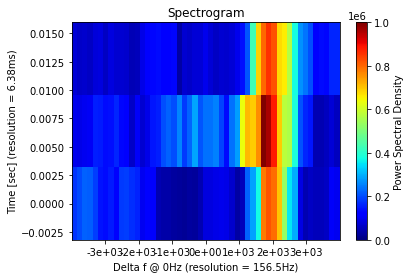

18 655.4683941544072


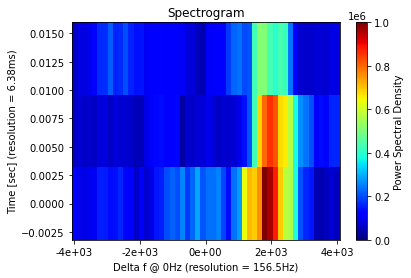

19 655.5590852528735


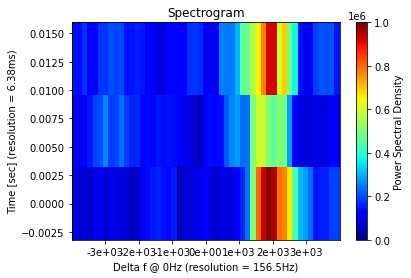

20 617.9629964436145


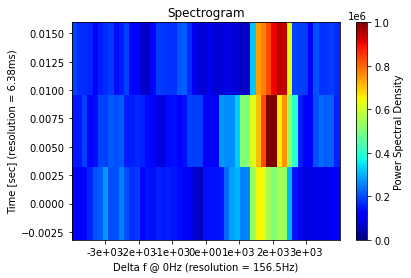

21 681.5423117271127


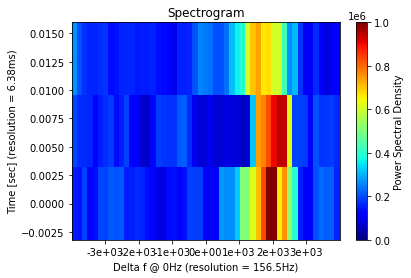

22 613.9352599684466


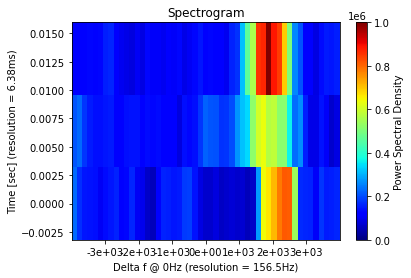

23 569.887779382464


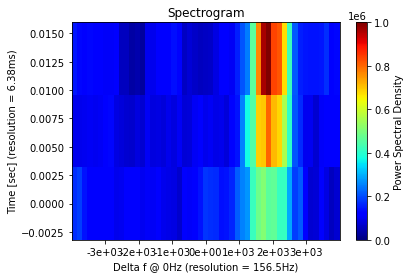

24 486.89890305520396


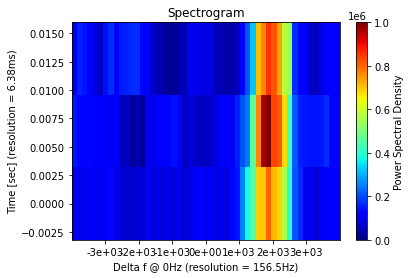

25 498.51039585541014


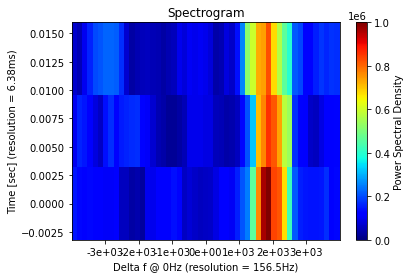

26 558.0371662064256


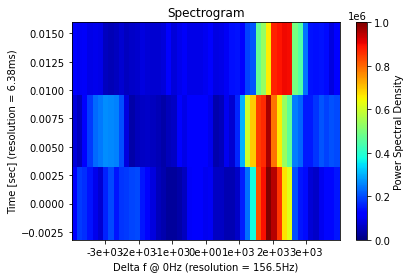

27 559.6410566792547


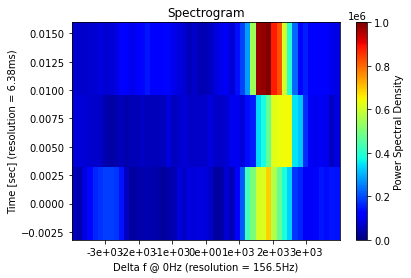

28 487.16105080804846


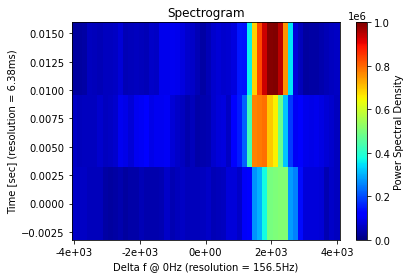

29 479.11437553176063


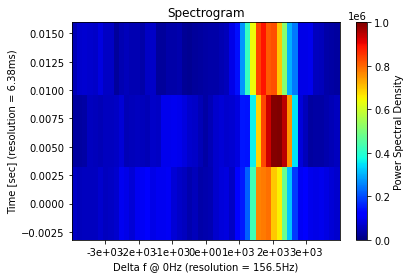

30 486.9306839423223


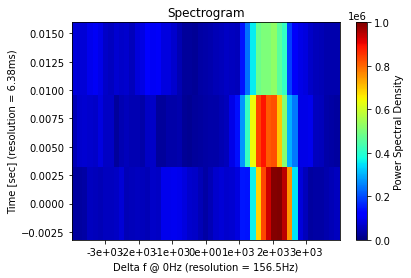

31 495.88462635875413


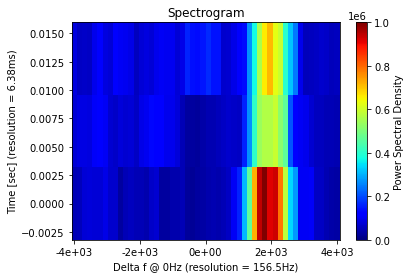

32 530.691224538558


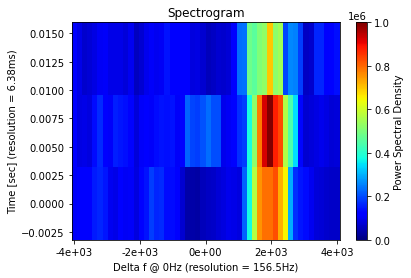

33 667.0426706884847


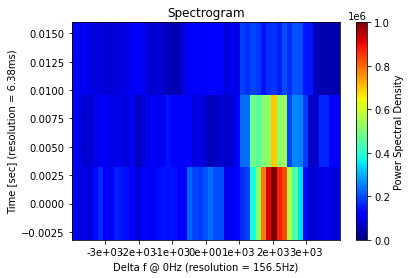

34 999.9999998325543


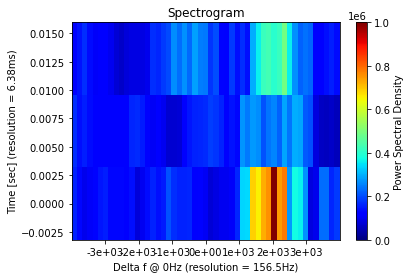

35 999.9999998701579


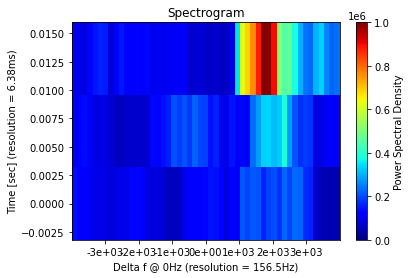

36 999.9999978297774


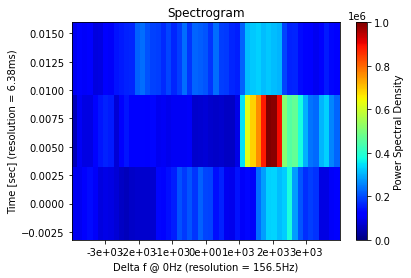

37 749.9403949062159


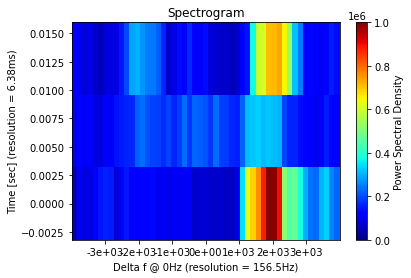

38 999.9997534009588


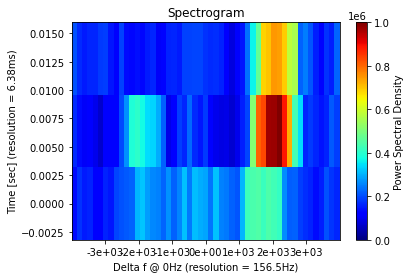

39 586.9986476870034


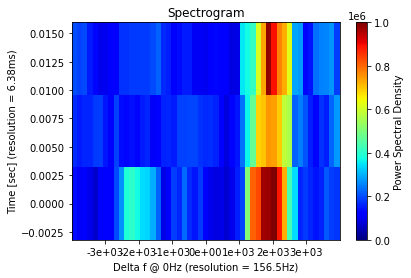

40 652.6840176250464


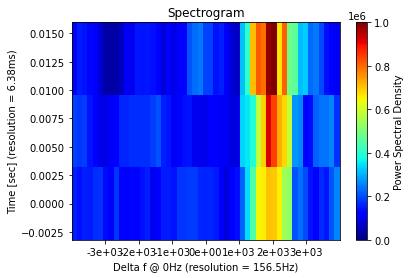

41 580.084378415077


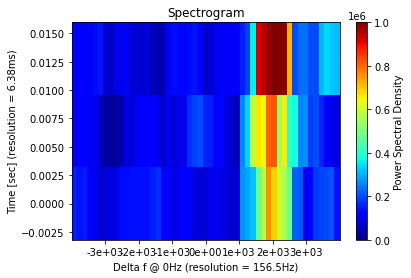

42 757.0011149566855


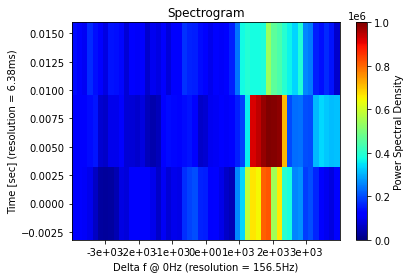

43 999.9999985349865


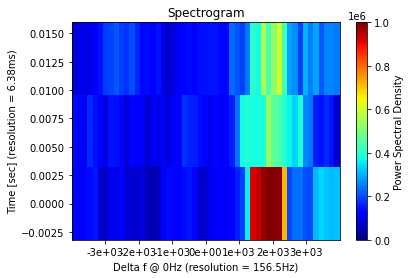

44 640.9329280957809


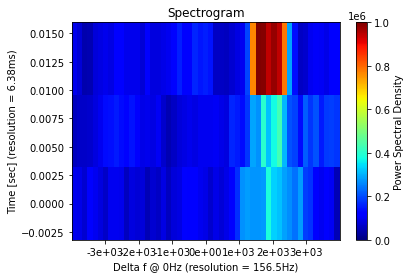

45 609.1323534359406


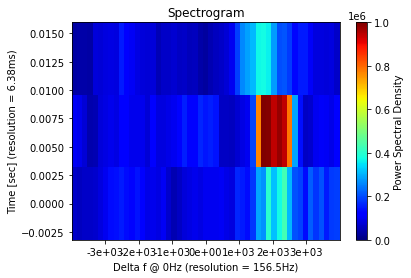

46 592.4497309466528


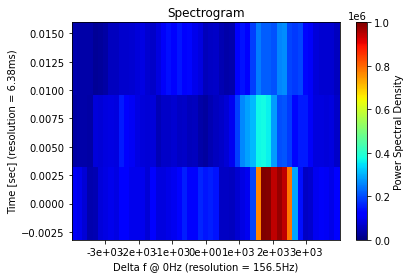

47 999.999999748926


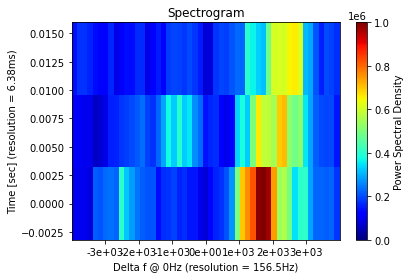

48 886.6423565775376


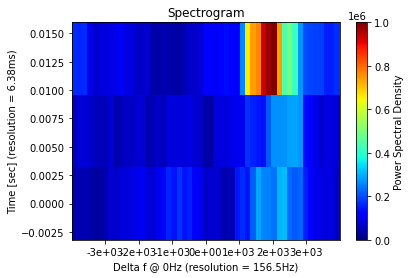

49 665.9070152812903


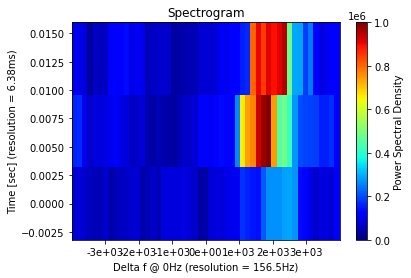

50 584.8191888915311


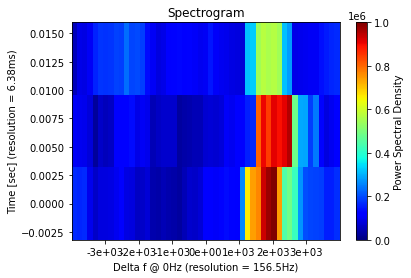

51 669.9248628418356


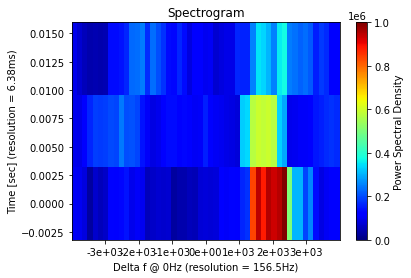

52 999.9999998216787


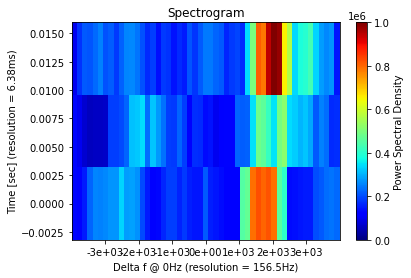

53 999.999998177191


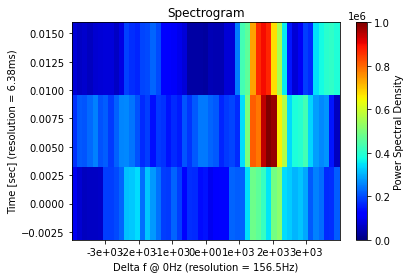

54 531.5828280349072


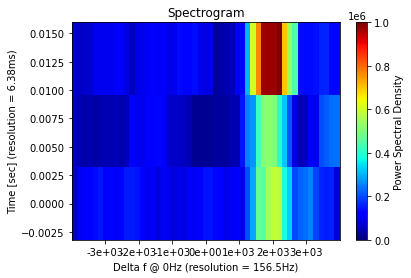

55 999.9999997620931


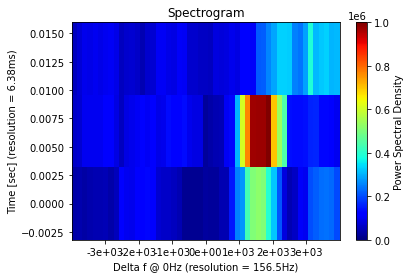

56 909.0440030360961


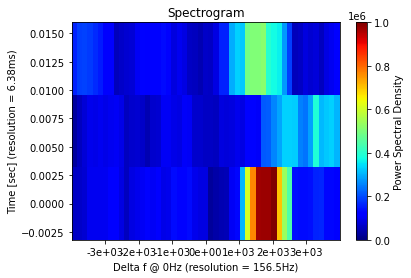

57 999.9999994232758


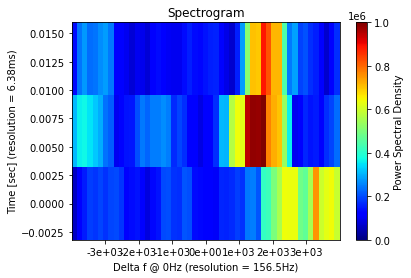

58 606.5266693504134


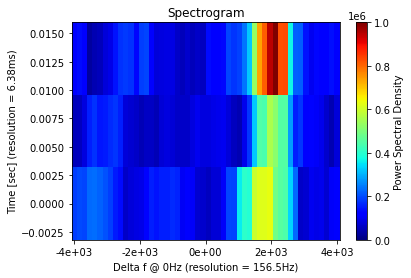

59 550.3120433144618


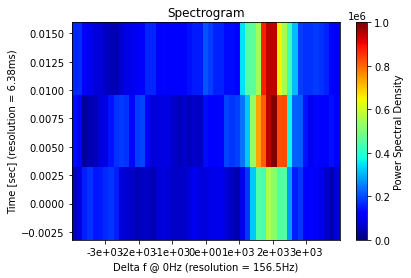

60 560.7066903159123


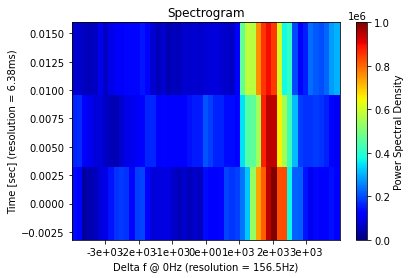

61 646.9251486249777


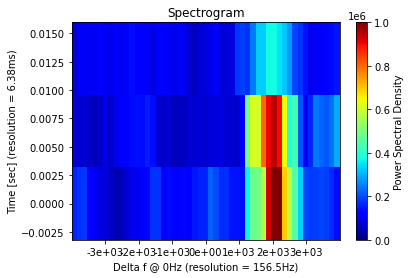

62 999.9999998680604


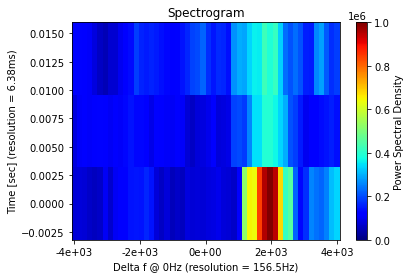

63 697.6376535046414


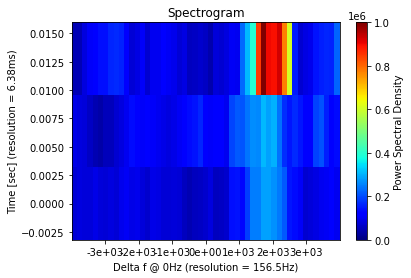

64 745.5814906676443


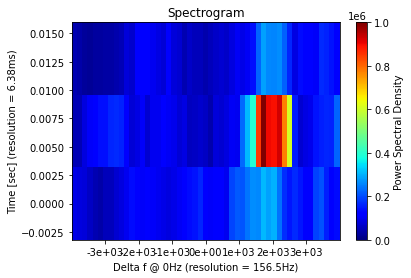

65 576.4284771086907


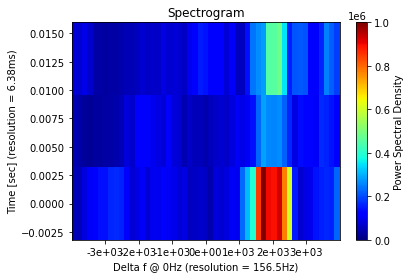

66 999.99999925758


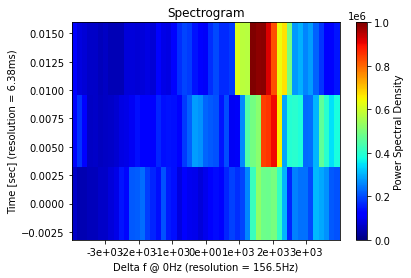

67 646.7977306046321


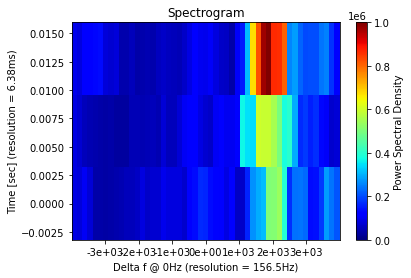

68 581.718154234999


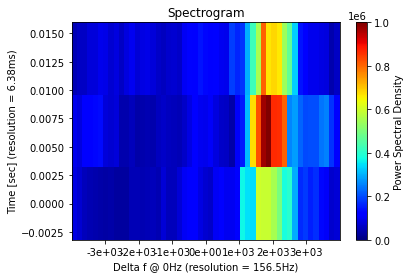

69 587.7405227624117


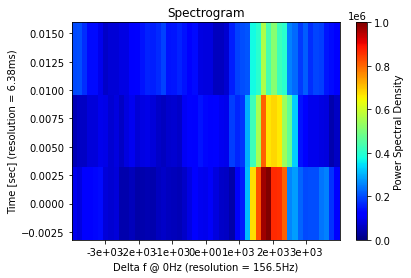

70 926.6209071819941


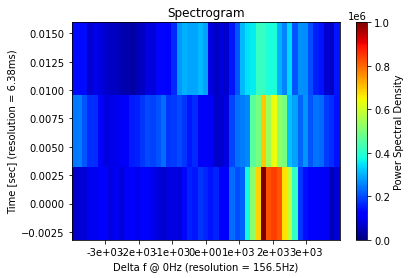

71 999.9997589648301


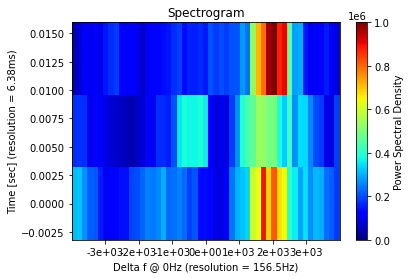

72 658.1650442679479


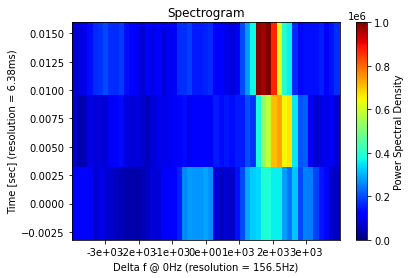

73 495.2675858993635


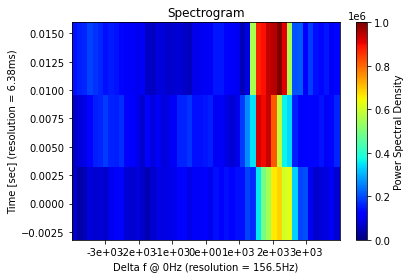

74 549.9910022742326


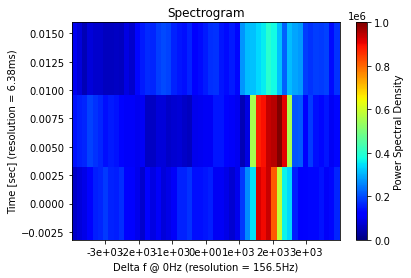

75 710.7478911876619


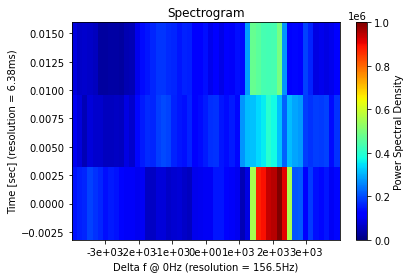

76 723.5990054839411


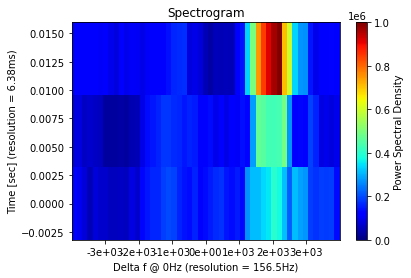

77 548.2818699308211


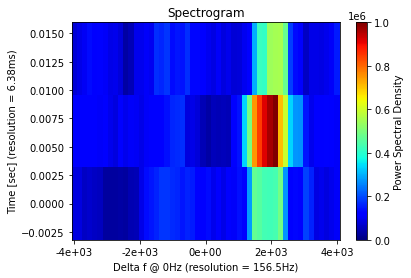

78 537.6267737210271


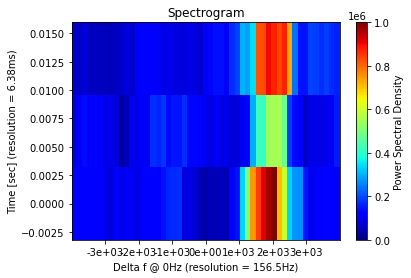

79 492.3104097154458


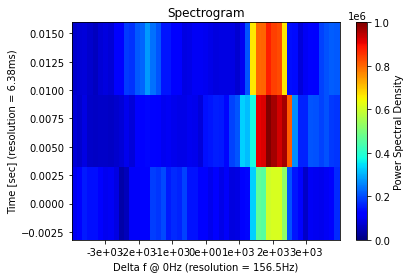

80 615.5735783895757


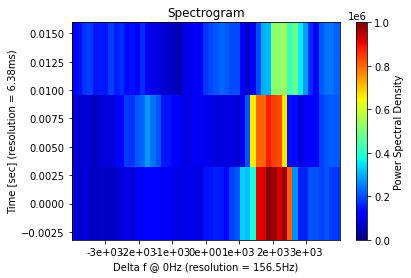

81 560.5912087708671


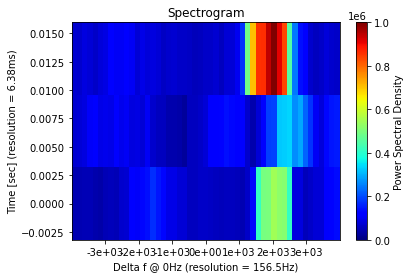

82 615.932433092984


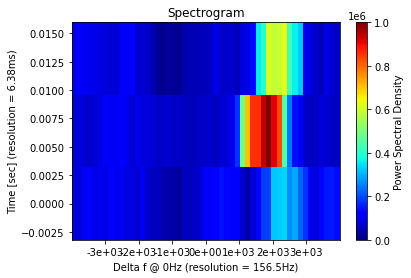

83 536.9612299629205


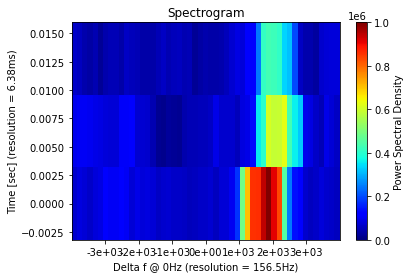

84 578.4833374835343


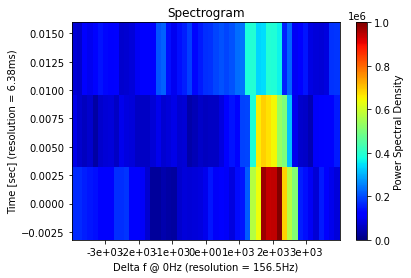

85 999.9979247537824


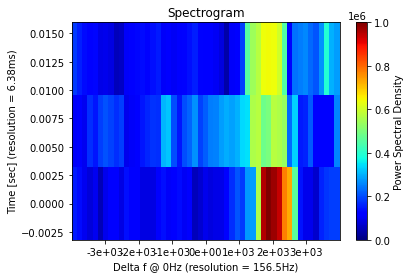

86 999.9999991137176


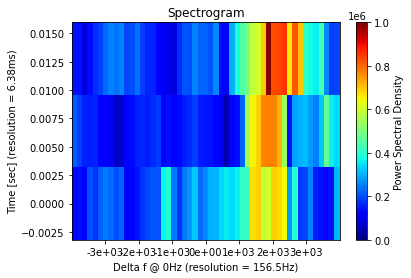

87 999.9999995093957


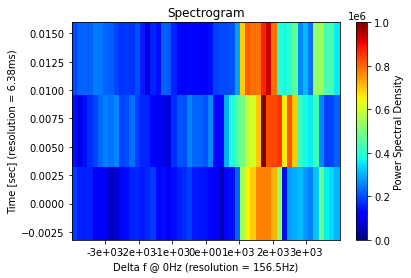

88 999.9999998534377


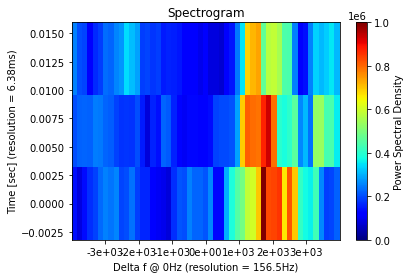

89 652.2314921009877


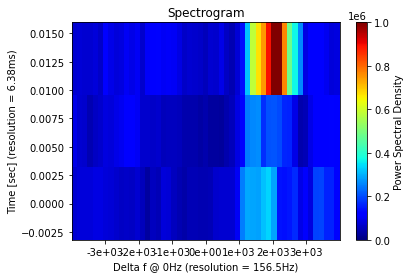

90 531.4672547550606


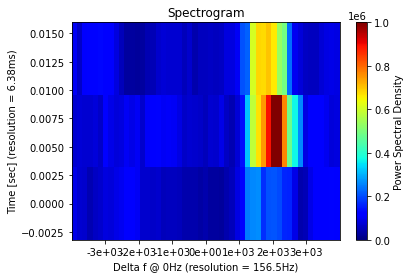

91 491.8946377487879


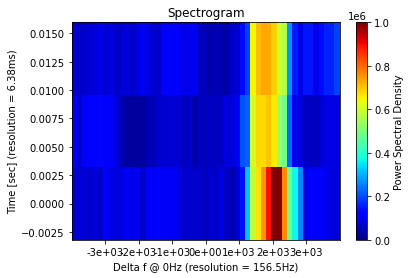

92 480.75769805441007


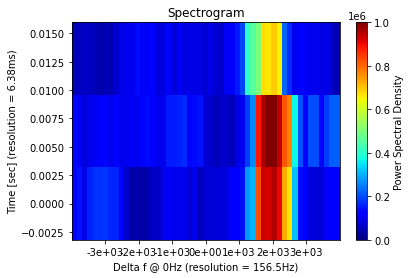

93 532.059459222887


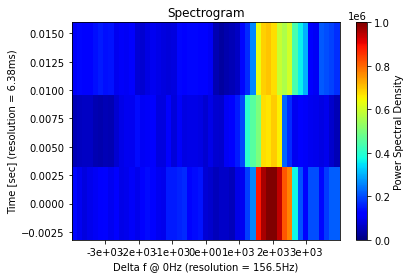

94 585.9348306184279


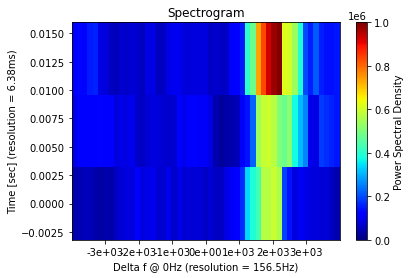

95 662.3904024705439


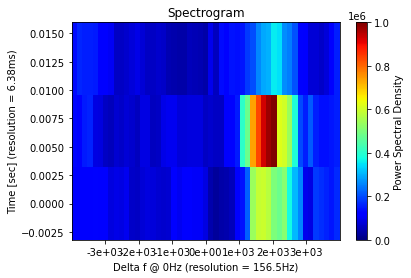

96 584.786955831178


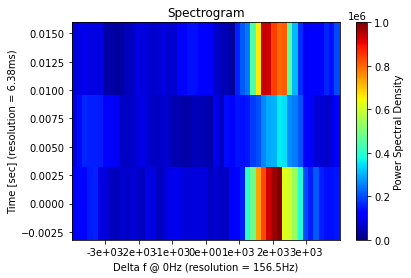

97 522.1957183698994


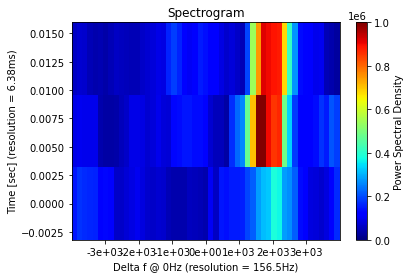

98 508.019281125611


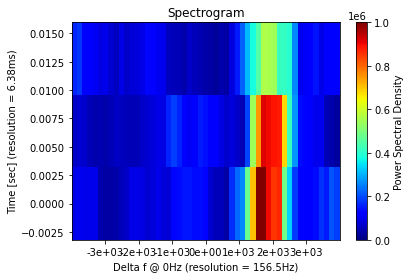

99 565.2232383917951


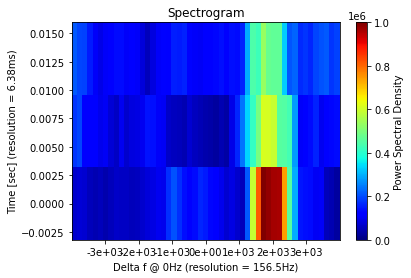

100 768.639896436835


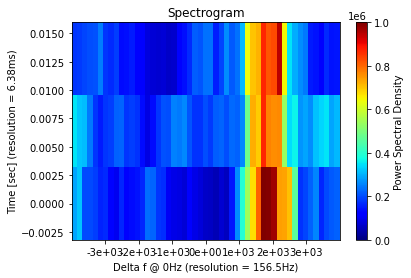

101 999.9999917656885


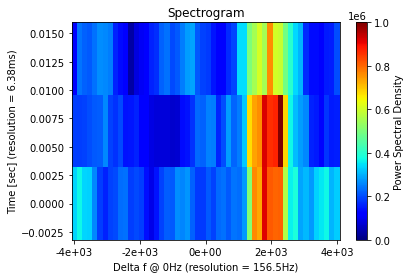

102 999.9999996810363


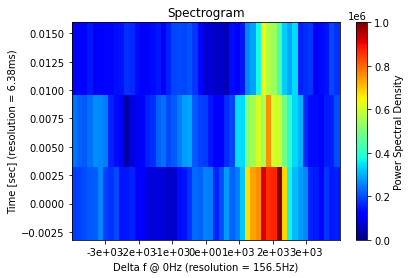

103 999.9999997591173


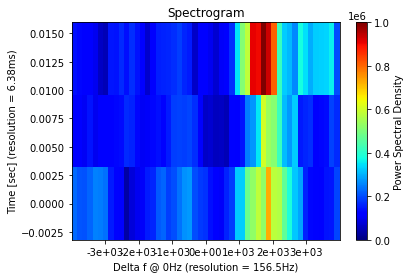

104 646.5924314318877


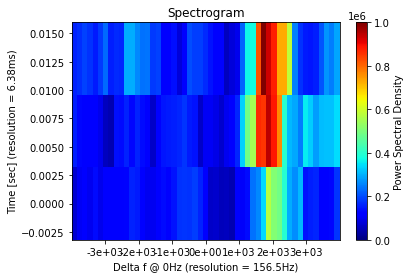

105 841.6742258581328


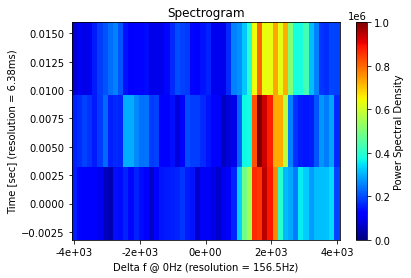

106 999.9997279471727


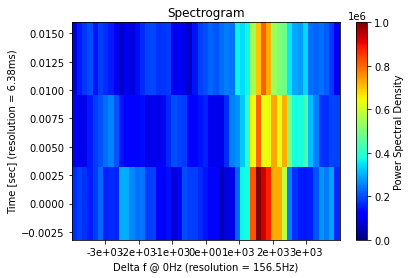

107 999.9999472361644


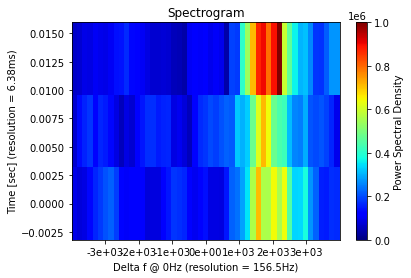

108 999.998941670285


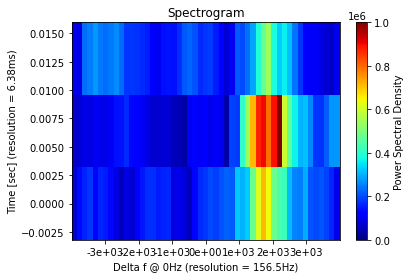

109 999.9993303707345


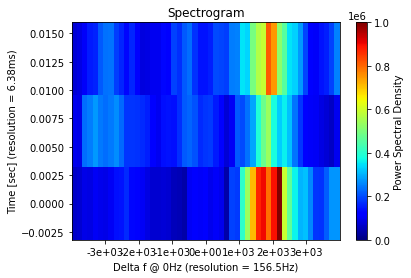

110 999.9999981614509


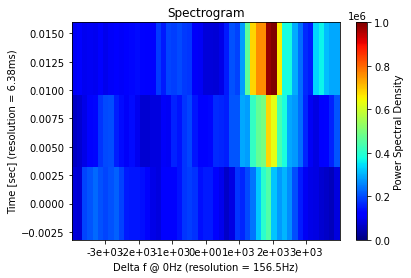

111 536.1410613152038


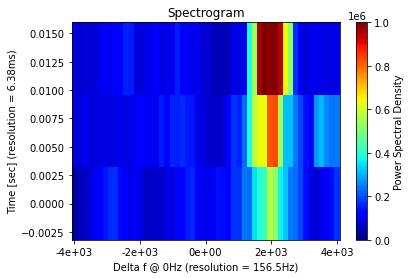

112 563.3590804432573


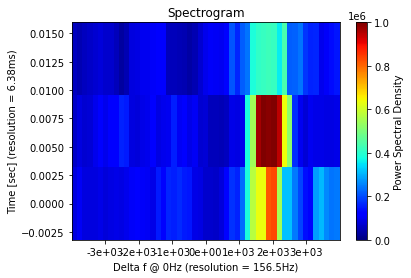

113 551.7791754603786


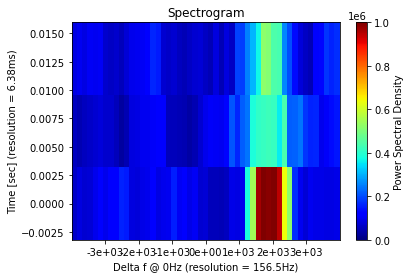

114 756.0201719480439


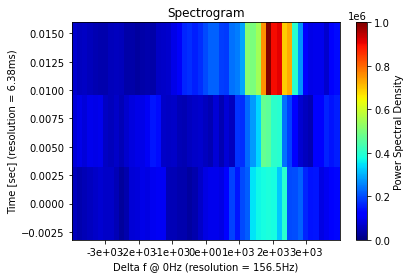

115 651.6219764599564


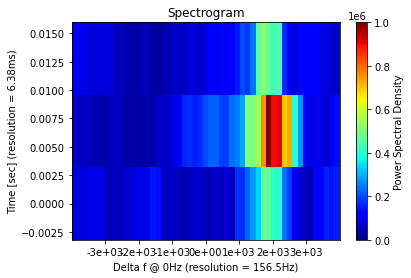

116 682.5567855997788


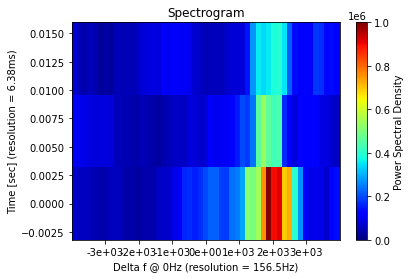

117 890.5191200151291


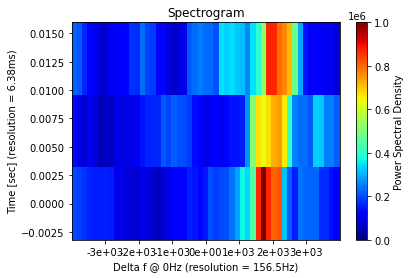

118 999.9999994368055


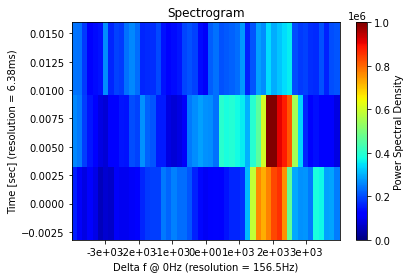

119 999.9999979296041


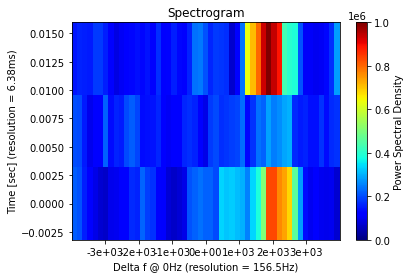

120 999.999999300777


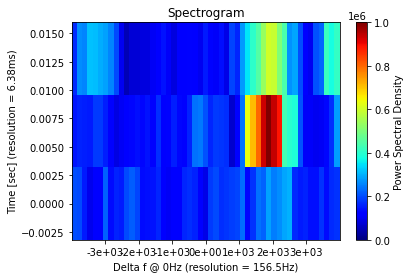

121 621.6749044863677


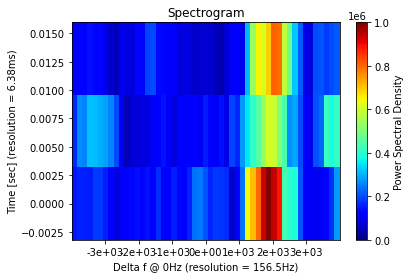

122 566.5033963331955


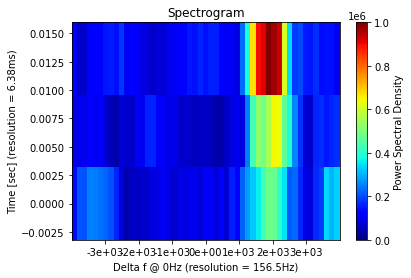

123 503.14815894365535


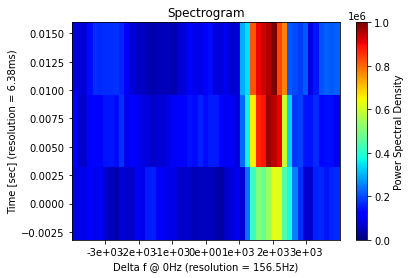

124 494.6126748791113


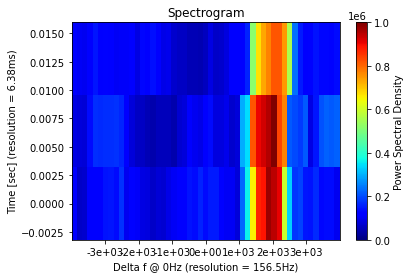

125 500.08472394780557


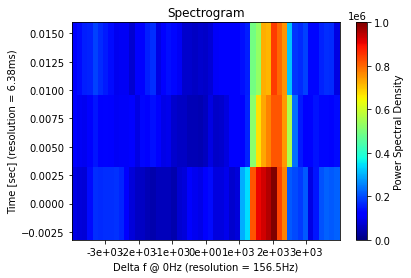

126 582.9331835595667


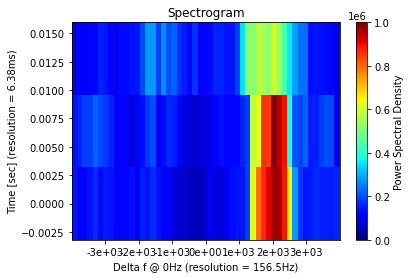

127 681.5682895761307


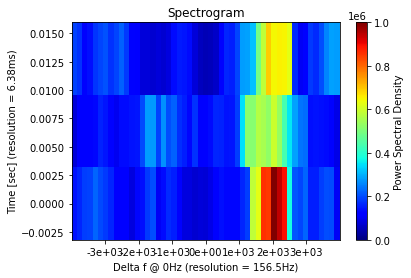

128 768.02648137236


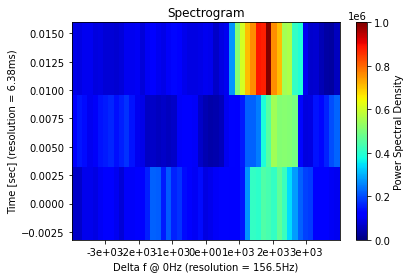

129 763.5739832042368


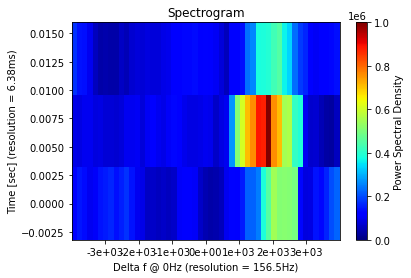

130 779.0165969393217


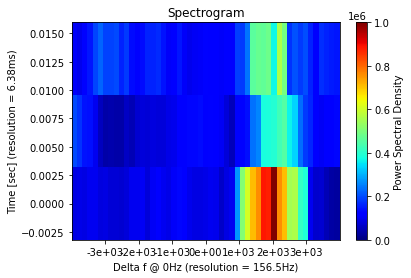

131 999.9999994767606


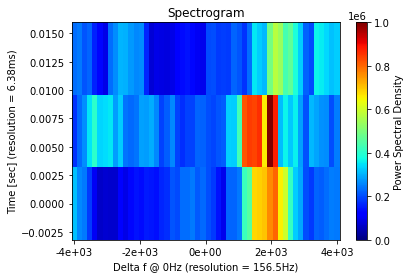

132 999.9999995338977


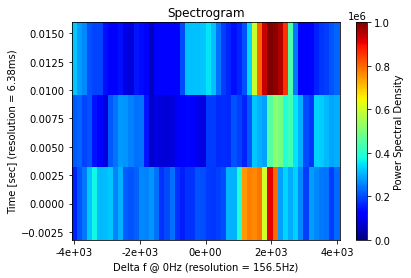

133 999.9999989772026


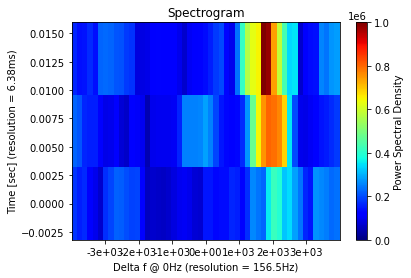

134 726.779611167449


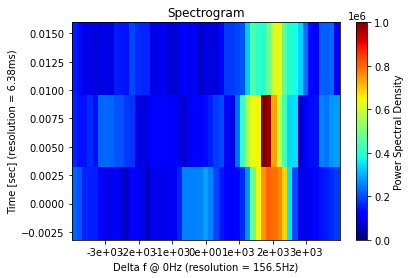

135 683.756933666786


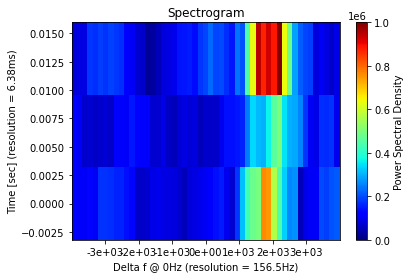

136 845.4111273063866


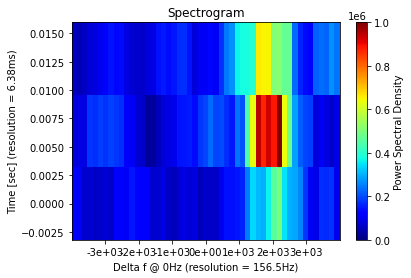

137 629.4081541662106


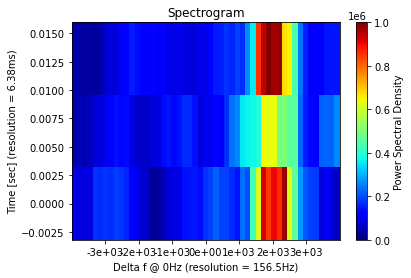

138 528.6205689963738


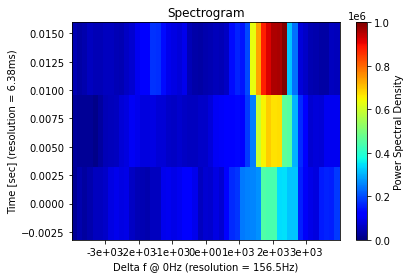

139 492.6582823853496


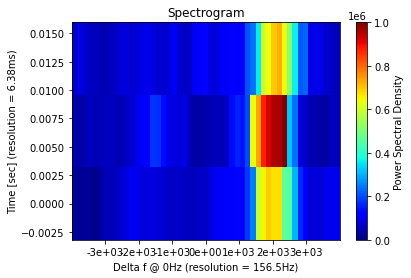

140 545.5709784338035


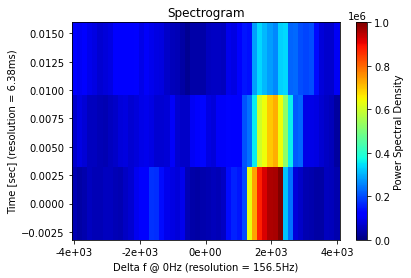

141 677.4683687780489


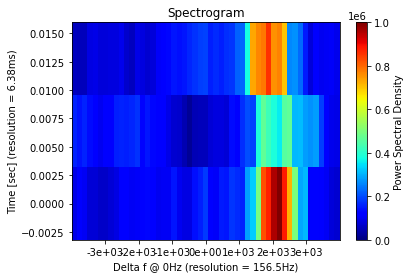

142 951.6773059856379


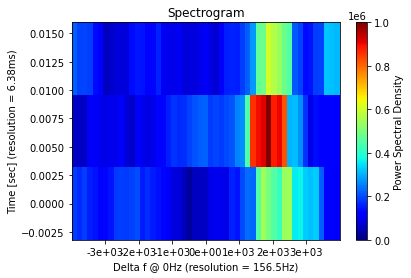

143 999.999999829373


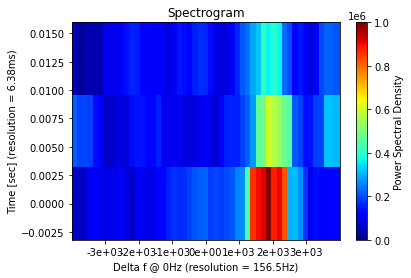

144 999.9999840558926


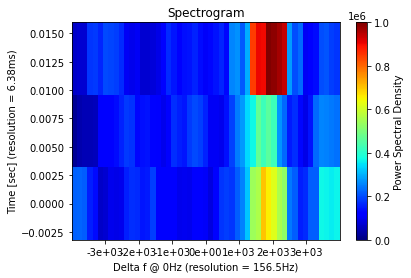

145 541.4498467814021


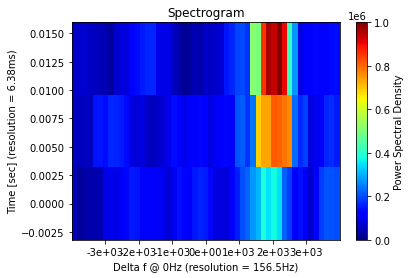

146 469.7746159216622


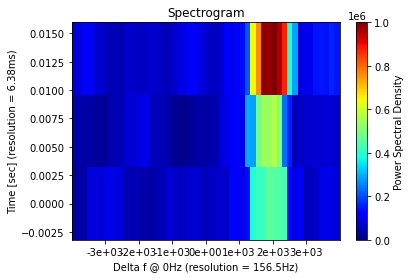

147 490.3169693163572


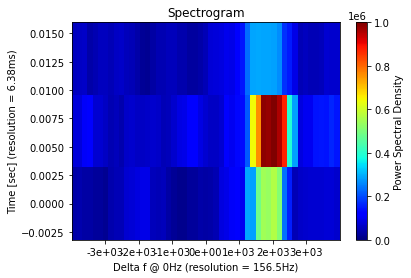

148 559.7820778701947


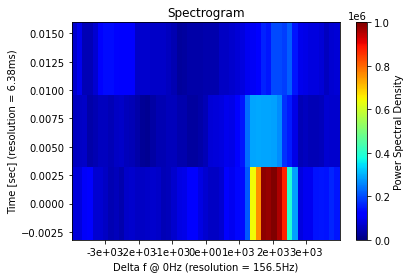

149 751.8954733437225


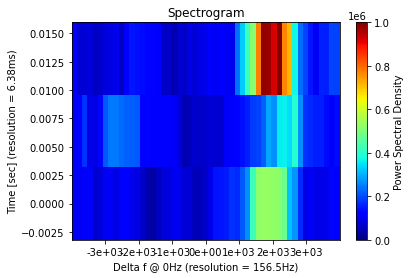

150 577.694832029973


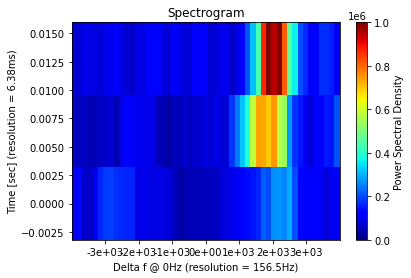

151 506.0307301221092


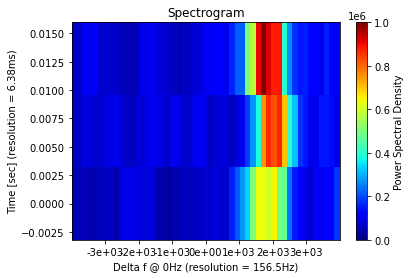

152 460.50762312052575


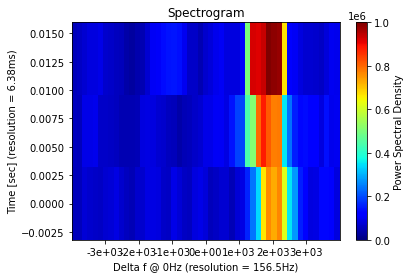

153 469.273990604843


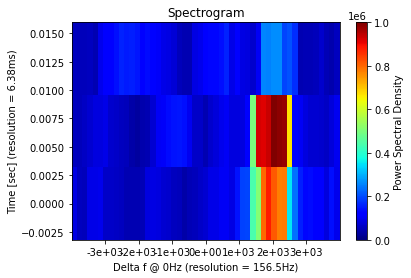

In [231]:
file='/lustre/ap/litv-exp/2021-05-00_E143_TwoPhotonDeday_ssanjari/analyzers/410MHz/E143-410MHz-2021.05.08.21.18.07.820.tiq'
f2 = '/lustre/ap/litv-exp/2021-05-00_E143_TwoPhotonDeday_ssanjari/analyzers/410MHz/E143-410MHz-2021.05.07.23.54.31.735.tiq'
f3 = '/lustre/ap/litv-exp/2021-05-00_E143_TwoPhotonDeday_ssanjari/analyzers/410MHz/E143-410MHz-2021.05.07.06.55.25.448.tiq'
f4 = '/lustre/ap/litv-exp/2021-05-00_E143_TwoPhotonDeday_ssanjari/analyzers/410MHz/E143-410MHz-2021.05.07.06.58.49.912.tiq'
area_gs1, area_iso1 = correct_spectrogram_shift_window(file, time = 1, skip = 5.042 , step= 1, every = 3, xspan = 8e3, dbm = True, lframes = 312)
area_gs2, area_iso2 = correct_spectrogram_shift_window(f2, time = 1, skip = 5.042 , step= 1, every = 3, xspan = 8e3, dbm = True, lframes = 312)
area_gs3, area_iso3 = correct_spectrogram_shift_window(f3, time = 1, skip = 5.042 , step= 1, every = 3, xspan = 8e3, dbm = True, lframes = 312)
area_gs4, area_iso4 = correct_spectrogram_shift_window(f4, time = 1, skip = 5.042 , step= 1, every = 3, xspan = 8e3, dbm = True, lframes = 312)

In [233]:
fig = px.line(y = [area_iso3], markers = True)
fig.show()

In [163]:
def decay_curve(x, a, b, c):#for the lifetime calculation
    return a + b * np.exp(-x/c)

def fit_decay(x, y, seed_a = 0, seed_b = 1, seed_c = 1, fit_report = False):
    gmodel = Model(decay_curve)
    result = gmodel.fit(y, x = x, a = seed_a, b = seed_b, c = seed_c)
    if fit_report:
        plt.plot(x, result.best_fit, '-', label = 'best fit')
        plt.plot(x,y)
        plt.legend()
        plt.show()
        print(result.fit_report())
        
    return result.params['a'].value, result.params['b'].value, result.params['c'].value


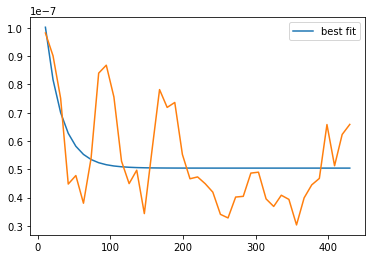

[[Model]]
    Model(decay_curve)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 128
    # data points      = 41
    # variables        = 3
    chi-square         = 8.4134e-15
    reduced chi-square = 2.2141e-16
    Akaike info crit   = -1475.02328
    Bayesian info crit = -1469.88257
[[Variables]]
    a:  5.0409e-08 +/- 2.6194e-09 (5.20%) (init = 0)
    b:  7.9426e-08 +/- 3.5002e-08 (44.07%) (init = 1e-07)
    c:  22.4858742 +/- 11.5405035 (51.32%) (init = 1)
[[Correlations]] (unreported correlations are < 0.100)
    C(b, c) = -0.830
    C(a, c) = -0.345
    C(a, b) = 0.115


In [172]:
x = np.array([i * 10.48 for i in range (1, len(area_iso) -2)])
area_iso_range = area_iso [3:]
a, b, c = fit_decay(x, area_iso_range, fit_report = True, seed_b = 1e-7)

# New plotting

In [126]:
import plotly.express as px
import pandas as pd

In [9]:
def plot_interactive_spectrogram(xx, yy, zz):
    frequency_kHz = [f'{x:0.3f}' for x in xx[0,:]/1000]
    time = [f'{y:0.3f}' for y in yy[:,0]]
    norm_power = zz / zz.max()
    
    panda_df = pd.DataFrame(data = norm_power, 
                            index = time, 
                            columns = frequency_kHz)

    fig = px.imshow(panda_df, color_continuous_scale = 'jet', origin = 'lower')
    fig.update_layout(
        #title = '2D Spectrum',
        #font_family="Avenir",
        #hoverlabel_font_family="Avenir",
        coloraxis_showscale=False,
        xaxis = dict(
            showline = True,
            mirror = "ticks",
            linewidth = 2,
            ticks = "inside",
            title_text="Frequency (kHz)",
            title_font_size = 18,
            tickfont_size = 9,
            showgrid = True,
            nticks = 10,
        ),
        yaxis = dict(
            showline = True,
            mirror = "ticks",
            linewidth = 2,
            ticks = "inside",
            title_text = "Time (s)",
            title_font_size = 18,
            tickfont_size = 9,
            showgrid = False,
            nticks = 10
        ),
        coloraxis_colorbar = dict(
            orientation = 'h',
        ),
        height = 1080,
        width = 1980
        )
    return fig

In [10]:
def plot_interactive_spectrum(x, y):
    frequency_kHz = [f'{x:0.3f}' for x in x[0, :] / 1000]
    norm_power = [p/y.max() for p in y[0, :]]
    index = [f'{p/y.max()}' for p in y]
    print(len(frequency_kHz), len(norm_power), len(index))
    panda_df = pd.DataFrame(data = norm_power,
                            index = index,
                            columns = frequency_kHz)
    print(panda_df)
    #norm_power = IQBase.get_dbm(y)
    fig = px.line(panda_df, x = frequency_kHz, title = 'Spectrum')
    return fig

In [11]:
def plot_interactive_spectrum(x, y):
    frequency_kHz = [f'{x:0.3f}' for x in x/1000]
    norm_power = [p/y.max() for p in y]
    fig = px.line(x = frequency_kHz, y = norm_power, markers = True)
    fig.update_layout(
        xaxis = dict(
            showline = True,
            mirror = "ticks",
            linewidth = 2,
            ticks = "inside",
            title_text="Frequency (kHz)",
            title_font_size = 20,
            tickfont_size = 16,
            showgrid = True,
            nticks = 12,
        ),
        yaxis = dict(
            showline = True,
            mirror = "ticks",
            linewidth = 2,
            ticks = "inside",
            title_text = "Power Spectral Density",
            title_font_size = 20,
            tickfont_size = 16,
            showgrid = True,
            nticks = 10
        )
    )
    return fig

In [121]:
file = '/lustre/ap/litv-exp/2021-05-00_E143_TwoPhotonDeday_ssanjari/analyzers/410MHz/E143-410MHz-2021.05.07.06.55.25.448.tiq'
xx, yy, zz = read_and_get_spectrogram(file, 512, 2, 5)
fig = plot_interactive_spectrogram(xx, yy, zz)
fig.show()

In [153]:
file = '/lustre/ap/litv-exp/2021-05-00_E143_TwoPhotonDeday_ssanjari/analyzers/410MHz/E143-410MHz-2021.05.07.06.55.25.448.tiq'
axx, azz = read_and_get_averaged_spectrogram(file, 512, 0.02, 5.145)
len(axx[0,:])
fig2 = plot_interactive_spectrum(axx[0,:], azz[0,:])
fig2.show()

# MOving window with new plotting

In [12]:
def correct_spectrogram_shift_window_new(filename, lframes = 612, time = 1, skip = 5.0, xcen = -2e3, xspan = 1e4, step = 1, every = 2, dbm = False):
    xx, yy, zz = read_and_get_spectrogram(filename, lframes, time, skip)
    i = 0
    while (i * step + every <= len(yy[:,0])):
        imin = i * step
        imax = i * step + every
        
        nxx = xx[imin:imax, :]
        nyy = yy[imin:imax, :]
        nzz = zz[imin:imax, :]
        
        axx, ayy, azz = get_averaged_spectrogram(nxx, nyy, nzz, every)
        xcen, sigma = fit_gaussian_peak(axx, azz)
        nxcen = abs(xcen) - 1900 #gs position - isomer position
        
        fxx, fyy, fzz = get_cut_spectrogram(nxx, nyy, nzz, xcen = nxcen, xspan = xspan)
        #plot_spectrogram(fxx, fyy, fzz)
        #plt.show()
        
        x, y, z = get_averaged_spectrogram(fxx, fyy, fzz, every)
        #plot_spectrum(x[0,:], z[0,:], dbm = True)
        #plt.show()
        plot_spectrum_spectrogram(fxx, fyy, fzz, x[0,:], z[0,:], cen = nxcen, span = xspan, dbm = dbm)
        i = i + 1
    

# track beam current

In [13]:
def read_masterfile(master_filename):
    # reads list filenames with experiment data. [:-1] to remove eol sequence.                        
    return [file[:-1] for file in open(master_filename).readlines()]

In [16]:
def track_current_gs(filename, lframes = 612, time = 9, skip = 0, nsigma = 3):
    axx, azz = read_and_get_averaged_spectrogram(filename, lframes, time, skip)
    xcen, sigma = fit_gaussian_peak(axx, azz)
    span = nsigma * 2  * sigma
    spanmask = (axx[0, :] <= xcen + span / 2) & (axx[0, :] >= xcen - span / 2)
    x = axx[0, spanmask]
    z = azz[0, spanmask]
    delta_x = abs(x[0] - x[1])
    return np.sum(z) * delta_x

In [17]:
def current_time(master_file):
    file_list = read_masterfile(master_file)
    area, years, months, days, hours, minutes, seconds = [list() for i in range(0,7)]
    for file in file_list:
        area.append(track_current_gs(file))
        time = get_tiq_time(file)
        year, month, day, hour, minute, second = strip_date(time)
        years.append(year)
        months.append(month)
        days.append(day)
        hours.append(hour)
        minutes.append(minute)
        seconds.append(second)
    data = np.stack((years, months, days, hours, minutes, seconds, area), axis = 1).reshape((len(area), 7))
    df = pd.DataFrame(data, columns=['year', 'month', 'day', 'hour', 'minute', 'second', 'area'])
    print(df)
    return df


In [18]:
def current_time2(master_file):
    file_list = read_masterfile(master_file)
    area, date = [list() for i in range(0,2)]
    for file in file_list:
        area.append(track_current_gs(file))
        date.append(get_tiq_time(file))
    data = np.stack((date, area), axis = 1).reshape((len(area), 2))
    df = pd.DataFrame(data, columns=['date', 'area'])
    print(df)
    return df


In [38]:
df2 = current_time2('/lustre/astrum/david/git/ashortiso/ashortiso/410_05.07.06.txt')

                                  date                    area
0    2021-05-07T05:54:28.4724732+02:00   4.336795136059017e-06
1    2021-05-07T05:54:40.5265506+02:00   4.741052299680091e-06
2    2021-05-07T05:54:52.5579669+02:00   4.837391797748525e-06
3    2021-05-07T05:55:04.5886050+02:00  1.0379844548546274e-06
4    2021-05-07T05:55:16.6163861+02:00  1.1193818985336657e-06
..                                 ...                     ...
294  2021-05-07T06:53:23.2772706+02:00   8.537948887097349e-07
295  2021-05-07T06:53:35.3050517+02:00  1.1186467499015038e-06
296  2021-05-07T06:53:47.3310716+02:00   1.047654600170281e-06
297  2021-05-07T06:53:59.3571016+02:00   8.357753959923801e-07
298  2021-05-07T06:54:11.3851388+02:00   4.859036728069393e-06

[299 rows x 2 columns]


In [51]:
df1 = df2.sort_values("date").reset_index(drop=True)
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 299 entries, 0 to 298
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   date    299 non-null    object
 1   area    299 non-null    object
dtypes: object(2)
memory usage: 4.8+ KB


In [55]:
cols = df2.columns.drop('date')
df2[cols] = df2[cols].apply(pd.to_numeric)
fig2 = px.line(df2, x = 'date', y='area',markers=True)
fig.update_layout(autotypenumbers='convert types')
fig2.show()

In [57]:
df3 = current_time2('/lustre/astrum/david/git/ashortiso/ashortiso/iso.txt')
cols = df3.columns.drop('date')
df3[cols] = df3[cols].apply(pd.to_numeric)
fig3 = px.line(df3, x = 'date', y='area',markers=True)
fig3.show()

                                  date                    area
0    2021-05-08T21:12:03.7590165+02:00  1.1762816603347658e-05
1    2021-05-08T21:12:18.2993352+02:00  1.2304652808639185e-05
2    2021-05-08T21:12:32.8462229+02:00  1.1656237611746691e-05
3    2021-05-08T21:12:47.3890709+02:00    9.86229595624738e-06
4    2021-05-08T21:13:01.9333781+02:00  1.0972324717799054e-05
..                                 ...                     ...
669  2021-05-07T23:53:31.6212988+02:00   7.976593353367193e-07
670  2021-05-07T23:53:43.6561148+02:00    8.62259768635668e-07
671  2021-05-07T23:53:55.6926664+02:00   8.369400332014409e-07
672  2021-05-07T23:54:07.7314965+02:00  1.0160270115239195e-06
673  2021-05-07T23:54:20.8892770+02:00   9.326172779644466e-07

[674 rows x 2 columns]


In [27]:
df = current_time('/lustre/astrum/david/git/ashortiso/ashortiso/410_05.07.06.txt')

     year month day hour minute second                    area
0    2021    05  07   05     54     28   4.336795136059017e-06
1    2021    05  07   05     54     40   4.741052299680091e-06
2    2021    05  07   05     54     52   4.837391797748525e-06
3    2021    05  07   05     55     04  1.0379844548546274e-06
4    2021    05  07   05     55     16  1.1193818985336657e-06
..    ...   ...  ..  ...    ...    ...                     ...
294  2021    05  07   06     53     23   8.537948887097349e-07
295  2021    05  07   06     53     35  1.1186467499015038e-06
296  2021    05  07   06     53     47   1.047654600170281e-06
297  2021    05  07   06     53     59   8.357753959923801e-07
298  2021    05  07   06     54     11   4.859036728069393e-06

[299 rows x 7 columns]


In [32]:
fig = px.line(df, x = 'second', y='area', color='minute', markers=True)
fig.show()

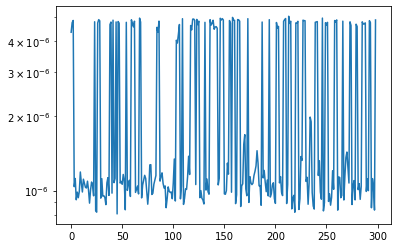

In [180]:
plt.plot(area)
plt.yscale('log')
plt.show()

In [182]:
fig = px.line(x = [i for i in range(len(area))],y=area, markers=True)
fig.show()

In [15]:
file = '/lustre/ap/litv-exp/2021-05-00_E143_TwoPhotonDeday_ssanjari/analyzers/410MHz/E143-410MHz-2021.05.07.06.55.25.448.tiq'
time = get_tiq_time(file)
time

'2021-05-07T06:49:46.7822383+02:00'

In [24]:
def strip_date(time):
    year = time[:4]
    month = time[5:7]
    day = time[8:10]
    hour = time[11:13]
    minute = time[14:16]
    second = time[17:19]
    return year, month, day, hour, minute, second

In [20]:
second

'46'

# 72Bromine

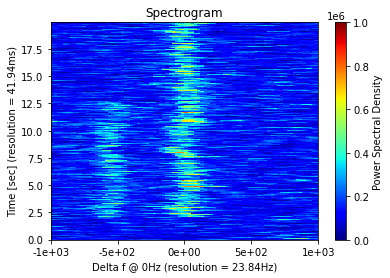

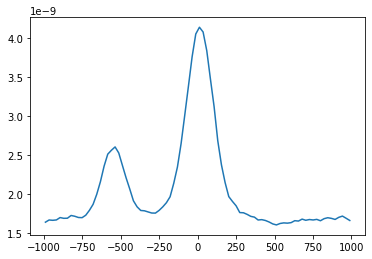

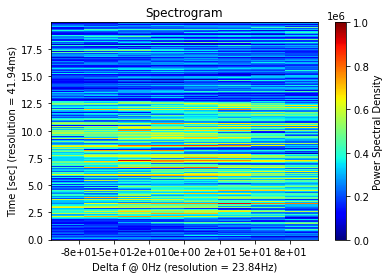

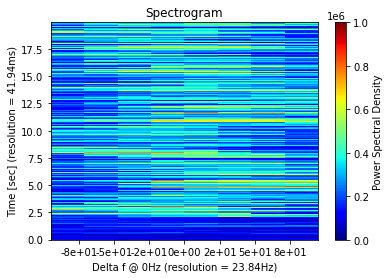

In [435]:
file_Br = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/410/410MHz-2021.07.02.17.58.30.204.tiq'
xx, yy, zz = read_and_cut_in_frecuency(file_Br, 2048, 20, 0, 650, 2e3)
plot_spectrogram(xx, yy, zz)
plt.show()
axx, ayy, azz = get_averaged_spectrogram(xx, yy, zz, len(xx[:,0]))
plt.plot(axx[0,:], azz[0,:])
plt.show()

xxx, yyy, zzz = get_cut_spectrogram(xx, yy, zz, xcen = -5.5e2, xspan = 2e2, ycen = 10 , yspan = 20)
plot_spectrogram(xxx, yyy, zzz)
plt.show()
xxxg, yyyg, zzzg = get_cut_spectrogram(xx, yy, zz, xcen = 0, xspan = 2e2, ycen = 10 , yspan = 20)
plot_spectrogram(xxxg, yyyg, zzzg)
plt.show()
averaged_power_frame_iso = [np.average(zzz[i, :]) for i in range(len(zzz[:,0]))]
averaged_power_frame_g = [np.average(zzzg[i, :]) for i in range(len(zzzg[:,0]))]
total = [x + y for x, y in zip(averaged_power_frame_g, averaged_power_frame_iso)]
fig = px.line(y = [averaged_power_frame_g, averaged_power_frame_iso], markers = True)
#fig.write_html('/u/litv-exp/personal_directories/dfreiref/72Br/spectrum_isoVSgsVStotal2.html')
fig.show()

In [361]:
averaged_power_frame_g_range1 = np.average(zzzg[:47, :])
averaged_power_frame_g_range2 = np.average(zzzg[47:302, :])
averaged_power_frame_g_range3 = np.average(zzzg[302:-1, :])

averaged_power_frame_iso_range1 = np.average(zzz[:47, :])
averaged_power_frame_iso_range2 = np.average(zzz[47:302, :])
averaged_power_frame_iso_range3 = np.average(zzz[302:-1, :])

In [362]:
iso_ave_1, iso_ave_2, iso_ave_3, g_ave_1, g_ave_2, g_ave_3= [list() for i in range(6)]
for i in range(len(zzzg[:47, :])):
    iso_ave_1.append(averaged_power_frame_iso_range1)
    g_ave_1.append(averaged_power_frame_g_range1)
for i in range(len(zzzg[47:302, :])):
    iso_ave_2.append(averaged_power_frame_iso_range2)
    g_ave_2.append(averaged_power_frame_g_range2)
for i in range(len(zzzg[302:-1, :])):
    iso_ave_3.append(averaged_power_frame_iso_range3)
    g_ave_3.append(averaged_power_frame_g_range3)
    
total_iso = iso_ave_1 + iso_ave_2 + iso_ave_3
total_g = g_ave_1 + g_ave_2 + g_ave_3

In [364]:
fig = px.line(y = [total_g, total_iso], markers = False)
fig.show()
background = (1.66e-9 + 1.56e-9) / 2
step_ion = 3.24e-9 - 2.57e-9
ions_in_iso = (2.57e-9 - background) / step_ion


In [18]:
xx, yy, zz = read_and_cut_in_frecuency(file_Br, 2048, 14, 1, 350, 2e3)
fig = plot_interactive_spectrogram(xx, yy, zz)
#fig.write_image('/u/litv-exp/personal_directories/dfreiref/72Br/Cutted_Spectrogram.pdf')
fig.show()

In [103]:
axx, azz = read_and_get_averaged_spectrogram(file_Br, 2048, 10, 2)
fig2 = plot_interactive_spectrum(axx[0,:], azz[0,:])
#fig2.write_html('/u/litv-exp/personal_directories/dfreiref/72Br/spectrum.html')
#fig2.show()
#Over 1000 lframes, doesnt display correctly here

In [22]:
xx, yy, zz = read_and_cut_in_frecuency(file_Br, 2048, 14, 1, 350, 2e3)
axx, _, azz = get_averaged_spectrogram(xx, yy, zz, len(xx[:,0]))
fig3 = plot_interactive_spectrum(axx[0,:], azz[0,:])
#fig3.write_image('/u/litv-exp/personal_directories/dfreiref/72Br/Cutted_Spectrum.pdf')
fig3.show()

next files

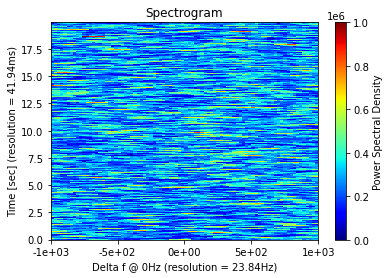

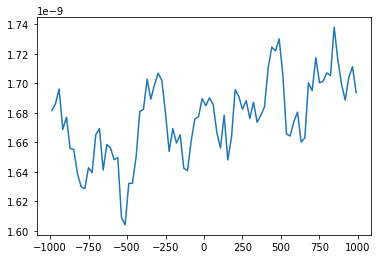

In [397]:
f3 = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/410/410MHz-2021.07.02.17.57.49.005.tiq'
xx, yy, zz = read_and_cut_in_frecuency(f3, 2048, 20, 0, 650, 2e3)
plot_spectrogram(xx, yy, zz)
plt.show()
axx, ayy, azz = get_averaged_spectrogram(xx, yy, zz, len(xx[:,0]))
plt.plot(axx[0,:], azz[0,:])
plt.show()

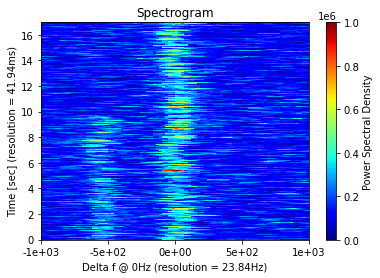

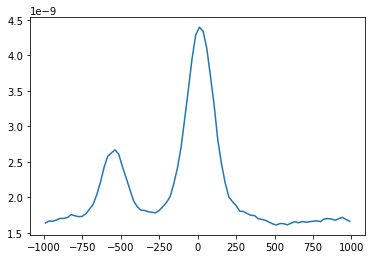

In [16]:
file_Br = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/410/410MHz-2021.07.02.17.58.30.204.tiq'
xx1, yy1, zz1 = read_and_cut_in_frecuency(file_Br, 2048, 17, 3, 650, 2e3)
plot_spectrogram(xx1, yy1, zz1)
plt.show()
axx, ayy, azz = get_averaged_spectrogram(xx1, yy1, zz1, len(xx1[:,0]))
plt.plot(axx[0,:], azz[0,:])
plt.show()

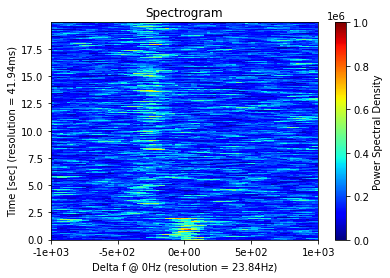

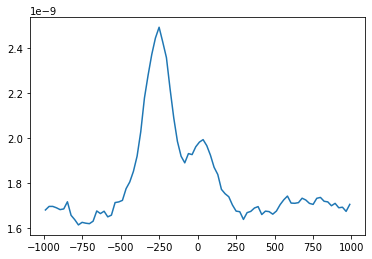

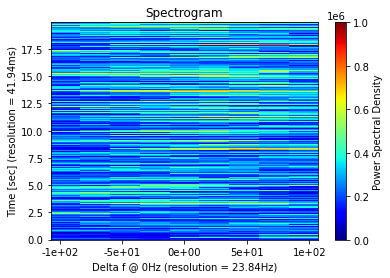

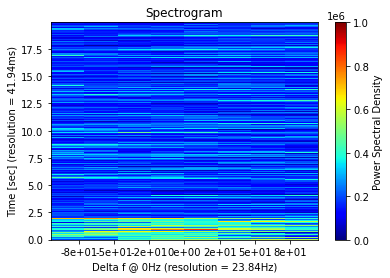

In [449]:
f = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/410/410MHz-2021.07.02.17.59.10.991.tiq'
xx2, yy2, zz2 = read_and_cut_in_frecuency(f, 2048, 20, 0, 650, 2e3)
plot_spectrogram(xx2, yy2, zz2)
plt.show()
axx, ayy, azz = get_averaged_spectrogram(xx2, yy2, zz2, len(xx[:,0]))
plt.plot(axx[0,:], azz[0,:])
plt.show()

xxx, yyy, zzz = get_cut_spectrogram(xx2, yy2, zz2, xcen = -2.7e2, xspan = 2e2, ycen = 10 , yspan = 20)
plot_spectrogram(xxx, yyy, zzz)
plt.show()
xxxg, yyyg, zzzg = get_cut_spectrogram(xx2, yy2, zz2, xcen = 20, xspan = 2e2, ycen = 10 , yspan = 20)
plot_spectrogram(xxxg, yyyg, zzzg)
plt.show()

averaged_power_frame_iso = [np.average(zzz[i, :]) for i in range(len(zzz[:,0]))]
averaged_power_frame_g = [np.average(zzzg[i, :]) for i in range(len(zzzg[:,0]))]
#total = [x + y for x, y in zip(averaged_power_frame_g, averaged_power_frame_iso)]
fig = px.line(y = [averaged_power_frame_iso, averaged_power_frame_g], markers = True)
#fig.write_html('/u/litv-exp/personal_directories/dfreiref/72Br/spectrum_isoVSgsVStotal2.html')
fig.show()

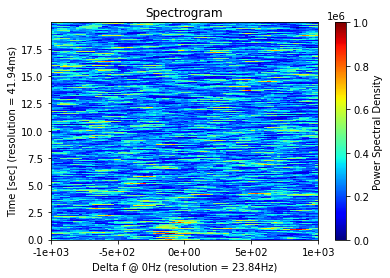

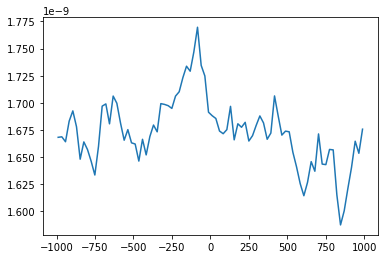

In [450]:
f2 = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/410/410MHz-2021.07.02.17.59.51.767.tiq'
xx3, yy3, zz3 = read_and_cut_in_frecuency(f2, 2048, 20, 0, 650, 2e3)
plot_spectrogram(xx3, yy3, zz3)
plt.show()
axx, ayy, azz = get_averaged_spectrogram(xx3, yy3, zz3, len(xx3[:,0]))
plt.plot(axx[0,:], azz[0,:])
plt.show()

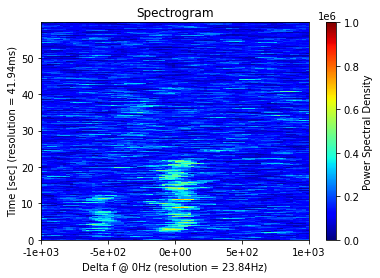

In [456]:
cx, cy, cz = get_concat_spectrogram(xx1, yy1, zz1, xx2, yy2, zz2)
cx2, cy2, cz2 = get_concat_spectrogram(cx, cy, cz, xx3, yy3, zz3)
cx3, cy3, cz3 = get_concat_spectrogram(xx2, yy2, zz2, xx3, yy3, zz3)
plot_spectrogram(cx2, cy2, cz2)
plt.show()

 ## Area

0 599.9999999784926


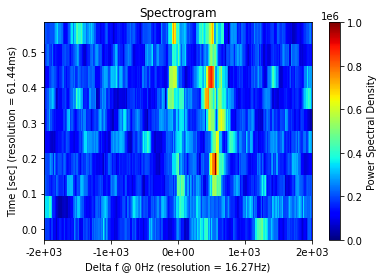

1 599.9999999473789


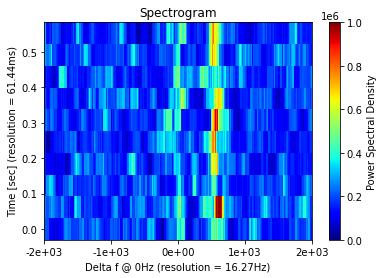

2 599.9999988179342


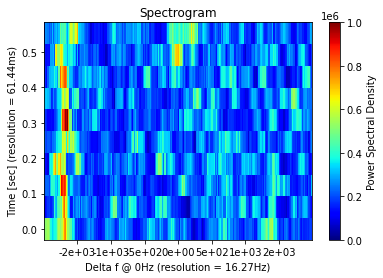

3 599.9999998712041


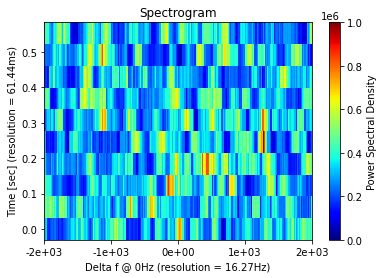

In [286]:
file_Br = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/410/410MHz-2021.07.02.17.58.30.204.tiq'
area_gs, area_iso = correct_spectrogram_shift_window(file_Br, time = 3, skip = 2 , 
                                                     step = 10, every = 10, xcen = 650, xspan = 4e3, lframes = 3000,
                                                     seed_amp = 5e-09, seed_cen = 0, seed_wid = 5e2, delta_f = 400)

# 245

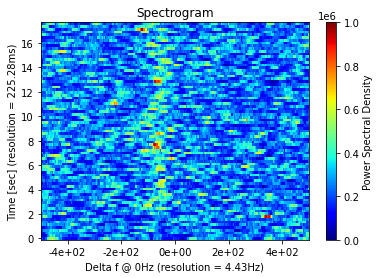

In [94]:
file_br245 = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/245/245MHz-2021.07.02.17.58.56.521.tiq'
#file_br245 = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/245/245MHz-2021.07.02.16.45.09.182.tiq'
xx, yy, zz = read_and_cut_in_frecuency(file_br245, 5500, 18, 0, 350, 1e3)
plot_spectrogram(xx, yy, zz)

In [93]:
file_br245 = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/245/245MHz-2021.07.02.17.58.56.521.tiq'
xx, yy, zz = read_and_cut_in_frecuency(file_br245, 5500, 18, 0, 350, 1e3)
fig = plot_interactive_spectrogram(xx, yy, zz)
#fig.write_image('/u/litv-exp/personal_directories/dfreiref/72Br/Cutted_Spectrogram.pdf')
fig.show()

In [129]:
file_br245 = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/analyzers/245/245MHz-2021.07.02.17.58.56.521.tiq'
xx, yy, zz = read_and_get_spectrogram(file_br245, 4096, 3, 1)
axx, ayy, azz = get_averaged_spectrogram(xx, yy, zz, 2)
fig = plot_interactive_spectrogram(axx, ayy, azz)
#fig.write_image('/u/litv-exp/personal_directories/dfreiref/72Br/Cutted_Spectrogram.pdf')
fig.show()

ValueError: cannot reshape array of size 69632 into shape (8,2,4096)

In [92]:
xx, yy, zz = read_and_cut_in_frecuency(file_br245, 5500, 2.2, 9.8, 350, 1e3)
axx, _, azz = get_averaged_spectrogram(xx, yy, zz, len(xx[:,0]))
fig4 = plot_interactive_spectrum(axx[0,:], azz[0,:])
#fig4.write_image('/u/litv-exp/personal_directories/dfreiref/72Br/Cutted_Spectrum.pdf')
fig4.show()

In [60]:
xx, yy, zz = read_and_cut_in_frecuency(file_br245, 4096, 2.9, 2.3, 350, 2e3)
axx, _, azz = get_averaged_spectrogram(xx, yy, zz, len(xx[:,0]))
fig5 = plot_interactive_spectrum(axx[0,:], azz[0,:])
#fig5.write_image('/u/litv-exp/personal_directories/dfreiref/72Br/Cutted_Spectrum.pdf')
fig5.show()

## NTCAP 

In [412]:
file_ntcap = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/ntcap/iq/IQ_2021-06-30_23-27-34_part3/0002849.iq.tdms'
lframes = 2**18
xx, yy, zz = ntcap_read_and_cut_in_frecuency(file_ntcap, lframes, 10, 10.681, 350, 1e3)
plot_spectrogram(xx, yy, zz)
plt.show()
#fig.write_image('/u/litv-exp/personal_directories/dfreiref/72Br/Cutted_Spectrogram.pdf')
#fig.show()

NameError: name 'ntcap_read_and_cut_in_frecuency' is not defined

In [22]:
def ntcap_read_and_cut_in_frecuency(filename, lframes, time, skip, xcen, xspan):    
    iq = get_iq_object(filename)
    print('iq got')
    iq.read_samples(1)
    #iq.read_complete_file()                                                                                                                                                                                       
    nframes = int(time * iq.fs / lframes)
    sframes = int(skip * iq.fs / lframes)
    iq.read(nframes = nframes, lframes = lframes, sframes = sframes)
    print('read completed')
    xx, yy, zz = iq.get_spectrogram(nframes = nframes, lframes = lframes)
    print('got')
    nxx, nyy, nzz = get_cut_spectrogram(xx, yy, zz, xcen = xcen, xspan = xspan)
    print('cutted')
    import gc
    del(xx)
    del(yy)
    del(zz)
    gc.collect()
    print('deleted')
    return nxx, nyy, nzz 

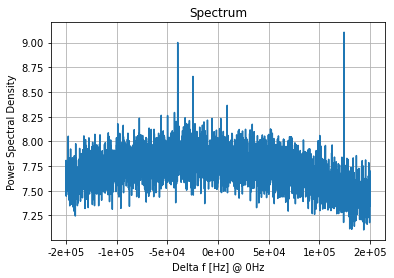

In [130]:
#file_ntcap = '/lustre/ap/litv-exp/2021-07-03_E143_TwoPhotonDecay_ssanjari/ntcap/iq/IQ_2021-06-30_23-27-34_part3/0002849.iq.tdms'
#lframes = 2**18
#xx, yy, zz = ntcap_read_and_cut_in_frecuency(file_ntcap, lframes, 10, 10.681, 0, 2e6)
nxx, nyy, nzz = get_averaged_spectrogram(xx, yy, zz, len(xx[:,0]))
plot_spectrum(nxx[0, :], nzz[0, :])
plt.show()
#fig.write_image('/u/litv-exp/personal_directories/dfreiref/72Br/Cutted_Spectrogram.pdf')
#fig.show()

In [365]:
1/np.sqrt(0.18)

2.3570226039551585

In [366]:
229/89

2.5730337078651684

In [367]:
85/33

2.5757575757575757

In [368]:
alpha = 0.18
gammat = 1/np.sqrt(alpha)
gammat

2.3570226039551585

In [371]:
from barion.particle import *
from barion.amedata import *
from barion.ring import *

In [384]:
th = Particle(90, 139, AMEData(), Ring('ESR', 108.4))
th.qq = 89
th.get_ionic_moq_in_u()

AME Database files are available.


2.572849169063459

In [382]:
Ge = Particle(32, 40, AMEData(), Ring('ESR', 108.43))
Ge.get_ionic_moq_in_u()

AME Database files are available.


2.2470182028797723

In [383]:
u = Particle(92, 137, AMEData(), Ring('ESR', 108.4))
u.qq = 90
u.get_ionic_moq_in_u()

AME Database files are available.


2.544274120334293

In [385]:
2.572849169063459 - 2.544274120334293

0.028575048729166053

In [460]:
ref_ion = '72Ge+35'
for i, char in enumerate(ref_ion):
    if char == '+': aux = i
ref_charge = int(ref_ion[aux:])
ref_charge

35